<a href="https://colab.research.google.com/github/kartik-kumarr/HumanPose/blob/main/mmWaveRADAR.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Downloading the data

In [ ]:
# !wget -O dataset.zip 'https://zenodo.org/record/12611978/files/P1.zip?download=1'

--2025-08-29 04:01:33--  https://zenodo.org/record/12611978/files/P1.zip?download=1
Resolving zenodo.org (zenodo.org)... 188.185.43.25, 188.185.48.194, 188.185.45.92, ...
Connecting to zenodo.org (zenodo.org)|188.185.43.25|:443... connected.
HTTP request sent, awaiting response... 301 MOVED PERMANENTLY
Location: /records/12611978/files/P1.zip [following]
--2025-08-29 04:01:34--  https://zenodo.org/records/12611978/files/P1.zip
Reusing existing connection to zenodo.org:443.
HTTP request sent, awaiting response... 200 OK
Length: 24808906821 (23G) [application/octet-stream]
Saving to: ‘dataset.zip’

dataset.zip         100%[===================>]  23.10G  22.4MB/s    in 15m 42s 

2025-08-29 04:17:15 (25.1 MB/s) - ‘dataset.zip’ saved [24808906821/24808906821]



In [ ]:
# ## Verifying if the dataset is being downloaded
# !ls -lh /content/

total 24G
-rw-r--r-- 1 root root  24G Aug 29 04:17 dataset.zip
drwxr-xr-x 1 root root 4.0K Aug 27 18:27 sample_data


In [ ]:
# !unzip /content/dataset.zip -d /content/dataset/

Streaming output truncated to the last 5000 lines.
  inflating: /content/dataset/d4s1/003/00775_radar.npz  
  inflating: /content/dataset/d4s1/003/00712_bbox.npz  
  inflating: /content/dataset/d4s1/003/00465_bbox.npz  
  inflating: /content/dataset/d4s1/003/00644_radar.npz  
  inflating: /content/dataset/d4s1/003/00145_radar.npz  
  inflating: /content/dataset/d4s1/003/00061_bbox.npz  
  inflating: /content/dataset/d4s1/003/00687_radar.npz  
  inflating: /content/dataset/d4s1/003/00396_bbox.npz  
  inflating: /content/dataset/d4s1/003/00241_pose.npz  
  inflating: /content/dataset/d4s1/003/00743_mask.npz  
  inflating: /content/dataset/d4s1/003/00508_radar.npz  
  inflating: /content/dataset/d4s1/003/00836_radar.npz  
  inflating: /content/dataset/d4s1/003/00098_bbox.npz  
  inflating: /content/dataset/d4s1/003/00090_pose.npz  
  inflating: /content/dataset/d4s1/003/00729_pose.npz  
  inflating: /content/dataset/d4s1/003/00033_pose.npz  
  inflating: /content/dataset/d4s1/003/00196_ma

# 1 Loading required libraries

In [ ]:
import numpy as np
import os
import pandas as pd
import cv2

# 2 Loading Dataset

In [ ]:
# root = sessionID+'/alignment/'
# root = '/data/datasets/mmvr_release_candidate_v6_downsampling/d9s3/007/'
# root = os.path.expanduser('~/Downloads/Datasets/P1/d1s1/000/')
# index = root + '00060'


root = os.path.expanduser('/content/dataset/')
dirNames = []



# Traverse the directory
for dirpath, dirnames, filenames in os.walk(root):
    dirNames = dirnames
    break
    # for filename in filenames:
    #     full_path = os.path.join(dirpath, filename)
    #     print(dirpath)
    #     all_files.append(full_path)

dirNames.remove('figs')
dirNames.remove('d3s1')
dirNames.remove('d4s1')
# dirNames.remove('d1s2')
dirNames.remove('d3s2')
dirNames.remove('d2s2')
dirNames.remove('d1s1')
print(dirNames)

['d1s2']


2.1 Connected joints in Keypoints

In [ ]:
# for plot
import matplotlib.pyplot as plt
import matplotlib.patches as patches
# joints connections for 2d keypoints
connections = np.array([[13, 15], [11, 13], [14, 16], [12, 14], [11, 12],
                [5, 11], [6, 12], [5, 6], [5, 7], [6, 8], [7, 9],
                [8, 10], [1, 2], [0, 1], [0, 2], [1, 3], [2, 4],
                [3, 5], [4, 6]])

## Joint Angle Calculations

In [ ]:
jointDict = {
    0: "Nose",
    1: "Left Eye",
    2: "Right Eye",
    3: "Left Ear",
    4: "Right Ear",
    5: "Left Shoulder",
    6: "Right Shoulder",
    7: "Left Elbow",
    8: "Right Elbow",
    9: "Left Wrist",
    10: "Right Wrist",
    11: "Left Hip",
    12: "Right Hip",
    13: "Left Knee",
    14: "Right Knee",
    15: "Left Ankle",
    16: "Right Ankle"
}


revJointDict = {v:k for k,v in jointDict.items()}


## making a vertex mid and corresponding vertex for making angle calculation easier

######################## Shoulder ####################################
shoulderRight = ["Right Elbow","Right Shoulder","Right Hip"]
shoulderLeft = ["Left Elbow","Left Shoulder","Left Hip"]


####################### Elbow ##################################################
elbowRight = ["Right Wrist", "Right Elbow", "Right Shoulder"]
elbowLeft = ["Left Wrist", "Left Elbow", "Left Shoulder"]


####################### Hip ###################################################]
hipRight = ["Right Shoulder", "Right hip", "Right knee"]
hipLeft = ["Left Shoulder", "Left hip", "Left knee"]


############################## knee ###########################################
kneeRight = ["Right Ankle", "Right knee", "Right hip"]
kneeLeft = ["Left Ankle", "Left knee", "Left hip"]


angleTriplets = {
    "Right Shoulder": ["Right Elbow", "Right Shoulder", "Right Hip"],
    "Left Shoulder": ["Left Elbow", "Left Shoulder", "Left Hip"],
    "Right Elbow": ["Right Wrist", "Right Elbow", "Right Shoulder"],
    "Left Elbow": ["Left Wrist", "Left Elbow", "Left Shoulder"],
    "Right Hip": ["Right Shoulder", "Right Hip", "Right Knee"],
    "Left Hip": ["Left Shoulder", "Left Hip", "Left Knee"],
    "Right Knee": ["Right Ankle", "Right Knee", "Right Hip"],
    "Left Knee": ["Left Ankle", "Left Knee", "Left Hip"]
}

# angleTriplets.update({
#     "Neck": ["Nose", "Left Shoulder", "Right Shoulder"],
#     "Torso Left": ["Left Shoulder", "Left Hip", "Left Knee"],
#     "Torso Right": ["Right Shoulder", "Right Hip", "Right Knee"],
#     "Right Leg": ["Right Hip", "Right Knee", "Right Ankle"],
#     "Left Leg": ["Left Hip", "Left Knee", "Left Ankle"],
#     "Right Arm": ["Right Shoulder", "Right Elbow", "Right Wrist"],
#     "Left Arm": ["Left Shoulder", "Left Elbow", "Left Wrist"]
# })



In [ ]:
print(len(angleTriplets))

8


In [ ]:
def calculateAngle(a, b, c):
    """
    Calculate the angle formed by three points (a, b, c)
    where b is the mid connecting vertex (e.g., the knee).
    """

    # Extract coordinates from the Normalized Landmark objects
    a_coords = np.array(a)
    b_coords = np.array(b)
    c_coords = np.array(c)

    # Create vectors AB and BC
    vector_ab = a_coords - b_coords
    vector_bc = c_coords - b_coords

    # Compute the dot product
    dot = np.dot(vector_ab, vector_bc)

    # Compute the magnitudes of the vectors
    norm_ab = np.linalg.norm(vector_ab)
    norm_bc = np.linalg.norm(vector_bc)

    if norm_ab == 0 or norm_bc == 0:
        return np.nan

    # Calculate the angle in radians and then convert to degrees
    cos_angle = np.clip(dot / (norm_ab * norm_bc), -1.0, 1.0)
    theta = np.arccos(cos_angle)
    angle = np.degrees(theta)

    return angle

2.2 Loading Dataset into DataFrame

In [ ]:
import numpy as np
import pandas as pd

def getDATA(index):
    ## Loading meta data
    with np.load(index + '_meta.npz', mmap_mode='r') as meta_data:
        pass

    ## Loading radar data from npz files
    with np.load(index + '_radar.npz', mmap_mode='r') as radar_data:
        hori = radar_data['hm_hori']  # (256, 128)
        vert = radar_data['hm_vert']  # (256, 128)

    ## Loading bounding box data from npz files
    with np.load(index + '_bbox.npz', mmap_mode='r') as bbox_data:
        bbox_i = bbox_data['bbox_i']
        bbox_hori = bbox_data['bbox_hori']
        bbox_vert = bbox_data['bbox_vert']

    ## Loading pose data from npz files  from npz files
    with np.load(index + '_pose.npz', mmap_mode='r') as pose_data:
        kp = pose_data['kp']  # (n, 17, 3)

    ## Loading segmentation mask data from npz files
    with np.load(index + '_mask.npz', mmap_mode='r') as mask_data:
        mask = mask_data['mask']

    return hori, vert, bbox_hori, bbox_vert, bbox_i, kp, mask


2.3 Loading the P1 folders data only(Traning as well as testing)

In [ ]:
import os
import pandas as pd

def process_folder(root, folderName):
    folder_path = os.path.join(root, folderName)
    print(folder_path)

    # Get the immediate subdirectories (timeSteps)
    currDirNames = next(os.walk(folder_path))[1]  # Faster than looping

    # Process each timeStep
    for timeStep in currDirNames:
        filePath = os.path.join(folder_path, timeStep)
        print("#################################")
        print(f"Processing timeStep: {timeStep}")

        # Initialize list to store row data
        data_rows = []

        # Get file count in timeStep directory
        lengthFiles = len(next(os.walk(filePath))[2])  # Avoid extra loops

        # Process files in chunks
        startDir = "00000"
        for index in range((lengthFiles // 5) - 1):
            index_path = os.path.join(filePath, startDir)
            hori, vert, bbox_hori, bbox_vert, bbox_i, kp, mask = getDATA(index_path)

            # Append the extracted data to the list
            data_rows.append({
                'timeStep': f"{timeStep}_{startDir}",
                'hori': hori,
                'vert': vert,
                'bbox_hori': bbox_hori,
                'bbox_vert': bbox_vert,
                'bbox_i': bbox_i,
                'kp': kp,
                'mask': mask
            })

            ## Incrementing the timeStepDir name
            startDir = f"{int(startDir) + 1:05d}"

        ## Yield a DataFrame for each batch
        if data_rows:
            yield pd.DataFrame(data_rows)

## function to process folders and store data in DF
def main(root, dirNames):
    data_frames = []  # Store DataFrames in a list

    for folderName in dirNames:
        for temp_df in process_folder(root, folderName):
            data_frames.append(temp_df)  ## Collecting temp DFs

    ## Concatenate all DataFrames at once
    return pd.concat(data_frames, ignore_index=True) if data_frames else pd.DataFrame()

df = main(root, dirNames)

/content/dataset/d1s2
#################################
Processing timeStep: 014
#################################
Processing timeStep: 008
#################################
Processing timeStep: 001
#################################
Processing timeStep: 018
#################################
Processing timeStep: 002
#################################
Processing timeStep: 004
#################################
Processing timeStep: 013
#################################
Processing timeStep: 017
#################################
Processing timeStep: 005
#################################
Processing timeStep: 003
#################################
Processing timeStep: 006
#################################
Processing timeStep: 019
#################################
Processing timeStep: 007
#################################
Processing timeStep: 016
#################################
Processing timeStep: 010
#################################
Processing timeStep: 015
#################################


In [ ]:
df.shape

(17598, 8)

## compute Angle function

In [ ]:
def computeAngle(connect, j, kp):
    idx = jointDict[connect]
    num = [revJointDict[k] for k in angleTriplets[idx]]
    a = np.array([kp[j, num[0], 0], kp[j, num[0], 1], kp[j, num[0], 2]])
    b = np.array([kp[j, num[1], 0], kp[j, num[1], 1], kp[j, num[1], 2]])
    c = np.array([kp[j, num[2], 0], kp[j, num[2], 1], kp[j, num[2], 2]])
    return (idx, calculateAngle(a, b, c))


[[[287.89062    205.07812      0.85004246]
  [288.82812    204.14062      0.85168886]
  [284.60938    203.67188      0.84766895]
  [291.64062    204.60938      0.40484858]
  [280.39062    203.67188      0.878499  ]
  [295.85938    220.07812      0.8927025 ]
  [270.07812    219.14062      0.8823049 ]
  [299.60938    241.17188      0.87351286]
  [265.39062    237.89062      0.888629  ]
  [303.35938    260.39062      0.8415146 ]
  [262.57812    253.82812      0.84995234]
  [292.10938    260.85938      0.86285055]
  [276.17188    260.85938      0.8323026 ]
  [291.17188    291.32812      0.8311511 ]
  [273.35938    289.92188      0.78308046]
  [288.35938    319.92188      0.8694828 ]
  [276.17188    306.32812      0.78596383]]]


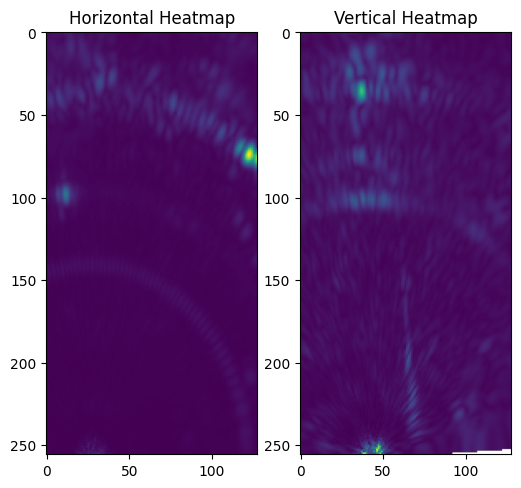

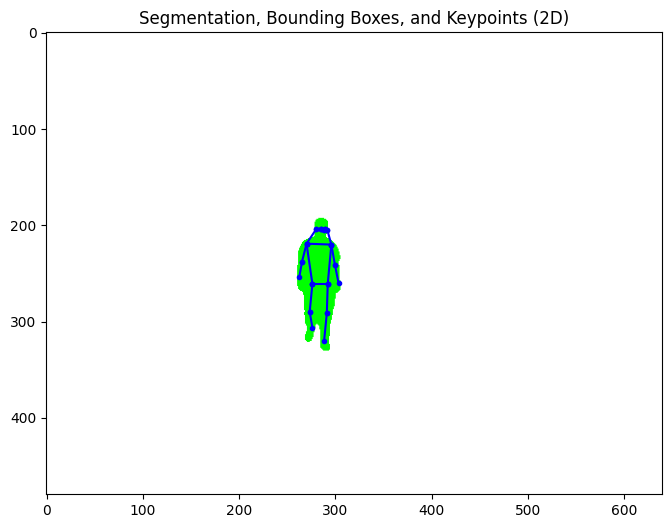

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as patches
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.patches import Ellipse

def plot_heatmaps_and_annotations(hori, vert, mask, bbox_i, kp, connections):
    # Plot horizontal and vertical heatmaps side by side
    fig = plt.figure(figsize=(6, 6))

    ax = fig.add_subplot(1, 2, 1)
    ax.imshow(hori)
    ax.set_title('Horizontal Heatmap')

    ax = fig.add_subplot(1, 2, 2)
    ax.imshow(vert)
    ax.set_title('Vertical Heatmap')

    plt.show()

    # Plot segmentation, bounding boxes, and keypoints
    fig = plt.figure(figsize=(10, 6))
    ax = fig.add_subplot(1, 1, 1)

    # Create an empty image to overlay the masks
    img = np.ones((480, 640, 3), dtype=np.uint8) * 255

    # print(mask.shape)


    for j in range(mask.shape[0]):
        ## converting the mask data from boolean to int
        # tempMask = mask[j, :, :].astype(np.uint8)
        # ## resizing the mask to 240*320 dimensions
        # tempMask = cv2.resize(tempMask, (128, 256), interpolation = cv2.INTER_NEAREST)

        # tempMask = np.expand_dims(tempMask, axis=0)

        # Apply segmentation mask (green)
        img[mask[j, :, :]==1] = (0, 255, 0)

        # # Scaling factors
        # scaleX = 128 / mask.shape[2]
        # scaleY = 256 / mask.shape[1]


        # Draw bounding boxes (red)
        x1, y1, x2, y2 = bbox_i[j, :4]
        width = x2 - x1
        height = y2 - y1
        rect = patches.Rectangle((int(x1), int(y1)), width, height, linewidth=1, edgecolor='r', facecolor='none')
        # ax.add_patch(rect)
        # Plot keypoints (red Gaussian circles)
        for connection in connections:
          for idx in connection:
            x = float(kp[j, idx, 0])
            y = float(kp[j, idx, 1])
            z = float(kp[j, idx, 2])
            # ellipse = Ellipse((x, y), width=20, height=20, edgecolor='blue', facecolor='red', alpha=0.5)
            # ax.add_patch(ellipse)
          x = kp[j, connection, 0]
          y = kp[j, connection, 1]
        #     z = kp[j, connection, 2]
          ax.plot(x, y, color='b', marker='.')




        # # # # Plot keypoints (blue)
        # for connection in connections:
        #     x = kp[j, connection, 0]
        #     y = kp[j, connection, 1]
        #     z = kp[j, connection, 2]

        #     # if jointDict[connection[0]] in angleTriplets:
        #     #   print(computeAngle(connection[0], j, kp))
        #     ellipse = Ellipse((x, y), width=0.1, height=0.1, edgecolor='red', facecolor='red', alpha=0.3)
        #     ax.add_patch(ellipse)
        #     # ax.plot(x, y, z, color='b', marker='.',  linestyle='None')

    ax.imshow(img)
    ax.set_title('Segmentation, Bounding Boxes, and Keypoints (2D)')
    plt.show()

##
timeStep, hori, vert, bbox_hori, bbox_vert, bbox_i, kp, mask = df.iloc[3, :]
print(kp)
plot_heatmaps_and_annotations(hori, vert, mask, bbox_i, kp, connections)

In [ ]:
df.iloc[0, :]


,0
timeStep,014_00000
hori,"[[26394040.0, 32517770.0, 35426804.0, 36119796..."
vert,"[[10600210.0, 10567882.0, 11083537.0, 11202599..."
bbox_hori,"[[3.5, 78.5, 17.0, 108.5]]"
bbox_vert,"[[25.5, 78.5, 69.0, 108.5]]"
bbox_i,"[[259.0, 197.0, 298.0, 328.0, 0.9761685]]"
kp,"[[[284.14062, 208.35938, 0.8841429], [285.0781..."
mask,"[[[False, False, False, False, False, False, F..."


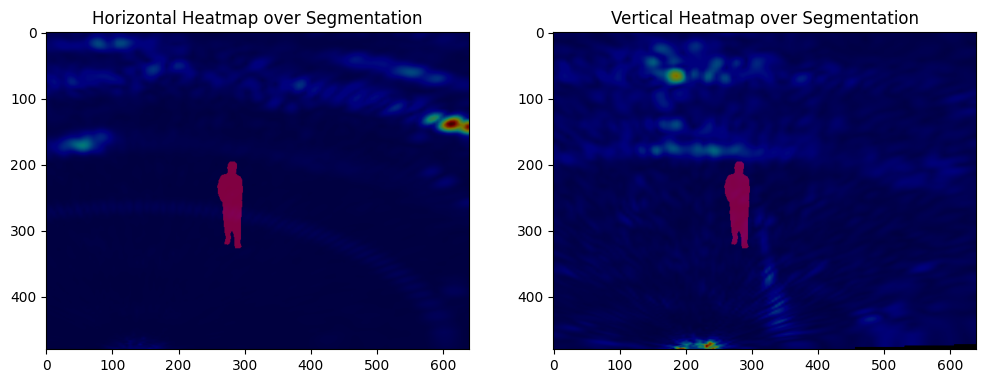

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import cv2  # For resizing

def plot_heatmaps_with_mask(hori, vert, mask, bbox_i, kp, connections):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    scale_x = 640 / 128  # Width scale
    scale_y = 480 / 256  # Height scale
    hori_resized = cv2.resize(hori, (640, 480), interpolation=cv2.INTER_LINEAR)
    vert_resized = cv2.resize(vert, (640, 480), interpolation=cv2.INTER_LINEAR)

    # # Normalize heatmaps for better visualization
    # hori_resized = (hori_resized - np.min(hori_resized)) / (np.max(hori_resized) - np.min(hori_resized))
    # vert_resized = (vert_resized - np.min(vert_resized)) / (np.max(vert_resized) - np.min(vert_resized))

    # Create an RGB mask visualization
    mask_vis = np.zeros((mask.shape[1], mask.shape[2], 3), dtype=np.uint8)
    mask_vis[mask[0] == 1] = (255, 0, 0)  # Apply red for segmentation mask

    # Overlay horizontal heatmap
    axes[0].imshow(mask_vis)  # Show segmentation mask
    axes[0].imshow(hori_resized, cmap='jet', alpha=0.5)  # Overlay heatmap with transparency
    axes[0].set_title("Horizontal Heatmap over Segmentation")

    # Overlay vertical heatmap
    axes[1].imshow(mask_vis)
    axes[1].imshow(vert_resized, cmap='jet', alpha=0.5)
    axes[1].set_title("Vertical Heatmap over Segmentation")

    plt.show()

# Example usage:
timeStep, hori, vert, bbox_hori, bbox_vert, bbox_i, kp, mask = df.iloc[0, :]
plot_heatmaps_with_mask(hori, vert, mask, bbox_i, kp, connections)


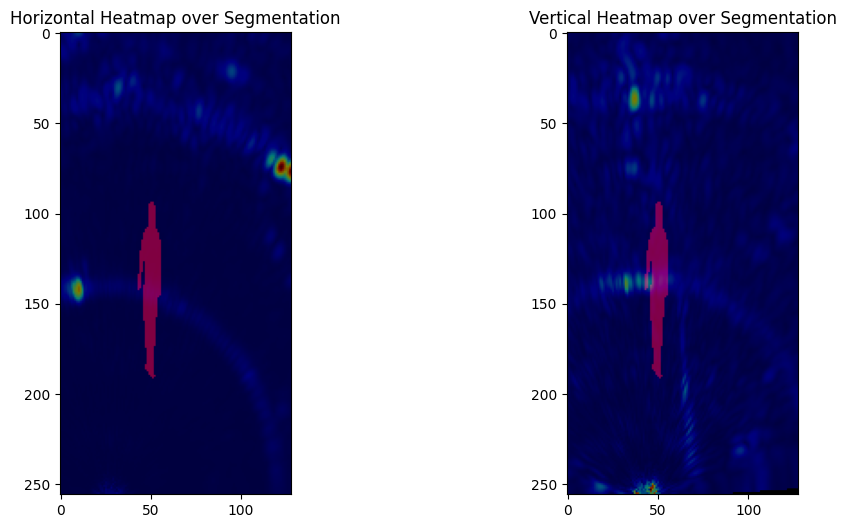

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import cv2  # For resizing

def plot_heatmaps_with_mask(hori, vert, mask, bbox_i, kp, connections):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Resize the mask to match the heatmap dimensions (256, 128)
    mask_resized = cv2.resize(mask[0].astype(np.uint8), (128, 256), interpolation=cv2.INTER_NEAREST)

    # Create an RGB mask visualization
    mask_vis = np.zeros((256, 128, 3), dtype=np.uint8)
    mask_vis[mask_resized == 1] = (255, 0, 0)  # Apply red for segmentation mask

    # Overlay horizontal heatmap
    axes[0].imshow(mask_vis)  # Show segmentation mask
    axes[0].imshow(hori, cmap='jet', alpha=0.5)  # Overlay heatmap with transparency
    axes[0].set_title("Horizontal Heatmap over Segmentation")

    # Overlay vertical heatmap
    axes[1].imshow(mask_vis)
    axes[1].imshow(vert, cmap='jet', alpha=0.5)
    axes[1].set_title("Vertical Heatmap over Segmentation")

    plt.show()

# Example usage:
timeStep, hori, vert, bbox_hori, bbox_vert, bbox_i, kp, mask = df.iloc[10, :]
plot_heatmaps_with_mask(hori, vert, mask, bbox_i, kp, connections)

In [ ]:
# x1, y1, x2, y2 = bbox_i[0, :4]
# width = x2 - x1
# height = y2 - y1


# print(f"width:{width}, height:{height}")

## Getting ju8mping action

In [ ]:
import os
import pandas as pd

def process_folder(root, folderName):
    folder_path = os.path.join(root, folderName)
    print(folder_path)

    # Get the immediate subdirectories (timeSteps)
    currDirNames = next(os.walk(folder_path))[1]  # Faster than looping

    # Process each timeStep
    for timeStep in currDirNames:
        filePath = os.path.join(folder_path, timeStep)
        print("#################################")
        print(f"Processing timeStep: {timeStep}")

        # Initialize list to store row data
        data_rows = []

        # Get file count in timeStep directory
        lengthFiles = len(next(os.walk(filePath))[2])  # Avoid extra loops

        # Process files in chunks
        startDir = "00000"
        for index in range((lengthFiles // 5) - 1):
            index_path = os.path.join(filePath, startDir)
            hori, vert, bbox_hori, bbox_vert, bbox_i, kp, mask = getDATA(index_path)

            # Append the extracted data to the list
            data_rows.append({
                'timeStep': f"{timeStep}_{startDir}",
                'hori': hori,
                'vert': vert,
                'bbox_hori': bbox_hori,
                'bbox_vert': bbox_vert,
                'bbox_i': bbox_i,
                'kp': kp,
                'mask': mask
            })

            ## Incrementing the timeStepDir name
            startDir = f"{int(startDir) + 1:05d}"

        ## Yield a DataFrame for each batch
        if data_rows:
            yield pd.DataFrame(data_rows)

## function to process folders and store data in DF
def main(root, dirNames):
    data_frames = []  # Store DataFrames in a list

    for folderName in dirNames:
        for temp_df in process_folder(root, folderName):
            data_frames.append(temp_df)  ## Collecting temp DFs

    ## Concatenate all DataFrames at once
    return pd.concat(data_frames, ignore_index=True) if data_frames else pd.DataFrame()

df_jumping = main(root, ['d3s1'])

/content/dataset/d3s1
#################################
Processing timeStep: 010
#################################
Processing timeStep: 005
#################################
Processing timeStep: 002
#################################
Processing timeStep: 007
#################################
Processing timeStep: 006
#################################
Processing timeStep: 013
#################################
Processing timeStep: 012
#################################
Processing timeStep: 009
#################################
Processing timeStep: 008
#################################
Processing timeStep: 011
#################################
Processing timeStep: 000
#################################
Processing timeStep: 018
#################################
Processing timeStep: 015
#################################
Processing timeStep: 001
#################################
Processing timeStep: 014
#################################
Processing timeStep: 017
#################################


In [ ]:
import numpy as np
import cv2
import pandas as pd
from skimage.transform import resize
import gc  # Garbage collector for memory management

# Define the functions (same as your provided code)
def checKNans(heatmap):
    y, x = np.where(np.isnan(heatmap))
    return list(zip(x, y))

def flipHeatmaps(orig, toBeFilled, Nanidx):
    toBeFilled_filled = toBeFilled.copy()
    for x, y in Nanidx:
        toBeFilled_filled[y, x] = orig[y, x]
    return toBeFilled_filled

def fillWithNeigh(heatmap):
    mask = np.isnan(heatmap).astype(np.uint8) * 255
    heatmap32 = np.nan_to_num(heatmap, nan=0).astype(np.float32)  # Use float32 to save memory
    heatmapFilled = cv2.inpaint(heatmap32, mask, inpaintRadius=3, flags=cv2.INPAINT_TELEA)
    return heatmapFilled

def flipAndFill(horizontal, vertical):
    NanMaskHori = checKNans(horizontal)
    NanMaskVert = checKNans(vertical)
    if len(NanMaskVert) > 0 and len(NanMaskHori) == 0:
        vertical = flipHeatmaps(horizontal, vertical, NanMaskVert)
        return horizontal, vertical
    elif len(NanMaskVert) == 0 and len(NanMaskHori) > 0:
        horizontal = flipHeatmaps(vertical, horizontal, NanMaskHori)
        return horizontal, vertical
    elif len(NanMaskVert) > 0 and len(NanMaskHori) > 0:
        filledHori = fillWithNeigh(horizontal)
        filledVert = fillWithNeigh(vertical)
        return filledHori, filledVert
    else:
        return horizontal, vertical

## This function normalizes the heatmaps
def normalizeHeatmaps(heatmap):
    return cv2.normalize(heatmap, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)

# Add new columns for filled heatmaps
df_jumping['filled_hori'] = None
df_jumping['filled_vert'] = None
df_jumping['mask_resized'] = None

# Counters for NaN values
cNanVert = 0
cNanHori = 0

halfidx = len(df_jumping) // 2
dfHalf = df_jumping.iloc[:halfidx].copy()

# Loop through each row in the DataFrame
for idx, row in df_jumping.iterrows():
    hori = row['hori']
    vert = row['vert']
    mask = row['mask']

    # Print starting pixel of NaN values in both heatmaps
    nan_hori = checKNans(hori)
    nan_vert = checKNans(vert)
    if nan_hori:
        cNanHori += 1
    if nan_vert:
        cNanVert += 1

    ## Fill NaNs in the heatmaps
    filled_hori, filled_vert = flipAndFill(hori, vert)

    ## Normalizing the heatmaps
    filled_hori = normalizeHeatmaps(filled_hori)
    filled_vert = normalizeHeatmaps(filled_vert)

    # filled_hori = resize(filled_hori, (16, 16), order=3, preserve_range=True, anti_aliasing=True)
    # filled_vert = resize(filled_vert, (16, 16), order=3, preserve_range=True, anti_aliasing=False)

    # ## Resizing the masks after normalising
    # mask_resized = resize(mask[0], (16, 16), order=0, preserve_range=True, anti_aliasing=False)

    ## Storing the heatmaps in the new columns
    df_jumping.at[idx, 'filled_hori'] = filled_hori
    df_jumping.at[idx, 'filled_vert'] = filled_vert
    # df_jumping.at[idx, 'mask_resized'] = mask_resized

    # ## deleting the varibaeles
    # del hori, vert, mask, filled_hori, filled_vert, mask_resized
    # gc.collect()


## Preprocessing heatmaps(walking)

In [ ]:
import numpy as np
import cv2
import pandas as pd
from skimage.transform import resize
import gc  # Garbage collector for memory management

# Define the functions (same as your provided code)
def checKNans(heatmap):
    y, x = np.where(np.isnan(heatmap))
    return list(zip(x, y))

def flipHeatmaps(orig, toBeFilled, Nanidx):
    toBeFilled_filled = toBeFilled.copy()
    for x, y in Nanidx:
        toBeFilled_filled[y, x] = orig[y, x]
    return toBeFilled_filled

def fillWithNeigh(heatmap):
    mask = np.isnan(heatmap).astype(np.uint8) * 255
    heatmap32 = np.nan_to_num(heatmap, nan=0).astype(np.float32)  # Use float32 to save memory
    heatmapFilled = cv2.inpaint(heatmap32, mask, inpaintRadius=3, flags=cv2.INPAINT_TELEA)
    return heatmapFilled

def flipAndFill(horizontal, vertical):
    NanMaskHori = checKNans(horizontal)
    NanMaskVert = checKNans(vertical)
    if len(NanMaskVert) > 0 and len(NanMaskHori) == 0:
        vertical = flipHeatmaps(horizontal, vertical, NanMaskVert)
        return horizontal, vertical
    elif len(NanMaskVert) == 0 and len(NanMaskHori) > 0:
        horizontal = flipHeatmaps(vertical, horizontal, NanMaskHori)
        return horizontal, vertical
    elif len(NanMaskVert) > 0 and len(NanMaskHori) > 0:
        filledHori = fillWithNeigh(horizontal)
        filledVert = fillWithNeigh(vertical)
        return filledHori, filledVert
    else:
        return horizontal, vertical

## This function normalizes the heatmaps
def normalizeHeatmaps(heatmap):
    return cv2.normalize(heatmap, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)

# Add new columns for filled heatmaps
df['filled_hori'] = None
df['filled_vert'] = None
df['mask_resized'] = None

# Counters for NaN values
cNanVert = 0
cNanHori = 0

halfidx = len(df) // 2
dfHalf = df.iloc[:halfidx].copy()

# Loop through each row in the DataFrame
for idx, row in df.iterrows():
    hori = row['hori']
    vert = row['vert']
    mask = row['mask']

    # Print starting pixel of NaN values in both heatmaps
    nan_hori = checKNans(hori)
    nan_vert = checKNans(vert)
    if nan_hori:
        cNanHori += 1
    if nan_vert:
        cNanVert += 1

    ## Fill NaNs in the heatmaps
    filled_hori, filled_vert = flipAndFill(hori, vert)

    ## Normalizing the heatmaps
    filled_hori = normalizeHeatmaps(filled_hori)
    filled_vert = normalizeHeatmaps(filled_vert)

    filled_hori = resize(filled_hori, (65, 65), order=3, preserve_range=True, anti_aliasing=True)
    filled_vert = resize(filled_vert, (65, 65), order=3, preserve_range=True, anti_aliasing=False)


    # ## Resizing the masks after normalising
    # mask_resized = resize(mask[0], (16, 16), order=0, preserve_range=True, anti_aliasing=False)

    ## Storing the heatmaps in the new columns
    df.at[idx, 'filled_hori'] = filled_hori
    df.at[idx, 'filled_vert'] = filled_vert
    # df.at[idx, 'mask_resized'] = mask_resized

    # ## deleting the varibaeles
    # del hori, vert, mask, filled_hori, filled_vert, mask_resized
    # gc.collect()

In [ ]:
import numpy as np

nan_in_vert = df['filled_vert'].apply(lambda x: np.isnan(x).any())
nan_in_hori = df['filled_hori'].apply(lambda x: np.isnan(x).any())

print("Number of rows with NaNs in 'vert':", nan_in_vert.sum())
print("Number of rows with NaNs in 'hori':", nan_in_hori.sum())

Number of rows with NaNs in 'vert': 0
Number of rows with NaNs in 'hori': 0


In [ ]:
import time

start = time.time()

## Resize the mask to match the heatmap dimensions (256x128)
mask_resized = resize(df['mask'][0], (256, 128), order=0, preserve_range=True, anti_aliasing=False).astype(np.uint8)

end = time.time()

import resource

resource.getrusage(resource.RUSAGE_SELF).ru_maxrss

print(f"Time:{end - start}")

Time:0.18923187255859375


In [ ]:
# Display the updated DataFrame
print(df[['mask_resized']].head())

  mask_resized
0         None
1         None
2         None
3         None
4         None


Total nans in horizontal heatmap:0
Total nans in vertical heatmap:35046


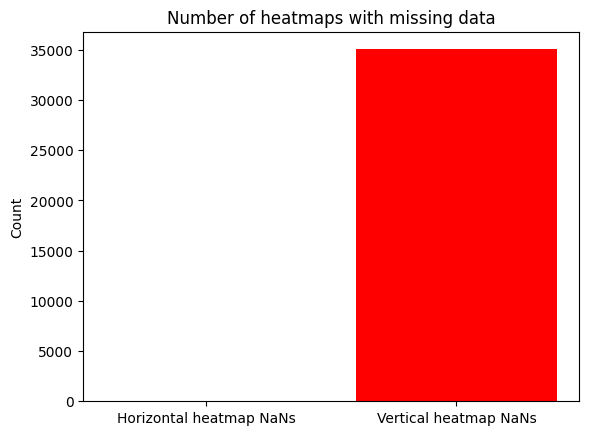

In [ ]:
print(f"Total nans in horizontal heatmap:{cNanHori}")
print(f"Total nans in vertical heatmap:{cNanVert}")


val = [cNanHori, cNanVert]
labels = ['Horizontal heatmap NaNs', 'Vertical heatmap NaNs']

plt.bar(labels, val, color = ['blue', 'red'])
plt.title("Number of heatmaps with missing data")
plt.ylabel('Count')
plt.show()

In [ ]:
rand = int(np.random.uniform(0, df.shape[1]))

print(f"Generating the mesh for instance: {rand}")

Generating the mesh for instance: 9


In [ ]:
vert = df['filled_vert'][2000]
vert.shape

(65, 65)

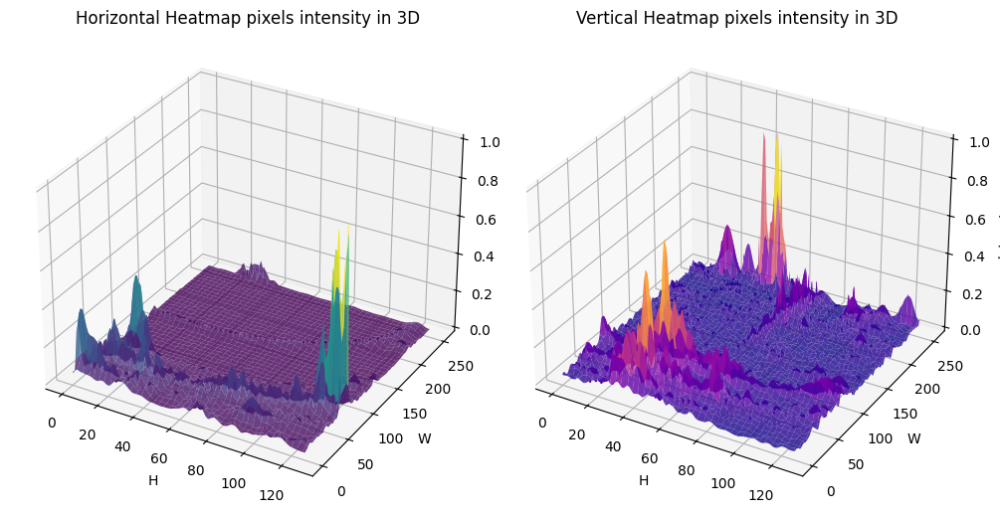

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Example heatmaps (replace with your actual data)
hori = df['filled_hori'][rand]
vert = df['filled_vert'][rand]

# Create a grid of x and y coordinates
x = np.arange(hori.shape[1])
y = np.arange(hori.shape[0])
x, y = np.meshgrid(x, y)

# Create a 3D figure
fig = plt.figure(figsize=(10, 10))

# Plot the horizontal heatmap as a 3D surface
ax1 = fig.add_subplot(121, projection='3d')  # First subplot
ax1.plot_surface(x, y, hori, cmap='viridis', alpha=0.8)
ax1.set_xlabel('H')
ax1.set_ylabel('W')
ax1.set_zlabel('Intensity')
ax1.set_title('Horizontal Heatmap pixels intensity in 3D')

# Plot the vertical heatmap as a 3D surface
ax2 = fig.add_subplot(122, projection='3d')
ax2.plot_surface(x, y, vert, cmap='plasma', alpha=0.8)
ax2.set_xlabel('H')
ax2.set_ylabel('W')
ax2.set_zlabel('Intensity')
ax2.set_title('Vertical Heatmap pixels intensity in 3D')


plt.tight_layout()
plt.show()

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

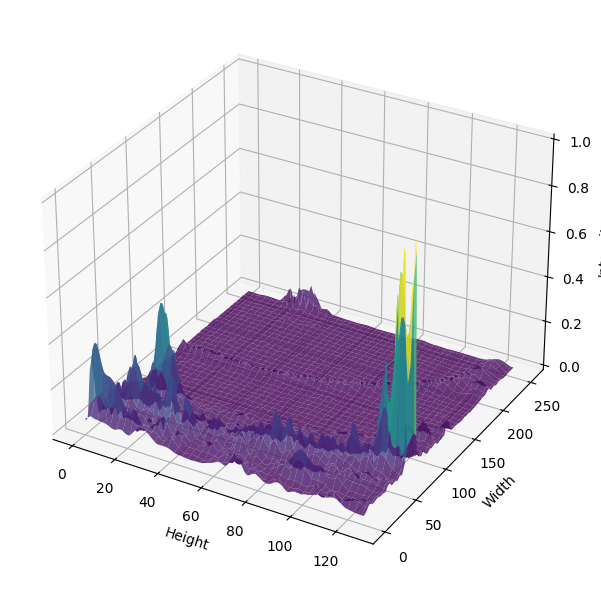

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from google.colab import files

# Example heatmaps (replace with your actual data)
hori = df['filled_hori'][rand]

# Create a grid of x and y coordinates
x = np.arange(hori.shape[1])
y = np.arange(hori.shape[0])
x, y = np.meshgrid(x, y)

# Create a 3D figure for horizontal heatmap only
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(x, y, hori, cmap='viridis', alpha=0.8)

ax.set_xlabel('Height')
ax.set_ylabel('Width')
ax.set_zlabel('Intensity')

# Manually adjust Z-label position: (x, y, z) in axis fraction coords
ax.zaxis.set_label_coords(-0.15, 0.5)

# Save as PNG with 600 DPI
plt.tight_layout()
plt.savefig("horizontal_heatmap_3D.png", dpi=600)

# Download from Colab
files.download("horizontal_heatmap_3D.png")


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from scipy.stats import pearsonr
import matplotlib.patches as mpatches
from skimage.transform import resize
from google.colab import files

def visualizeHeatmaps(i, df, save_path=None):
    ## Getting first instance
    hori = df['filled_hori'][i]  # Normalized horizontal heatmap
    vert = df['filled_vert'][i]  # Normalized vertical heatmap

    ## Getting bbox coordinates
    bbox = df['bbox_i'][i]

    ## Getting the mask for the same instance
    mask = df['mask'][i]  # Assuming mask is a 2D boolean array
    mask = np.squeeze(mask)

    # Resize the mask to match the heatmap dimensions
    mask_resized = resize(mask, (256, 128), order=0, preserve_range=True, anti_aliasing=False).astype(bool)

    ## Pearson correlation between the heatmaps
    correlation, _ = pearsonr(hori.flatten(), vert.flatten())

    ## Creating a figure with a 2x2 grid layout
    fig = plt.figure(figsize=(12, 10))

    ## First subplot: Horizontal heatmap
    ax1 = fig.add_subplot(2, 2, 1)
    ax1.imshow(hori, cmap='viridis', aspect='auto')
    ax1.set_title("Horizontal Heatmap")

    ## Second subplot: Vertical heatmap
    ax2 = fig.add_subplot(2, 2, 2)
    ax2.imshow(vert, cmap='plasma', aspect='auto')
    ax2.set_title("Vertical Heatmap")

    ## Third subplot: Masked Areas Overlay
    ax3 = fig.add_subplot(2, 2, 3)
    masked_overlay = np.where(mask_resized, hori + vert, np.nan)
    ax3.imshow(masked_overlay, cmap='gist_earth', aspect='auto')
    ax3.set_title("Masked Area on Horizontal and vertical Heatmap")

    ## Fourth subplot: 3D Overlay of Heatmaps
    ax4 = fig.add_subplot(2, 2, 4, projection='3d')

    ## Creating a grid of x and y coordinates
    x = np.arange(hori.shape[1])  ## Columns
    y = np.arange(hori.shape[0])  ## Rows
    x, y = np.meshgrid(x, y)

    ## Apply the mask to highlight the masked area
    hori_masked_green = np.where(mask_resized, hori, np.nan)
    vert_masked_green = np.where(mask_resized, vert, np.nan)

    ax4.plot_surface(x, y, hori, cmap='viridis', alpha=0.6)
    ax4.plot_surface(x, y, vert, cmap='plasma', alpha=0.6)
    ax4.plot_surface(x, y, hori_masked_green, cmap='gist_earth', alpha=1)
    ax4.plot_surface(x, y, vert_masked_green, cmap='gist_earth', alpha=1)

    ## Adding labels and title
    ax4.set_xlabel('Width')
    ax4.set_ylabel('Height')
    ax4.set_title(f'3D Overlay with Correlation: {correlation:.2f}')

    ## Rotating the plot
    ax4.view_init(elev=20, azim=90)

    ## Adjust layout
    plt.tight_layout()


ValueError: operands could not be broadcast together with shapes (256,128) (16,16) () 

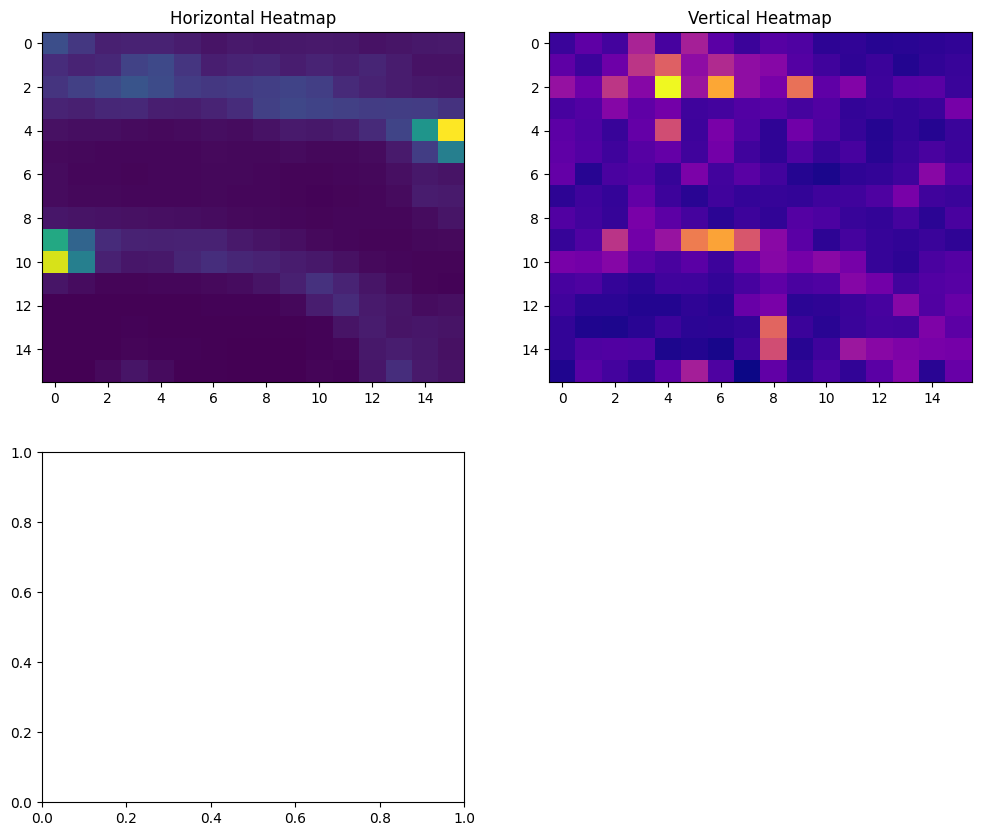

In [ ]:
for i in range(10):
  visualizeHeatmaps(i, df, save_path=f"heatmap_plot_Frame{i}.png")

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.transform import resize

def computeFrameDifference(df):
    frame_diffs_hori = []
    frame_diffs_vert = []
    frameMaskDiff = []

    for i in range(1, 100):  # Process all frames
        prev_hori = df['filled_hori'][i - 1]
        curr_hori = df['filled_hori'][i]
        prev_vert = df['filled_vert'][i - 1]
        curr_vert = df['filled_vert'][i]
        prevMask = df['mask'][i - 1].astype(bool)
        currMask = df['mask'][i].astype(bool)

        # Compute absolute differences
        diff_hori = np.abs(curr_hori - prev_hori)
        diff_vert = np.abs(curr_vert - prev_vert)

        # Compute mask difference using XOR
        maskDiff = np.logical_xor(currMask, prevMask).astype(np.uint8)

        frame_diffs_hori.append(diff_hori)
        frame_diffs_vert.append(diff_vert)
        frameMaskDiff.append(maskDiff)

    return frame_diffs_hori, frame_diffs_vert, frameMaskDiff

def visualizeFrameDifferences(frame_diffs_hori, frame_diffs_vert, maskDiff, frame_idx):
    """
    Visualizes the frame difference at a given index, overlaying mask changes.
    """
    if frame_idx >= len(frame_diffs_hori):
        print(f"Frame index {frame_idx} out of range.")
        return

    diff_hori = frame_diffs_hori[frame_idx]
    diff_vert = frame_diffs_vert[frame_idx]
    mask_resized = resize(maskDiff[frame_idx][0], (256, 128), order=0, preserve_range=True, anti_aliasing=False)

    fig, ax = plt.subplots(figsize=(8, 8))

    # Plot heatmap difference
    ax.imshow(diff_hori + diff_vert, cmap='inferno', aspect='auto')
    # Overlay mask difference with transparency
    ax.imshow(mask_resized, cmap='Reds', alpha=0.3, aspect='auto')




    ax.set_title(f'Horizontal and Vertical Combined Change (Frame {frame_idx} to {frame_idx+1})')

    plt.show()


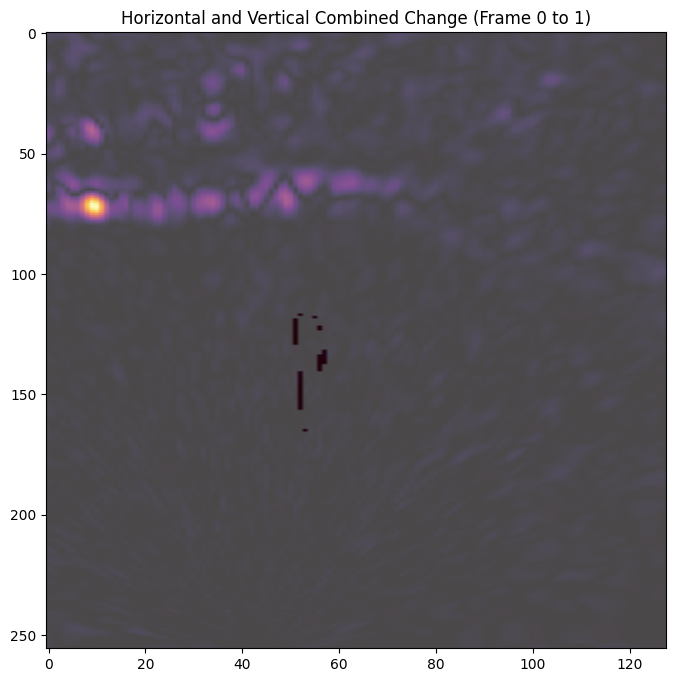

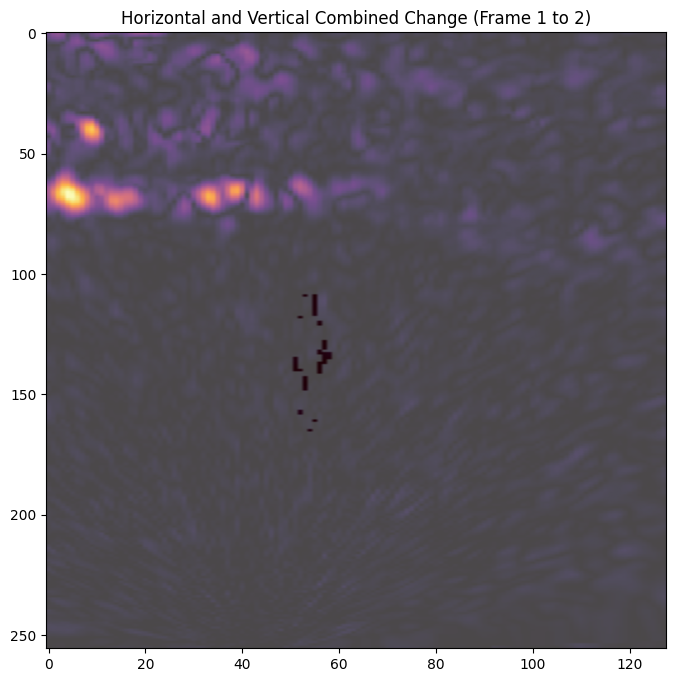

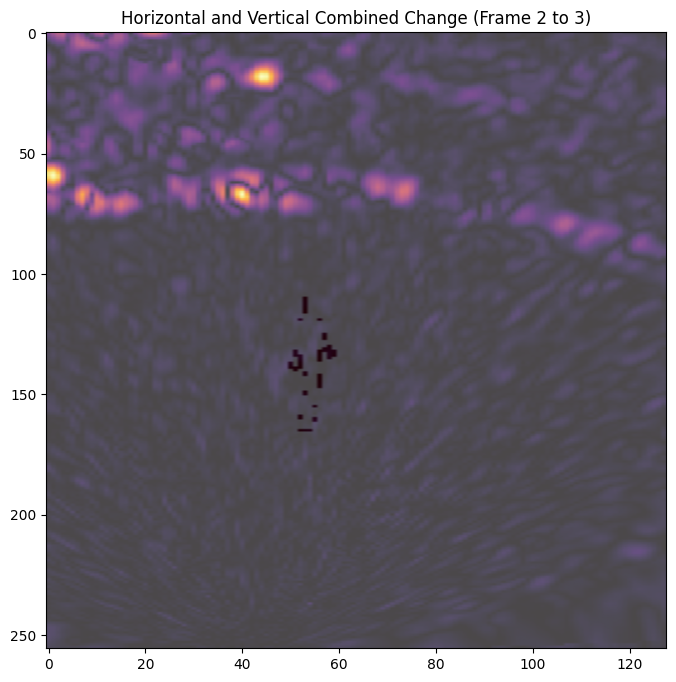

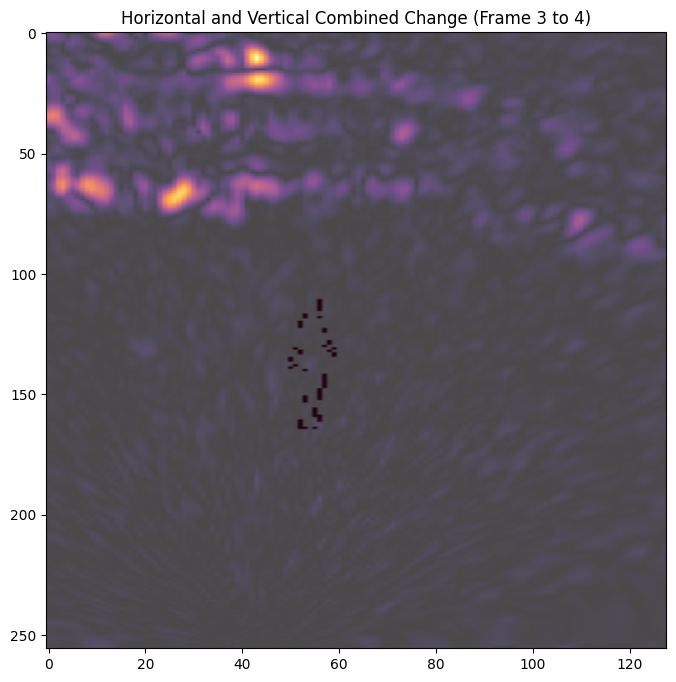

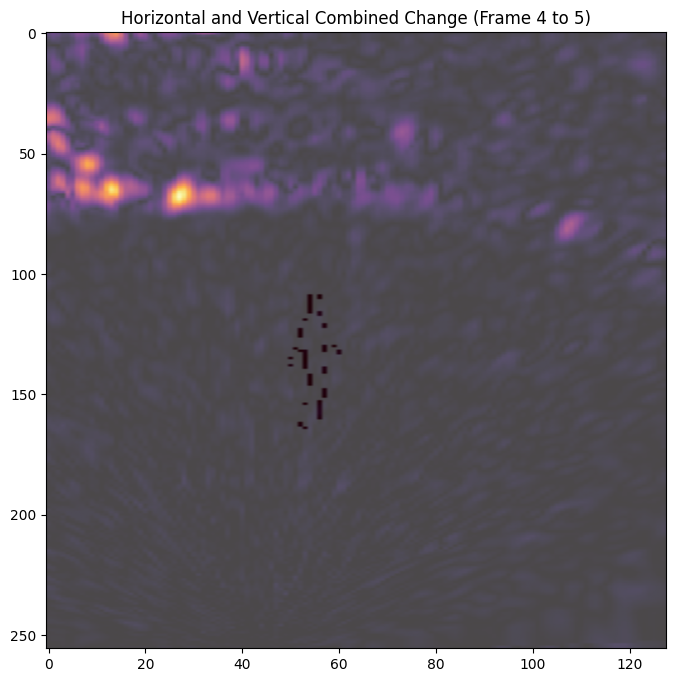

...

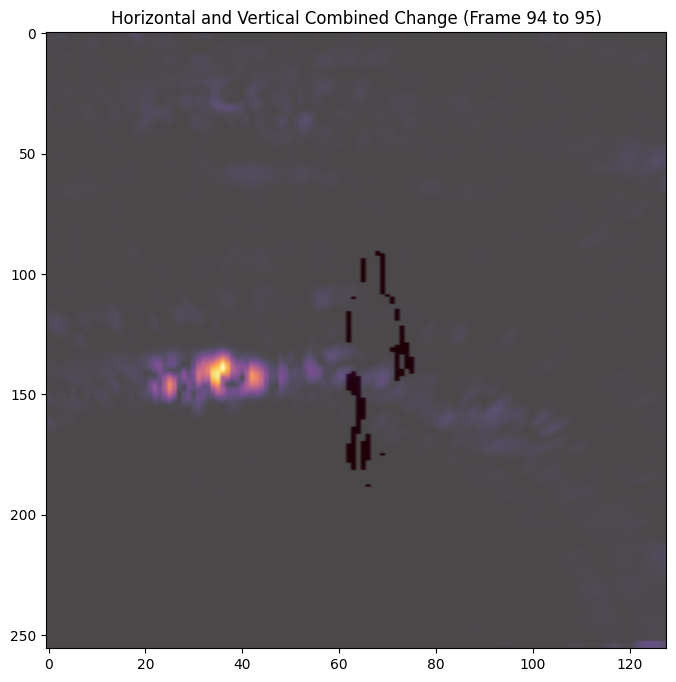

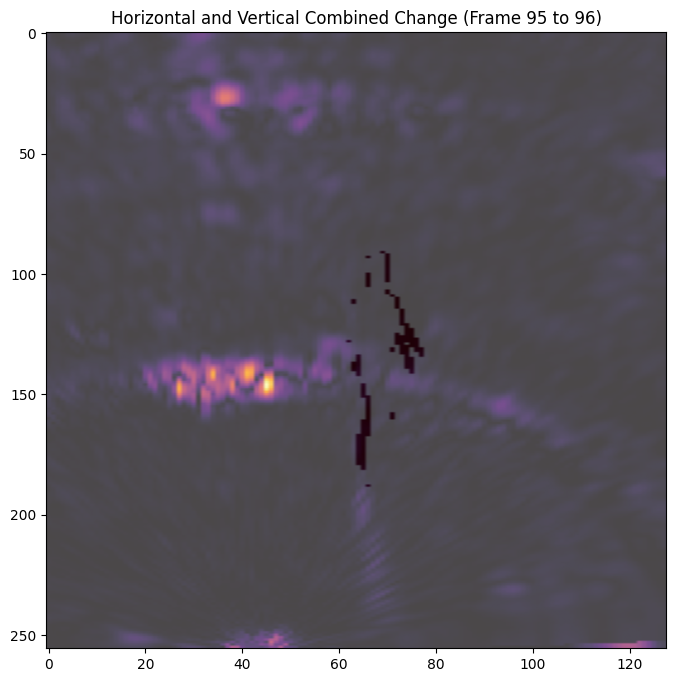

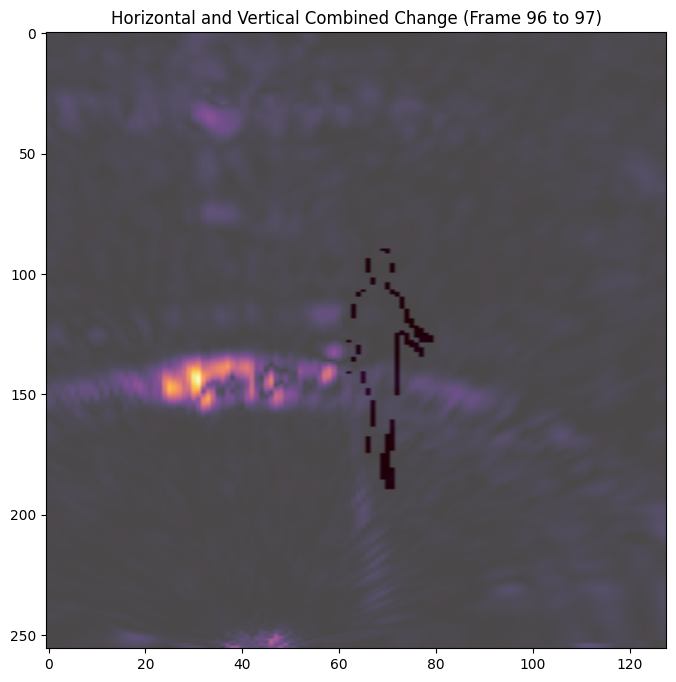

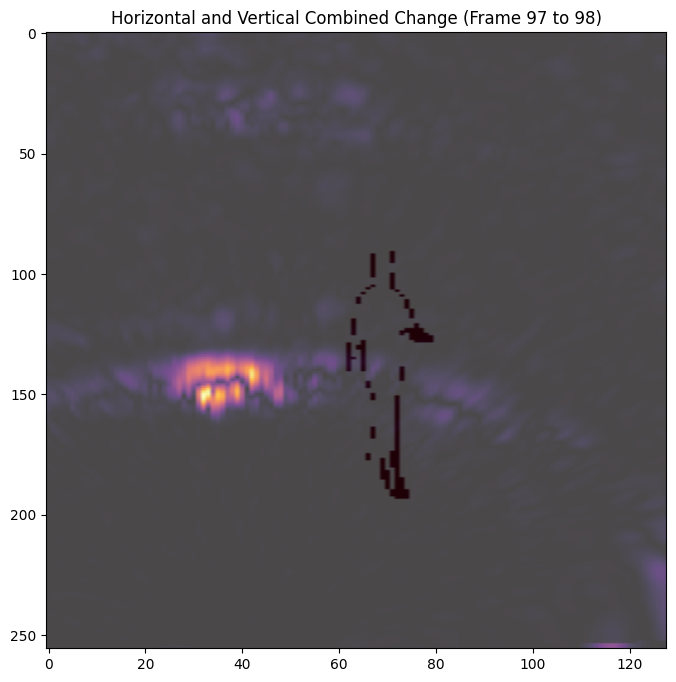

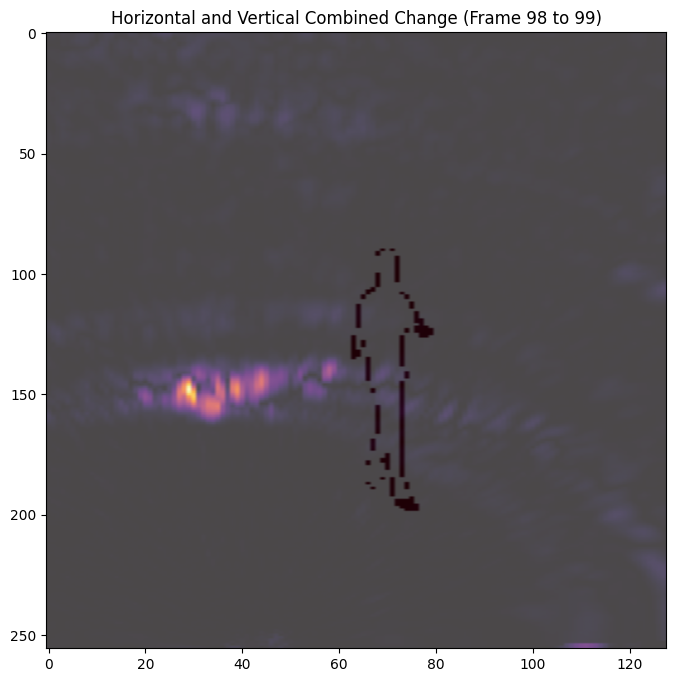

Frame index 99 out of range.


In [ ]:
frameDiffhori, frameDiffvert, maskDiff = computeFrameDifference(df)



for i in range(0, 100):
  visualizeFrameDifferences(frameDiffhori, frameDiffvert, maskDiff, frame_idx=i)

In [ ]:
# import numpy as np
# import pandas as pd
# from scipy.stats import pearsonr

# # Assuming `df` is your DataFrame with 'filled_hori' and 'filled_vert' columns containing filled heatmaps
# # Example DataFrame structure:
# # df = pd.DataFrame({'filled_hori': [hori1, hori2, ...], 'filled_vert': [vert1, vert2, ...]})

# # Initialize a list to store correlation values
# correlation_list = []

# # Loop through each row in the DataFrame
# for idx, row in df.iterrows():
#     hori = row['filled_hori']
#     vert = row['filled_vert']

#     # Flatten the heatmaps
#     hori_flat = hori.flatten()
#     vert_flat = vert.flatten()

#     # Calculate Pearson correlation
#     if len(hori_flat) > 0 and len(vert_flat) > 0:  # Ensure there are valid values
#         correlation, _ = pearsonr(hori_flat, vert_flat)
#         correlation_list.append(correlation)
#     else:
#         correlation_list.append(np.nan)  # If no valid values, store NaN

# # Calculate the average correlation (ignoring NaNs)
# average_correlation = np.nanmean(correlation_list)
# print(f"Average correlation between horizontal and vertical heatmaps: {average_correlation:.3f}")

In [ ]:
# import matplotlib.pyplot as plt
# import numpy as np
# import matplotlib.patches as patches

# # Create a figure with a larger size
# plt.figure(figsize=(12, 10))

# # Plot the heatmap
# plt.imshow(df['filled_vert'][10])

# # Define the top-left corner and bottom-right corner (in pixels)
# top_left = (253, 122)  # (y, x)
# bottom_right = (255, 127)  # (y, x)

# # Get the current axis
# ax = plt.gca()

# # Calculate width and height of the bounding box
# width = bottom_right[1] - top_left[1]  # x-direction (columns)
# height = bottom_right[0] - top_left[0]  # y-direction (rows)

# # Print bounding box parameters for debugging
# print(f"Bounding Box: x={top_left[1]}, y={top_left[0]}, width={width}, height={height}")

# # Add the rectangle to the plot
# bbox = patches.Rectangle(
#     (top_left[1], top_left[0]),
#     width, height,
#     linewidth=2,  # Increase line width
#     edgecolor='red',  # Change color to red for better contrast
#     linestyle='--'
# )
# ax.add_patch(bbox)

# # Define a margin around the bounding box for zooming
# margin = 10  # Adjust this value to control the zoom level

# # Set the axis limits to zoom around the bounding box
# plt.xlim([top_left[1] - margin, bottom_right[1] + margin])  # x-axis limits
# plt.ylim([bottom_right[0] + margin, top_left[0] - margin])  # y-axis limits (inverted)

# # Add grid lines
# plt.grid(True, color='white', linestyle='--', linewidth=0.5)

# # Display the heatmap with the bounding box
# plt.title('Zoomed Heatmap with Bounding Box')
# plt.show()

In [ ]:

# from scipy.ndimage import gaussian_filter

# def PreProcessVertHori(hori, vert, sigma=1):
#     ## Converting to NumPy arrays if they are Pandas Series
#     hori_filled = np.apply_along_axis(
#     lambda row: pd.Series(row).interpolate().fillna(0).to_numpy(),
#     axis=1,  # Apply along rows
#     arr=df['hori'][0]
#     )

#     hori_filled = np.apply_along_axis(
#     lambda row: pd.Series(row).interpolate().fillna(0).to_numpy(),
#     axis=1,  # Apply along rows
#     arr=df['hori'][0]
#     )


#     # ## Checking NaNs for horizontal heatmaps
#     # ## filling zero in that place for simplicity
#     # if np.isnan(hori).any():
#     #     horiFilled = np.where(np.isnan(hori), 0.0, hori)
#     # else:
#     #     horiFilled = hori

#     # ## Checking NaNs for vertical heatmaps
#     # ## filling zero in that place for simplicity
#     # if np.isnan(vert).any():
#     #     vertFilled = np.where(np.isnan(vert), 0.0, vert)
#     # else:
#     #     vertFilled = vert

#     ## Normalizing heatmaps to [0, 1]
#     def normalize(heatmap):
#         min_val = np.min(heatmap)
#         max_val = np.max(heatmap)
#         if min_val == max_val:
#              ## Returning zeros to avoid division by zero
#             return np.zeros_like(heatmap)
#         return (heatmap - min_val) / (max_val - min_val)
#     ## App;ying Gaussian filter to horizontal and vertical heatmaps
#     horiTemp = gaussian_filter(horiFilled, sigma=sigma)
#     vertTemp = gaussian_filter(horiFilled, sigma=sigma)

#     ## Normalizing the heatmaps
#     # hori_norm = normalize(horiTemp)
#     # vert_norm = normalize(vertTemp)

#     return horiTemp, vertTemp


In [ ]:
# # df['hori_filled'] = df['hori'].apply(
# #     lambda img: pd.DataFrame(img)
# #         .interpolate(axis=0, limit_direction='both')
# #         .interpolate(axis=1, limit_direction='both')
# #         .fillna(0)
# #         .to_numpy()
# #         .reshape(256, 128)  # Ensure shape remains (256, 128)
# # )
# # import cv2
# # import numpy as np

# # def fill_heatmap_gaussian(img, sigma=1):
# #     filled = np.nan_to_num(img, nan=0)  # Convert NaNs to 0 for processing
# #     return cv2.GaussianBlur(filled, (5, 5), sigma)

# # df['hori_filled'] = df['hori'].apply(fill_heatmap_gaussian)


# import cv2


# def fillNorm(img):
#     ## Filling NaNs with 0s first to avoid erroes
#     img_filled = np.nan_to_num(img, nan=0)

#     img_normalized = cv2.normalize(img_filled, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX)

#     return img_normalized


# df['hori_filled_normalized'] = df['hori'].apply(fillNorm)



In [ ]:
# ## Filling vertical heatmaps
# df['vert_filled_normalized'] = df['vert'].apply(fillNorm)


In [ ]:
# ## Plotting the normalised heatmaps to check the results
# plot_heatmaps_and_annotations(df['hori_filled_normalized'][0], df['vert_filled_normalized'][0], mask, bbox_i, kp, connections)

## Preprocessing YY

In [ ]:
import cv2
import numpy as np
import pandas as pd

def preProcessY_train(kp, bbox_i, mask):
    new_height, new_width = 16, 16

    # Initialize updated masks array
    updated_masks = np.zeros((mask.shape[0], new_height, new_width), dtype=np.uint8)

    # Scaling factors
    scaleX = new_width / mask.shape[2]   # Width scaling
    scaleY = new_height / mask.shape[1]  # Height scaling

    # Copy keypoints and bounding boxes
    updated_kp = kp.copy()
    updated_bbox_i = bbox_i.copy()

    for j in range(mask.shape[0]):
        # Resize mask (boolean to uint8)
        updated_masks[j] = cv2.resize(mask[j].astype(np.uint8), (new_width, new_height), interpolation=cv2.INTER_NEAREST)

        # Scale bounding boxes
        updated_bbox_i[j, :4] = (bbox_i[j, :4] * np.array([scaleX, scaleY, scaleX, scaleY])).astype(int)

        # Scale keypoints
        updated_kp[j, :, 0] *= scaleX
        updated_kp[j, :, 1] *= scaleY
        angles = set()
         # Plot keypoints (blue)
        for connection in connections:
          if jointDict[connection[0]] in angleTriplets:
            angles.add(computeAngle(connection[0], j,  updated_kp))

    return updated_kp, updated_bbox_i, updated_masks, list(angles)

# Initialize lists to store processed data
scaled_kp_list, scaled_bbox_list, scaled_mask_list, angles_list = [], [], [], []

# Efficient iteration using zip()
for kp, bbox_i, mask in zip(df['kp'], df['bbox_i'], df['mask']):
    scaledKp, scaledBbox_i, scaledMask, angles = preProcessY_train(kp, bbox_i, mask)

    # Append results to lists
    scaled_kp_list.append(scaledKp)
    scaled_bbox_list.append(scaledBbox_i)
    scaled_mask_list.append(scaledMask)
    angles_list.append(angles)

# Convert lists to a DataFrame (efficient single-step creation)
YY = pd.DataFrame({
    "scaledKp": scaled_kp_list,
    "scaledBbox_i": scaled_bbox_list,
    "scaledMask": scaled_mask_list,
    "Angles": angles_list
})

## Preprocessing YY for RF-pose

In [ ]:
import cv2
import numpy as np
import pandas as pd

def preProcessY_train(kp, bbox_i, mask):
    new_height, new_width = 65, 65

    # Initialize updated masks array
    updated_masks = np.zeros((mask.shape[0], new_height, new_width), dtype=np.uint8)

    # Scaling factors
    scaleX = new_width / mask.shape[2]   # Width scaling
    scaleY = new_height / mask.shape[1]  # Height scaling

    # Copy keypoints and bounding boxes
    updated_kp = kp.copy()
    updated_bbox_i = bbox_i.copy()

    for j in range(mask.shape[0]):
        # Resize mask (boolean to uint8)
        updated_masks[j] = cv2.resize(mask[j].astype(np.uint8), (new_width, new_height), interpolation=cv2.INTER_NEAREST)

        # Scale bounding boxes
        updated_bbox_i[j, :4] = (bbox_i[j, :4] * np.array([scaleX, scaleY, scaleX, scaleY])).astype(int)

        # Scale keypoints
        updated_kp[j, :, 0] *= scaleX
        updated_kp[j, :, 1] *= scaleY
        angles = set()
         # Plot keypoints (blue)

    return updated_kp, updated_bbox_i, updated_masks

# Initialize lists to store processed data
scaled_kp_list, scaled_bbox_list, scaled_mask_list, angles_list = [], [], [], []

# Efficient iteration using zip()
for kp, bbox_i, mask in zip(df['kp'], df['bbox_i'], df['mask']):
    scaledKp, scaledBbox_i, scaledMask = preProcessY_train(kp, bbox_i, mask)

    # Append results to lists
    scaled_kp_list.append(scaledKp)
    scaled_bbox_list.append(scaledBbox_i)
    scaled_mask_list.append(scaledMask)


# Convert lists to a DataFrame (efficient single-step creation)
YY = pd.DataFrame({
    "scaledKp": scaled_kp_list,
    "scaledBbox_i": scaled_bbox_list,
    "scaledMask": scaled_mask_list,
})

In [ ]:
kpsRf = np.stack(YY['scaledKp'])[:, 0, :]

kpsRf.shape

(17598, 17, 3)

In [ ]:
kpsRf[0]

array([[28.858032  , 28.215334  ,  0.8841429 ],
       [28.953247  , 28.08838   ,  0.8314843 ],
       [28.52478   , 28.08838   ,  0.85183704],
       [29.286499  , 28.151857  ,  0.16202368],
       [28.096313  , 28.151857  ,  0.90726864],
       [29.619751  , 30.183107  ,  0.9004743 ],
       [27.286987  , 30.11963   ,  0.8925514 ],
       [30.00061   , 32.34131   ,  0.8579767 ],
       [26.620483  , 32.15088   ,  0.8671476 ],
       [29.953003  , 34.37256   ,  0.68190074],
       [26.953735  , 33.674316  ,  0.881023  ],
       [29.334106  , 35.388184  ,  0.85033214],
       [27.763062  , 35.388184  ,  0.8406313 ],
       [29.238892  , 39.32373   ,  0.8900919 ],
       [27.763062  , 39.260254  ,  0.8174397 ],
       [29.286499  , 42.941895  ,  0.85320985],
       [28.048706  , 41.989746  ,  0.8242265 ]], dtype=float32)

In [ ]:
import numpy as np

def convertHeatmap(x, y, conf):
    heatmap = np.zeros((65, 65), dtype=np.float32)
    x = int(np.clip(round(x), 0, 64))
    y = int(np.clip(round(y), 0, 64))

    if conf >= 0.4:
        heatmap[y, x] = 1.0
    return heatmap

def preprocessStudentMaps(kps, windowSize=7):
    totalFrames = kps.shape[0]
    gtHeatmaps = []

    for start in range(totalFrames - windowSize + 1):
        kpSeq = kps[start:start + windowSize]
        heatMapFrames = [
            [convertHeatmap(kp[0], kp[1], kp[2]) for kp in frame]
            for frame in kpSeq
        ]
        gtHeatmaps.append(heatMapFrames)

    return np.array(gtHeatmaps)

In [ ]:
# import numpy as np
# import numpy as np
# def convertHeatmap(x, y, conf):
#   heatmap = np.zeros((65, 65))
#   x = int(np.clip(round(x), 0, 64))
#   y = int(np.clip(round(y), 0, 64))

#   if conf < 0.4:
#     heatmap[y,x] = 0
#   else:
#     heatmap[y,x] = 1
#   return heatmap


# # def convertGayussion(x, y, heatmap):
# #   sigma = 0.5
# #   height = heatmap.shape[1]
# #   width = heatmap.shape[2]
# #   y_grid, x_grid = np.meshgrid(np.arange(height), np.arange(width), indexing = 'ij')
# #   x_grid = x_grid[None, None, :, :]
# #   y_grid = y_grid[None, None, :, :]
# #   return np.exp(-((x_grid - x)**2 + (y_grid - y)**2) / 2 * sigma**2)

# def preprocessStudentMaps(kps, windowSize=7):

#   totalFrames = kps.shape[0]

#   gtHeatmaps = []

#   chunkSize = totalFrames//windowSize
#   for start in range(totalFrames-windowSize +1):
#     kpSeq = kps[start:start+windowSize]
#     heatMapFrames = []

#     for frames in kpSeq:
#       depth = []
#       for kp in frames:
#         x, y, conf = kp
#         out = convertHeatmap(int(round(x)), int(round(y)), conf)
#         depth.append(out)
#       heatMapFrames.append(depth)

#     gtHeatmaps.append(heatMapFrames)

#   return np.array(gtHeatmaps)



gtKpsHeatmap = preprocessStudentMaps(kpsRf)

In [ ]:
gtKpsHeatmap.shape

(17592, 7, 17, 65, 65)

In [ ]:
import numpy as np
from numpy.lib.stride_tricks import sliding_window_view

def convertHeatmaps_batch(kps):
    """
    kps: shape (frames, num_kps, 3) -> (x, y, conf)
    Returns: heatmaps shape (frames, num_kps, 65, 65)
    """
    frames, num_kps, _ = kps.shape
    heatmaps = np.zeros((frames, num_kps, 65, 65), dtype=np.float32)

    # Process all coords at once
    x = np.clip(np.round(kps[..., 0]).astype(int), 0, 64)
    y = np.clip(np.round(kps[..., 1]).astype(int), 0, 64)
    conf_mask = kps[..., 2] >= 0.4  # True if confident

    # Fill heatmaps where conf is high
    for f in range(frames):
        for k in range(num_kps):
            if conf_mask[f, k]:
                heatmaps[f, k, y[f, k], x[f, k]] = 1

    return heatmaps

def preprocessStudentMaps_fast(kps, windowSize=7):
    """
    Vectorized sliding window creation
    """
    all_heatmaps = convertHeatmaps_batch(kps)  # (frames, num_kps, 65, 65)

    # Create sliding windows (no loops!)
    windows = sliding_window_view(all_heatmaps, (windowSize, all_heatmaps.shape[1], 65, 65))
    windows = windows.squeeze(axis=1)  # shape: (frames-windowSize+1, windowSize, num_kps, 65, 65)

    return windows

# Example usage
# kpsRf: (frames, num_kps, 3)
gtKpsHeatmap = preprocessStudentMaps_fast(kpsRf)


In [ ]:
gtKpsHeatmap.shape

array([[[4.5671875e+01, 1.0462501e+02, 1.1501177e-03],
        [4.4828125e+01, 1.0487501e+02, 2.2542141e-03],
        [4.7828125e+01, 1.0337501e+02, 1.3973813e-03],
        [4.4828125e+01, 1.0312501e+02, 3.2131410e-01],
        [4.8015625e+01, 1.0312501e+02, 3.1340852e-01],
        [4.2671875e+01, 1.1462501e+02, 3.1338295e-01],
        [4.9421875e+01, 1.1312501e+02, 3.1702909e-01],
        [4.1828125e+01, 1.2912500e+02, 3.1332910e-01],
        [5.1484375e+01, 1.2687501e+02, 3.2149154e-01],
        [4.0421875e+01, 1.4137500e+02, 3.2386166e-01],
        [5.2515625e+01, 1.3687500e+02, 3.1992596e-01],
        [4.4265625e+01, 1.4462500e+02, 2.7644649e-01],
        [4.8578125e+01, 1.4337500e+02, 2.7718425e-01],
        [4.5015625e+01, 1.6262502e+02, 2.9897821e-01],
        [4.9515625e+01, 1.6262502e+02, 3.0831558e-01],
        [4.6328125e+01, 1.8062502e+02, 2.6309335e-01],
        [4.7265625e+01, 1.7912502e+02, 3.1014842e-01]]], dtype=float32)

## Jumping(YY)

In [ ]:
import cv2
import numpy as np
import pandas as pd

def preProcessY_train(kp, bbox_i, mask):
    new_height, new_width = 16, 16

    # Initialize updated masks array
    updated_masks = np.zeros((mask.shape[0], new_height, new_width), dtype=np.uint8)

    # Scaling factors
    scaleX = new_width / mask.shape[2]   # Width scaling
    scaleY = new_height / mask.shape[1]  # Height scaling

    # Copy keypoints and bounding boxes
    updated_kp = kp.copy()
    updated_bbox_i = bbox_i.copy()

    for j in range(mask.shape[0]):
        # Resize mask (boolean to uint8)
        updated_masks[j] = cv2.resize(mask[j].astype(np.uint8), (new_width, new_height), interpolation=cv2.INTER_NEAREST)

        # Scale bounding boxes
        updated_bbox_i[j, :4] = (bbox_i[j, :4] * np.array([scaleX, scaleY, scaleX, scaleY])).astype(int)

        # Scale keypoints
        updated_kp[j, :, 0] *= scaleX
        updated_kp[j, :, 1] *= scaleY
        scaleZ = (scaleX + scaleY)/2
        updated_kp[j, :, 2] *= scaleZ
        angles = set()
         # Plot keypoints (blue)
        for connection in connections:
          if jointDict[connection[0]] in angleTriplets:
            angles.add(computeAngle(connection[0], j,  updated_kp))

    return updated_kp, updated_bbox_i, updated_masks, list(angles)

# Initialize lists to store processed data
scaled_kp_list, scaled_bbox_list, scaled_mask_list, angles_list = [], [], [], []

# Efficient iteration using zip()
for kp, bbox_i, mask in zip(df_jumping['kp'], df_jumping['bbox_i'], df_jumping['mask']):
    scaledKp, scaledBbox_i, scaledMask, angles = preProcessY_train(kp, bbox_i, mask)

    # Append results to lists
    scaled_kp_list.append(scaledKp)
    scaled_bbox_list.append(scaledBbox_i)
    scaled_mask_list.append(scaledMask)
    angles_list.append(angles)

# Convert lists to a DataFrame (efficient single-step creation)
YY_jumping = pd.DataFrame({
    "scaledKp": scaled_kp_list,
    "scaledBbox_i": scaled_bbox_list,
    "scaledMask": scaled_mask_list,
})

In [ ]:
YY_jumping.shape

(16943, 3)

In [ ]:
def stackFramesWithScaledMask(df, YY, maxframes=900, use_half=False, use_first_half=True):
    if use_half:
        half_idx = len(df) // 2
        if use_first_half:
            df = df.iloc[:half_idx]
        else:
            df = df.iloc[half_idx:]

    n = len(df) - 1
    stack_horiJump = [None] * n
    stack_vertJump = [None] * n
    mask_stackJump = [None] * n
    kp_stackJump = [None] * n
    angles_stack = [None] * n
    count = 0

    scaled_mask_dict = {i: YY.loc[i, 'scaledMask'] for i in range(len(YY))}
    scaledKpDict = {i: YY.loc[i, 'scaledKp'] for i in range(len(YY))}
    # AnglesDict = {i: YY.loc[i, 'Angles'] for i in range(len(YY))}

    for (_, prevRow), (_, currRow) in zip(df[:-1].iterrows(), df[1:].iterrows()):
        seq_curr, frame_curr = map(int, currRow['timeStep'].split('_'))
        seq_prev, frame_prev = map(int, prevRow['timeStep'].split('_'))

        if seq_curr == seq_prev and frame_curr == frame_prev + 1:
            try:
                prev_hori = prevRow['filled_hori']
                prev_vert = prevRow['filled_vert']
                curr_hori = currRow['filled_hori']
                curr_vert = currRow['filled_vert']

                prev_mask = scaled_mask_dict.get(prevRow.name, None)
                curr_mask = scaled_mask_dict.get(currRow.name, None)

                prev_kp = scaledKpDict.get(prevRow.name, None)
                curr_kp = scaledKpDict.get(currRow.name, None)

                # prev_angles = AnglesDict.get(prevRow.name, None)
                # curr_angles = AnglesDict.get(currRow.name, None)


                if prev_mask is not None and curr_mask is not None:
                    hori_stack = np.stack([prev_hori, curr_hori], axis=0)
                    vert_stack = np.stack([prev_vert, curr_vert], axis=0)

                    maskStack = np.stack([prev_mask, curr_mask], axis=0)
                    kpStack = np.stack([prev_kp, curr_kp], axis=0)
                    # anglesStack = np.stack([prev_angles, curr_angles], axis=0)

                    stack_horiJump[count] = hori_stack
                    stack_vertJump[count] = vert_stack
                    mask_stackJump[count] = maskStack
                    kp_stackJump[count] = kpStack
                    # angles_stack[count] = anglesStack
                    count += 1
                else:
                    print(f"Skipping due to missing scaled mask for indices {prevRow.name} or {currRow.name}")

            except Exception as e:
                print(f"Skipping due to error: {e}")

    stack_horiJump = np.array(stack_horiJump[:count])
    stack_vertJump = np.array(stack_vertJump[:count])
    mask_stackJump = np.squeeze(np.array(mask_stackJump[:count]), axis=2)
    kp_stackJump = np.squeeze(np.array(kp_stackJump[:count]), axis=2)
    # angles_stack = np.squeeze(np.array(angles_stack[:count]))


    return stack_horiJump, stack_vertJump, mask_stackJump, kp_stackJump


stack_horiJump, stack_vertJump, maskStackJump, kpStackJump = stackFramesWithScaledMask(df_jumping, YY_jumping)

print("Shape of stacked horizontal heatmaps:", stack_horiJump.shape)
print("Shape of stacked vertical heatmaps:", stack_vertJump.shape)
print("Shape of mask stack:", maskStackJump.shape)
print("Shape of keypoint stack:", kpStackJump.shape)


Shape of stacked horizontal heatmaps: (16924, 2, 16, 16)
Shape of stacked vertical heatmaps: (16924, 2, 16, 16)
Shape of mask stack: (16924, 2, 16, 16)
Shape of keypoint stack: (16924, 2, 17, 3)


## Stacking using overlapping frames

In [ ]:
def stackFramesWithWindow(df, YY, window_size=83, stride=1, use_half=False, use_first_half=True):
    if use_half:
        half_idx = len(df) // 2
        df = df.iloc[:half_idx] if use_first_half else df.iloc[half_idx:]

    stack_hori = []
    stack_vert = []
    stack_mask = []
    stack_kp = []

    scaled_mask_dict = {i: YY.loc[i, 'scaledMask'] for i in range(len(YY))}
    scaled_kp_dict = {i: YY.loc[i, 'scaledKp'] for i in range(len(YY))}

    total_frames = len(df)

    for start in range(0, total_frames - window_size + 1, stride):
        window = df.iloc[start:start + window_size]


        valid = True
        for i in range(window_size - 1):
            curr_seq, curr_frame = map(int, window.iloc[i]['timeStep'].split('_'))
            next_seq, next_frame = map(int, window.iloc[i + 1]['timeStep'].split('_'))

            if curr_seq != next_seq or next_frame != curr_frame + 1:
                valid = False
                break

        if not valid:
            continue

        try:
            hori_seq = np.stack([row['filled_hori'] for _, row in window.iterrows()], axis=0)
            vert_seq = np.stack([row['filled_vert'] for _, row in window.iterrows()], axis=0)
            mask_seq = np.stack([scaled_mask_dict.get(row.name) for _, row in window.iterrows()], axis=0)
            kp_seq = np.stack([scaled_kp_dict.get(row.name) for _, row in window.iterrows()], axis=0)

            stack_hori.append(hori_seq)
            stack_vert.append(vert_seq)
            stack_mask.append(mask_seq)
            stack_kp.append(kp_seq)

        except Exception as e:
            print(f"Skipping window starting at index {start} due to error: {e}")
            continue

    stack_hori = np.array(stack_hori)
    stack_vert = np.array(stack_vert)
    stack_mask = np.squeeze(np.array(stack_mask), axis=2)
    stack_kp = np.squeeze(np.array(stack_kp), axis=2)

    return stack_hori, stack_vert, stack_mask, stack_kp


In [ ]:
stack_hori, stack_vert, maskStack, kpStack = stackFramesWithWindow(df, YY, window_size=83)

print("Shape of stacked horizontal heatmaps:", stack_hori.shape)
print("Shape of stacked vertical heatmaps:", stack_vert.shape)
print("Shape of mask stack:", maskStack.shape)
print("Shape of keypoint stack:", kpStack.shape)


In [ ]:
# def stackFramesWithScaledMask(df, YY, maxframes=900, use_half=False, use_first_half=False):
#     # Use half of the data if use_half is True
#     if use_half:
#         half_idx = len(df) // 2
#         if use_first_half:
#             df = df.iloc[:half_idx]  # Use the first half
#         else:
#             df = df.iloc[half_idx:]  # Use the second half

#     n = len(df) - 1
#     stack = [None] * n  # Preallocate list for feature sequences
#     mask_stack = [None] * n  # Preallocate list for masks
#     kp_stack = [None] * n
#     count = 0

#     # Mapping index of df to scaled mask from YY
#     scaled_mask_dict = {i: YY.loc[i, 'scaledMask'] for i in range(len(YY))}
#     scaledKpDict = {i:YY.loc[i, 'scaledKp'] for i in range(len(YY))}

#     for (_, prevRow), (_, currRow) in zip(df[:-1].iterrows(), df[1:].iterrows()):
#         seq_curr, frame_curr = map(int, currRow['timeStep'].split('_'))
#         seq_prev, frame_prev = map(int, prevRow['timeStep'].split('_'))

#         # Check if both timeStep are from the same sequence and frames are consecutive
#         if seq_curr == seq_prev and frame_curr == frame_prev + 1:
#             try:
#                 # Stack features (filled_hori and filled_vert)
#                 stackedFeatures = np.stack([
#                     [prevRow['filled_hori'], prevRow['filled_vert']],
#                     [currRow['filled_hori'], currRow['filled_vert']]
#                 ], axis=0)  # Shape: (2, 2)

#                 ## Fetching the scaled masks for prevRow and currRow from YY DataFrame
#                 prev_mask = scaled_mask_dict.get(prevRow.name, None)
#                 curr_mask = scaled_mask_dict.get(currRow.name, None)

#                 prev_kp = scaledKpDict.get(prevRow.name, None)
#                 curr_kp = scaledKpDict.get(currRow.name, None)

#                 if prev_mask is not None and curr_mask is not None:
#                     ## making sure data is ready for LSTM component
#                     maskStack = np.stack([prev_mask, curr_mask], axis=0)
#                     kpStack = np.stack([prev_kp, curr_kp], axis=0)
#                     stack[count] = stackedFeatures
#                     mask_stack[count] = maskStack
#                     kp_stack[count] = kpStack
#                     count += 1
#                 else:
#                     print(f"Skipping due to missing scaled mask for indices {prevRow.name} or {currRow.name}")

#             except Exception as e:
#                 print(f"Skipping due to error: {e}")  # Debugging for shape mismatches

#     # Convert lists to NumPy arrays
#     stack = np.array(stack[:count])
#     mask_stack = np.array(mask_stack[:count])
#     kp_stack = np.array(kp_stack[:count])
#     return stack, mask_stack, kp_stack


# stack, maskStack, kpStack = stackFramesWithScaledMask(df, YY)
# print(stack.shape)
# print(maskStack.shape)
# print(kpStack.shape)

In [ ]:
def stackFramesWithScaledMask(df, YY, maxframes=900, use_half=False, use_first_half=True):
    if use_half:
        half_idx = len(df) // 2
        if use_first_half:
            df = df.iloc[:half_idx]
        else:
            df = df.iloc[half_idx:]

    n = len(df) - 1
    stack_hori = [None] * n
    stack_vert = [None] * n
    mask_stack = [None] * n
    kp_stack = [None] * n
    angles_stack = [None] * n
    count = 0

    scaled_mask_dict = {i: YY.loc[i, 'scaledMask'] for i in range(len(YY))}
    scaledKpDict = {i: YY.loc[i, 'scaledKp'] for i in range(len(YY))}
    AnglesDict = {i: YY.loc[i, 'Angles'] for i in range(len(YY))}

    for (_, prevRow), (_, currRow) in zip(df[:-1].iterrows(), df[1:].iterrows()):
        seq_curr, frame_curr = map(int, currRow['timeStep'].split('_'))
        seq_prev, frame_prev = map(int, prevRow['timeStep'].split('_'))

        if seq_curr == seq_prev and frame_curr == frame_prev + 1:
            try:
                prev_hori = prevRow['filled_hori']
                prev_vert = prevRow['filled_vert']
                curr_hori = currRow['filled_hori']
                curr_vert = currRow['filled_vert']

                prev_mask = scaled_mask_dict.get(prevRow.name, None)
                curr_mask = scaled_mask_dict.get(currRow.name, None)

                prev_kp = scaledKpDict.get(prevRow.name, None)
                curr_kp = scaledKpDict.get(currRow.name, None)

                prev_angles = AnglesDict.get(prevRow.name, None)
                curr_angles = AnglesDict.get(currRow.name, None)


                if prev_mask is not None and curr_mask is not None:
                    hori_stack = np.stack([prev_hori, curr_hori], axis=0)
                    vert_stack = np.stack([prev_vert, curr_vert], axis=0)

                    maskStack = np.stack([prev_mask, curr_mask], axis=0)
                    kpStack = np.stack([prev_kp, curr_kp], axis=0)
                    anglesStack = np.stack([prev_angles, curr_angles], axis=0)

                    stack_hori[count] = hori_stack
                    stack_vert[count] = vert_stack
                    mask_stack[count] = maskStack
                    kp_stack[count] = kpStack
                    angles_stack[count] = anglesStack
                    count += 1
                else:
                    print(f"Skipping due to missing scaled mask for indices {prevRow.name} or {currRow.name}")

            except Exception as e:
                print(f"Skipping due to error: {e}")

    stack_hori = np.array(stack_hori[:count])
    stack_vert = np.array(stack_vert[:count])
    mask_stack = np.squeeze(np.array(mask_stack[:count]), axis=2)
    kp_stack = np.squeeze(np.array(kp_stack[:count]), axis=2)
    angles_stack = np.squeeze(np.array(angles_stack[:count]))


    return stack_hori, stack_vert, mask_stack, kp_stack, angles_stack


stack_hori, stack_vert, maskStack, kpStack, anglesStack = stackFramesWithScaledMask(df, YY)

print("Shape of stacked horizontal heatmaps:", stack_hori.shape)
print("Shape of stacked vertical heatmaps:", stack_vert.shape)
print("Shape of mask stack:", maskStack.shape)
print("Shape of keypoint stack:", kpStack.shape)
print("Shape of Angle stack:", anglesStack.shape)

Shape of stacked horizontal heatmaps: (35007, 2, 16, 16)
Shape of stacked vertical heatmaps: (35007, 2, 16, 16)
Shape of mask stack: (35007, 2, 16, 16)
Shape of keypoint stack: (35007, 2, 17, 3)
Shape of Angle stack: (35007, 2, 8, 2)


In [ ]:
# def stackFramesWithScaledMask_3steps(df, YY, maxframes=900, use_half=False, use_first_half=True):
#     if use_half:
#         half_idx = len(df) // 2
#         df = df.iloc[:half_idx] if use_first_half else df.iloc[half_idx:]

#     n = len(df) - 2
#     stack_hori = [None] * n
#     stack_vert = [None] * n
#     mask_stack = [None] * n
#     kp_stack = [None] * n
#     angles_stack = [None] * n
#     count = 0

#     scaled_mask_dict = {i: YY.loc[i, 'scaledMask'] for i in range(len(YY))}
#     scaledKpDict = {i: YY.loc[i, 'scaledKp'] for i in range(len(YY))}
#     AnglesDict = {i: YY.loc[i, 'Angles'] for i in range(len(YY))}

#     for (idx0, row0), (idx1, row1), (idx2, row2) in zip(df[:-2].iterrows(), df[1:-1].iterrows(), df[2:].iterrows()):
#         seq0, frame0 = map(int, row0['timeStep'].split('_'))
#         seq1, frame1 = map(int, row1['timeStep'].split('_'))
#         seq2, frame2 = map(int, row2['timeStep'].split('_'))

#         if seq0 == seq1 == seq2 and frame1 == frame0 + 1 and frame2 == frame1 + 1:
#             try:
#                 hori_stack = np.stack([row0['filled_hori'], row1['filled_hori'], row2['filled_hori']], axis=0)
#                 vert_stack = np.stack([row0['filled_vert'], row1['filled_vert'], row2['filled_vert']], axis=0)

#                 prev_mask = scaled_mask_dict.get(idx0, None)
#                 mid_mask = scaled_mask_dict.get(idx1, None)
#                 next_mask = scaled_mask_dict.get(idx2, None)

#                 prev_kp = scaledKpDict.get(idx0, None)
#                 mid_kp = scaledKpDict.get(idx1, None)
#                 next_kp = scaledKpDict.get(idx2, None)

#                 prev_angles = AnglesDict.get(idx0, None)
#                 mid_angles = AnglesDict.get(idx1, None)
#                 next_angles = AnglesDict.get(idx2, None)

#                 if prev_mask is not None and mid_mask is not None and next_mask is not None:
#                     maskStack = np.stack([prev_mask, mid_mask, next_mask], axis=0)
#                     kpStack = np.stack([prev_kp, mid_kp, next_kp], axis=0)
#                     anglesStack = np.stack([prev_angles, mid_angles, next_angles], axis=0)

#                     stack_hori[count] = hori_stack
#                     stack_vert[count] = vert_stack
#                     mask_stack[count] = maskStack
#                     kp_stack[count] = kpStack
#                     angles_stack[count] = anglesStack
#                     count += 1
#             except Exception as e:
#                 print(f"Skipping due to error: {e}")

#     stack_hori = np.array(stack_hori[:count])
#     stack_vert = np.array(stack_vert[:count])
#     mask_stack = np.squeeze(np.array(mask_stack[:count]), axis=2)
#     kp_stack = np.squeeze(np.array(kp_stack[:count]), axis=2)
#     angles_stack = np.squeeze(np.array(angles_stack[:count]))

#     return stack_hori, stack_vert, mask_stack, kp_stack, angles_stack


# stack_hori, stack_vert, maskStack, kpStack, anglesStack = stackFramesWithScaledMask_3steps(df, YY)

# print("Shape of stacked horizontal heatmaps:", stack_hori.shape)
# print("Shape of stacked vertical heatmaps:", stack_vert.shape)
# print("Shape of mask stack:", maskStack.shape)
# print("Shape of keypoint stack:", kpStack.shape)
# print("Shape of Angle stack:", anglesStack.shape)


In [ ]:
# for seq, frame in groupSeq.items():
#   print(seq)
#   print("############")
#   print(frame)
#   break

[('Right Knee', np.float32(168.65732)), ('Right Shoulder', np.float32(9.21742)), ('Left Knee', np.float32(129.34991)), ('Right Elbow', np.float32(175.74236)), ('Right Hip', np.float32(176.7852)), ('Left Elbow', np.float32(146.81734)), ('Left Shoulder', np.float32(9.74554)), ('Left Hip', np.float32(170.05675))]


IndexError: boolean index did not match indexed array along axis 0; size of axis is 128 but size of corresponding boolean axis is 16

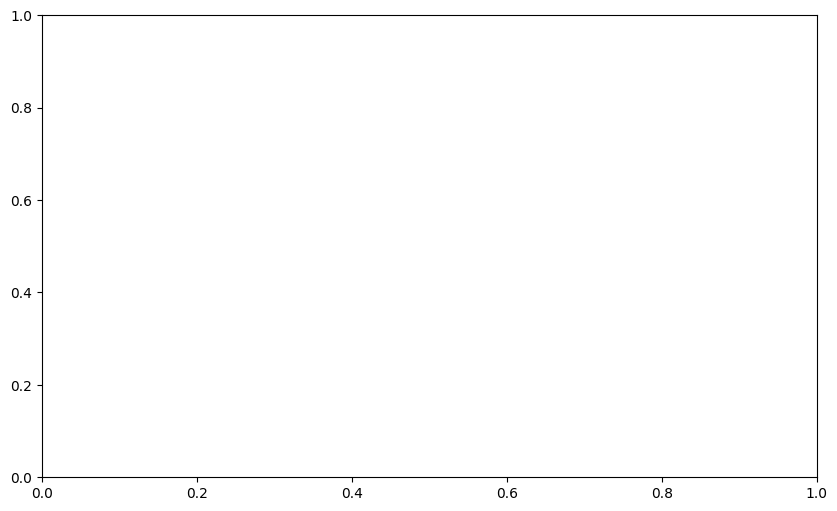

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as patches


## Function to plot normalised masks, bboxes and keypoints
def processedYYplotter(mask, bbox_i, kp):

    ## Plotting segmentation, bounding boxes, and keypoints
    fig = plt.figure(figsize=(10, 6))
    ax = fig.add_subplot(1, 1, 1)
    img = np.ones((128, 256, 3), dtype=np.uint8)*255.0


    for j in range(mask.shape[0]):

        ## Applying segmentation mask
        img[mask[j, :, :]==1] = (0, 255, 0)
        ## BBoxes
        x1, y1, x2, y2 = bbox_i[j, :4]
        width = x2 - x1
        height = y2 - y1
        rect = patches.Rectangle((x1, y1), width, height, linewidth=1, edgecolor='r', facecolor='none')
        ax.add_patch(rect)

        ## Plotting keypoints
        for connection in connections:
            x = kp[j, connection, 0]
            y = kp[j, connection, 1]
            ax.plot(x, y, color='b', marker='.')

    ax.imshow(img)
    ax.set_title('Segmentation, Bounding Boxes, and Keypoints (2D)')
    plt.show()


scaledKp, scaledBbox_i, scaledMask, angles = YY.iloc[110, :]
print(angles)
processedYYplotter(scaledMask, scaledBbox_i, scaledKp)

In [ ]:
scaledKp.shape

(1, 17, 3)

## 3. Model Fitting

In [ ]:
# import torch
# import torch.nn as nn

# class ConvLSTMCell(nn.Module):
#     def __init__(self, input_dim, hidden_dim, kernel_size, bias=True):
#         super(ConvLSTMCell, self).__init__()
#         self.input_dim = input_dim
#         self.hidden_dim = hidden_dim
#         self.kernel_size = kernel_size
#         self.padding = kernel_size[0] // 2, kernel_size[1] // 2
#         self.bias = bias

#         self.conv = nn.Conv2d(
#             in_channels=self.input_dim + self.hidden_dim,
#             out_channels=4 * self.hidden_dim,  # 4 for input, forget, cell, and output gates
#             kernel_size=self.kernel_size,
#             padding=self.padding,
#             bias=self.bias
#         )

#     def forward(self, input_tensor, cur_state):
#         h_cur, c_cur = cur_state

#         combined = torch.cat([input_tensor, h_cur], dim=1)  # Concatenate along channel axis
#         combined_conv = self.conv(combined)

#         cc_i, cc_f, cc_o, cc_g = torch.split(combined_conv, self.hidden_dim, dim=1)
#         i = torch.sigmoid(cc_i)
#         f = torch.sigmoid(cc_f)
#         o = torch.sigmoid(cc_o)
#         g = torch.tanh(cc_g)

#         c_next = f * c_cur + i * g
#         h_next = o * torch.tanh(c_next)

#         return h_next, c_next

#     def init_hidden(self, batch_size, image_size):
#         height, width = image_size
#         return (
#             torch.zeros(batch_size, self.hidden_dim, height, width, device=self.conv.weight.device),
#             torch.zeros(batch_size, self.hidden_dim, height, width, device=self.conv.weight.device)
#         )


# class ConvLSTM(nn.Module):
#     def __init__(self, input_dim, hidden_dim, kernel_size, num_layers, batch_first=False, bias=True):
#         super(ConvLSTM, self).__init__()
#         self.input_dim = input_dim
#         self.hidden_dim = hidden_dim
#         self.kernel_size = kernel_size
#         self.num_layers = num_layers
#         self.batch_first = batch_first
#         self.bias = bias

#         self.cell_list = nn.ModuleList()
#         for i in range(self.num_layers):
#             cur_input_dim = self.input_dim if i == 0 else self.hidden_dim
#             self.cell_list.append(ConvLSTMCell(
#                 input_dim=cur_input_dim,
#                 hidden_dim=self.hidden_dim,
#                 kernel_size=self.kernel_size,
#                 bias=self.bias
#             ))

#     def forward(self, input_tensor, hidden_state=None):
#         if not self.batch_first:
#             # (timesteps, batch, channels, height, width) -> (batch, timesteps, channels, height, width)
#             input_tensor = input_tensor.permute(1, 0, 2, 3, 4)

#         batch_size, timesteps, _, height, width = input_tensor.size()

#         if hidden_state is None:
#             hidden_state = self._init_hidden(batch_size, (height, width))

#         layer_output_list = []
#         last_state_list = []

#         cur_layer_input = input_tensor

#         for layer_idx in range(self.num_layers):
#             h, c = hidden_state[layer_idx]
#             output_inner = []
#             for t in range(timesteps):
#                 h, c = self.cell_list[layer_idx](input_tensor=cur_layer_input[:, t, :, :, :], cur_state=[h, c])
#                 output_inner.append(h)

#             layer_output = torch.stack(output_inner, dim=1)
#             cur_layer_input = layer_output

#             layer_output_list.append(layer_output)
#             last_state_list.append([h, c])

#         if not self.batch_first:
#             layer_output_list = [output.permute(1, 0, 2, 3, 4) for output in layer_output_list]

#         return layer_output_list, last_state_list

#     def _init_hidden(self, batch_size, image_size):
#         init_states = []
#         for i in range(self.num_layers):
#             init_states.append(self.cell_list[i].init_hidden(batch_size, image_size))
#         return init_states

In [ ]:
# import torch
# import torch.nn as nn
# import torchvision.models as models

# class MaskRegressorWithoutConvLSTM(nn.Module):
#     def __init__(self, pretrained=True):
#         super(MaskRegressorWithoutConvLSTM, self).__init__()

#         ## Loading the pretrained ResNet-50 model
#         resnet = models.resnet50(weights=pretrained)

#         ## Modify the first convolutional layer to accept 4 input channels (2 timesteps × 2 channels each)
#         resnet.conv1 = nn.Conv2d(4, 64, kernel_size=7, stride=2, padding=3, bias=False)

#         ## Encoder: ResNet-50 as backbone
#         self.encoder = nn.Sequential(
#             resnet.conv1,   # (64, H/2, W/2)
#             resnet.bn1,
#             resnet.relu,
#             resnet.maxpool, # (64, H/4, W/4)
#             resnet.layer1,  # (256, H/4, W/4)
#             resnet.layer2,  # (512, H/8, W/8)
#             resnet.layer3,  # (1024, H/16, W/16)
#             resnet.layer4   # (2048, H/32, W/32)
#         )

#         ## Decoder
#         self.decoder = nn.Sequential(
#             nn.ConvTranspose2d(2048, 1024, kernel_size=4, stride=2, padding=1, output_padding=0), ## (1024, H/16, W/16)
#             nn.BatchNorm2d(1024),
#             nn.ReLU(),
#             nn.Dropout(p=0.3),

#             nn.ConvTranspose2d(1024, 512, kernel_size=4, stride=2, padding=1, output_padding=0),  ## (512, H/8, W/8)
#             nn.BatchNorm2d(512),
#             nn.ReLU(),
#             nn.Dropout(p=0.3),

#             nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, output_padding=0),  ## (256, H/4, W/4)
#             nn.BatchNorm2d(256),
#             nn.ReLU(),
#             nn.Dropout(p=0.3),

#             nn.ConvTranspose2d(256, 64, kernel_size=4, stride=2, padding=1, output_padding=0),   ## (64, H/2, W/2)
#             nn.BatchNorm2d(64),
#             nn.ReLU(),
#             nn.Dropout(p=0.3),

#             nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1, output_padding=0),    ## (32, H, W)
#             nn.BatchNorm2d(32),
#             nn.ReLU(),
#             nn.Conv2d(32, 2, kernel_size=3, padding=1),  ## Output two masks for two timesteps (2, H, W)
#             nn.Sigmoid()
#         )

#     def forward(self, x):
#         # x shape = batch, timesteps, channels, height, width
#         batch_size, timesteps, C, H, W = x.size()

#         x = x.view(batch_size, timesteps * C, H, W)


#         x = self.encoder(x)  # Encoder output shape: (batch, 2048, H/32, W/32)
#         x = self.decoder(x)  # Decoder output shape: (batch, 2, H, W)


#         x = x.unsqueeze(2)

#         return x


In [ ]:
# import torch
# import torch.nn as nn
# import torchvision.models as models

# class MaskRegressorWithoutConvLSTM(nn.Module):
#     def __init__(self, pretrained=True):
#         super(MaskRegressorWithoutConvLSTM, self).__init__()

#         ## Loading the pretrained ResNet-50 model
#         resnet = models.resnet50(weights=pretrained)

#         ## Modify the first convolutional layer to accept 4 input channels (2 timesteps × 2 channels each)
#         resnet.conv1 = nn.Conv2d(4, 64, kernel_size=7, stride=2, padding=3, bias=False)

#         ## Encoder: ResNet-50 as backbone
#         self.encoder = nn.Sequential(
#             resnet.conv1,   # (64, H/2, W/2)
#             resnet.bn1,
#             resnet.relu,
#             resnet.maxpool, # (64, H/4, W/4)
#             resnet.layer1,  # (256, H/4, W/4)
#             resnet.layer2,  # (512, H/8, W/8)
#             resnet.layer3,  # (1024, H/16, W/16)
#             resnet.layer4   # (2048, H/32, W/32)
#         )

#         ## Decoder
#         self.decoder = nn.Sequential(
#             nn.ConvTranspose2d(2048, 1024, kernel_size=4, stride=2, padding=1, output_padding=0), ## (1024, H/16, W/16)
#             nn.BatchNorm2d(1024),
#             nn.ReLU(),
#             nn.Dropout(p=0.3),

#             nn.ConvTranspose2d(1024, 512, kernel_size=4, stride=2, padding=1, output_padding=0),  ## (512, H/8, W/8)
#             nn.BatchNorm2d(512),
#             nn.ReLU(),
#             nn.Dropout(p=0.3),

#             nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, output_padding=0),  ## (256, H/4, W/4)
#             nn.BatchNorm2d(256),
#             nn.ReLU(),
#             nn.Dropout(p=0.3),

#             nn.ConvTranspose2d(256, 64, kernel_size=4, stride=2, padding=1, output_padding=0),   ## (64, H/2, W/2)
#             nn.BatchNorm2d(64),
#             nn.ReLU(),
#             nn.Dropout(p=0.3),

#             nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1, output_padding=0),    ## (32, H, W)
#             nn.BatchNorm2d(32),
#             nn.ReLU(),
#             nn.Conv2d(32, 51, kernel_size=3, padding=1),
#             nn.Sigmoid()
#         )

#     def forward(self, x):
#         # x shape = batch, timesteps, channels, height, width
#         batch_size, timesteps, C, H, W = x.size()

#         x = x.view(batch_size, timesteps * C, H, W)


#         x = self.encoder(x)
#         x = self.decoder(x)
#         x = x.view(batch_size, timesteps, 1, 17, 3)

#         return x


In [ ]:
# import torch
# import torch.nn as nn
# import torchvision.models as models

# class MaskRegressorWithoutConvLSTM(nn.Module):
#     def __init__(self, pretrained=True, timesteps=2):
#         super(MaskRegressorWithoutConvLSTM, self).__init__()

#         self.timesteps = timesteps

#         ## Load the pretrained ResNet-50 model
#         resnet = models.resnet50(weights="IMAGENET1K_V1" if pretrained else None)

#         ## Modify the first convolutional layer to accept 4 input channels (2 timesteps × 2 channels each)
#         resnet.conv1 = nn.Conv2d(4, 64, kernel_size=7, stride=2, padding=3, bias=False)

#         ## Encoder: ResNet-50 as backbone
#         self.encoder = nn.Sequential(
#             resnet.conv1,   # (64, H/2, W/2)
#             resnet.bn1,
#             resnet.relu,
#             resnet.maxpool, # (64, H/4, W/4)
#             resnet.layer1,  # (256, H/4, W/4)
#             resnet.layer2,  # (512, H/8, W/8)
#             resnet.layer3,  # (1024, H/16, W/16)
#             resnet.layer4   # (2048, H/32, W/32)
#         )

#         ## Decoder: simple reduction + pooling
#         self.decoder = nn.Sequential(
#             nn.ConvTranspose2d(2048, 1024, kernel_size=4, stride=2, padding=1),
#             nn.BatchNorm2d(1024),
#             nn.ReLU(),
#             nn.Dropout(p=0.3),

#             nn.ConvTranspose2d(1024, 512, kernel_size=4, stride=2, padding=1),
#             nn.BatchNorm2d(512),
#             nn.ReLU(),
#             nn.Dropout(p=0.3),

#             nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1),
#             nn.BatchNorm2d(256),
#             nn.ReLU(),
#             nn.Dropout(p=0.3),

#             nn.AdaptiveAvgPool2d((1, 1)),  # Output becomes (batch_size, 256, 1, 1)
#         )

#         ## Final fully connected layer to predict 2 × 17 × 3 = 102 values
#         self.fc = nn.Linear(256, timesteps * 17 * 3)

#     def forward(self, x):
#         # Input shape: (batch_size, timesteps, channels, height, width)
#         batch_size, timesteps, C, H, W = x.size()

#         ## Flatten the timesteps and channels together
#         x = x.view(batch_size, timesteps * C, H, W)

#         ## Pass through encoder and decoder
#         x = self.encoder(x)
#         x = self.decoder(x)

#         ## Flatten and map to keypoints
#         x = x.view(batch_size, -1)  # (batch_size, 256)
#         x = self.fc(x)              # (batch_size, timesteps*17*3)

#         ## Reshape to (batch_size, timesteps, 1, 17, 3)
#         x = x.view(batch_size, self.timesteps, 1, 17, 3)

#         return x


## Custom MMPose

In [ ]:
import torch
import torch.nn as nn

class mmPose(nn.Module):
    def __init__(self):
        super(mmPose, self).__init__()

        # --- Encoder with residual connections and BatchNorm ---
        def encoder_block():
            return nn.Sequential(
                nn.Conv2d(2, 16, kernel_size=3, stride=1, padding=1),
                nn.BatchNorm2d(16),
                nn.LeakyReLU(0.01),
                nn.Dropout2d(p=0.2),

                nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
                nn.BatchNorm2d(32),
                nn.LeakyReLU(0.01),
                nn.Dropout2d(p=0.2),

                nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
                nn.BatchNorm2d(64),
                nn.LeakyReLU(0.01),
                nn.Dropout2d(p=0.2),
            )

        self.encoder1 = encoder_block()
        self.encoder2 = encoder_block()

        # --- Concatenation instead of addition ---
        self.conv = nn.Sequential(
            nn.Conv2d(128, 128, kernel_size=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.01),
        )

        # Smaller spatial pooling for reduced MLP size
        self.pool = nn.AdaptiveAvgPool2d((4, 4))
        self.flatten = nn.Flatten()

        # --- Efficient MLP with LayerNorm and GELU ---
        self.mlp = nn.Sequential(
            nn.Linear(128 * 4 * 4, 256),
            nn.LayerNorm(256),
            nn.GELU(),
            nn.Dropout(p=0.3),

            nn.Linear(256, 128),
            nn.LayerNorm(128),
            nn.GELU(),
            nn.Dropout(p=0.3),

            nn.Linear(128, 102),  # 2 * 17 * 3
        )

    def forward(self, x, y):
        batchSize = x.size(0)

        x = self.encoder1(x)
        y = self.encoder2(y)

        # Concatenate along channel axis
        merged = torch.cat([x, y], dim=1)

        features = self.conv(merged)
        pooled = self.pool(features)
        flat = self.flatten(pooled)
        output = self.mlp(flat)

        return output.view(batchSize, 2, 17, 3)

##mmPose

In [ ]:
import torch
import torch.nn as nn

class mmPose(nn.Module):
    def __init__(self):
        super(mmPose, self).__init__()

        self.encoder1 = nn.Sequential(
            nn.Conv2d(2, 16, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.Dropout2d(p=0.2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.Dropout2d(p=0.2),
            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.Dropout2d(p=0.2),
        )

        self.encoder2 = nn.Sequential(
            nn.Conv2d(2, 16, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.Dropout2d(p=0.2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.Dropout2d(p=0.2),
            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.Dropout2d(p=0.2),
        )

        self.conv = nn.Sequential(
            nn.Conv2d(64, 128, kernel_size=1),
            nn.ReLU(),
        )


        self.flatten = nn.Flatten()

        self.mlp = nn.Sequential(
            nn.Linear(32768, 512),
            nn.ReLU(),
            nn.Dropout(p=0.3),
            nn.Linear(512, 256),
            nn.ReLU(),
            nn.Dropout(p=0.3),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.Dropout(p=0.3),
            nn.Linear(128, 102),
        )

    def forward(self, x, y):
        batchSize = x.size(0)
        x = self.encoder1(x)
        y = self.encoder2(y)
        addedOut = x + y
        conCat = self.conv(addedOut)
        flatten = self.flatten(conCat)
        output = self.mlp(flatten)
        output = output.view(batchSize, 2, 17, 3)
        return output

##RFPose

In [ ]:
import torch
import torch.nn as nn
import numpy as np  # for extract_keypoints

class RFpose(nn.Module):
    def __init__(self):
        super(RFpose, self).__init__()

        self.horiEncoder = nn.Sequential(
            nn.Conv3d(1, 75, kernel_size=(9, 5, 5), stride=(1, 2, 2), padding=(0, 2, 2)),
            nn.BatchNorm3d(75),
            nn.ReLU(),

            nn.Conv3d(75, 67, kernel_size=(9, 5, 5), stride=(1, 1, 1), padding=(0, 2, 2)),
            nn.BatchNorm3d(67),
            nn.ReLU(),

            nn.Conv3d(67, 59, kernel_size=(9, 5, 5), stride=(1, 2, 2), padding=(0, 2, 2)),
            nn.BatchNorm3d(59),
            nn.ReLU(),

            nn.Conv3d(59, 51, kernel_size=(9, 5, 5), stride=(1, 1, 1), padding=(0, 2, 2)),
            nn.BatchNorm3d(51),
            nn.ReLU(),

            nn.Conv3d(51, 43, kernel_size=(9, 5, 5), stride=(1, 2, 2), padding=(0, 2, 2)),
            nn.BatchNorm3d(43),
            nn.ReLU(),

            nn.Conv3d(43, 35, kernel_size=(9, 5, 5), stride=(1, 1, 1), padding=(0, 2, 2)),
            nn.BatchNorm3d(35),
            nn.ReLU(),

            nn.Conv3d(35, 27, kernel_size=(9, 5, 5), stride=(1, 2, 2), padding=(0, 2, 2)),
            nn.BatchNorm3d(27),
            nn.ReLU(),

            nn.Conv3d(27, 19, kernel_size=(9, 5, 5), stride=(1, 1, 1), padding=(0, 2, 2)),
            nn.BatchNorm3d(19),
            nn.ReLU(),

            nn.Conv3d(19, 11, kernel_size=(9, 5, 5), stride=(1, 2, 2), padding=(0, 2, 2)),
            nn.BatchNorm3d(11),
            nn.ReLU(),

            nn.Conv3d(11, 3, kernel_size=(9, 5, 5), stride=(1, 1, 1), padding=(0, 2, 2)),
            nn.BatchNorm3d(3),
            nn.ReLU(),
        )

        self.vertEncoder = nn.Sequential(
            nn.Conv3d(1, 75, kernel_size=(9, 5, 5), stride=(1, 2, 2), padding=(0, 2, 2)),
            nn.BatchNorm3d(75),
            nn.ReLU(),

            nn.Conv3d(75, 67, kernel_size=(9, 5, 5), stride=(1, 1, 1), padding=(0, 2, 2)),
            nn.BatchNorm3d(67),
            nn.ReLU(),

            nn.Conv3d(67, 59, kernel_size=(9, 5, 5), stride=(1, 2, 2), padding=(0, 2, 2)),
            nn.BatchNorm3d(59),
            nn.ReLU(),

            nn.Conv3d(59, 51, kernel_size=(9, 5, 5), stride=(1, 1, 1), padding=(0, 2, 2)),
            nn.BatchNorm3d(51),
            nn.ReLU(),

            nn.Conv3d(51, 43, kernel_size=(9, 5, 5), stride=(1, 2, 2), padding=(0, 2, 2)),
            nn.BatchNorm3d(43),
            nn.ReLU(),

            nn.Conv3d(43, 35, kernel_size=(9, 5, 5), stride=(1, 1, 1), padding=(0, 2, 2)),
            nn.BatchNorm3d(35),
            nn.ReLU(),

            nn.Conv3d(35, 27, kernel_size=(9, 5, 5), stride=(1, 2, 2), padding=(0, 2, 2)),
            nn.BatchNorm3d(27),
            nn.ReLU(),

            nn.Conv3d(27, 19, kernel_size=(9, 5, 5), stride=(1, 1, 1), padding=(0, 2, 2)),
            nn.BatchNorm3d(19),
            nn.ReLU(),

            nn.Conv3d(19, 11, kernel_size=(9, 5, 5), stride=(1, 2, 2), padding=(0, 2, 2)),
            nn.BatchNorm3d(11),
            nn.ReLU(),

            nn.Conv3d(11, 3, kernel_size=(9, 5, 5), stride=(1, 1, 1), padding=(0, 2, 2)),
            nn.BatchNorm3d(3),
            nn.ReLU(),
        )

        self.decoder = nn.Sequential(
            nn.ConvTranspose3d(3, 16, kernel_size=(3, 6, 6), stride=(1, 2, 2)),
            nn.PReLU(),

            nn.ConvTranspose3d(16, 32, kernel_size=(3, 6, 6), stride=(1, 2, 2)),
            nn.PReLU(),

            nn.ConvTranspose3d(32, 16, kernel_size=(3, 6, 6), stride=(1, 4, 4), padding=(1, 1, 1)),
            nn.PReLU(),

            nn.ConvTranspose3d(16, 17, kernel_size=(3, 6, 6), stride=(1, 1, 1), padding=(1, 2, 2)),
            nn.Sigmoid(),
        )

    def forward(self, x, y):
        x = self.horiEncoder(x)
        y = self.vertEncoder(y)
        conCat = x + y
        output = self.decoder(conCat)
        return output

    def extract_keypoints(self, heatmaps):
        batch_size, num_kps, depth, H, W = heatmaps.shape
        ConfidenceKey = torch.zeros(batch_size * depth, num_kps, 3)
        for b in range(batch_size):
            for d in range(depth):
                for c in range(num_kps):
                    heatmap = heatmaps[b, c, d, :, :].detach().cpu()
                    peakMap = localPeak(heatmap).numpy()  # Make sure you define localPeak somewhere
                    out = np.argmax(peakMap)
                    x, y = divmod(out.item(), W)
                    conf = peakMap[y, x].item()
                    idx = b * depth + d
                    ConfidenceKey[idx, c, 0] = x
                    ConfidenceKey[idx, c, 1] = y
                    ConfidenceKey[idx, c, 2] = conf

        kps = np.zeros((num_kps, 3))
        for i in range(num_kps):
            kps[i, 0] = torch.mean(ConfidenceKey[:, i, 0]).item()
            kps[i, 1] = torch.mean(ConfidenceKey[:, i, 1]).item()
            kps[i, 2] = torch.mean(ConfidenceKey[:, i, 2]).item()

        return kps


In [ ]:
from torchsummary import summary
import torch


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


model = mmPose().to(device)

summary(model, input_size=[(2, 16, 16), (2, 16, 16)], batch_size=32)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [32, 16, 16, 16]             304
       BatchNorm2d-2           [32, 16, 16, 16]              32
         LeakyReLU-3           [32, 16, 16, 16]               0
         Dropout2d-4           [32, 16, 16, 16]               0
            Conv2d-5           [32, 32, 16, 16]           4,640
       BatchNorm2d-6           [32, 32, 16, 16]              64
         LeakyReLU-7           [32, 32, 16, 16]               0
         Dropout2d-8           [32, 32, 16, 16]               0
            Conv2d-9           [32, 64, 16, 16]          18,496
      BatchNorm2d-10           [32, 64, 16, 16]             128
        LeakyReLU-11           [32, 64, 16, 16]               0
        Dropout2d-12           [32, 64, 16, 16]               0
           Conv2d-13           [32, 16, 16, 16]             304
      BatchNorm2d-14           [32, 16,

##Model fitting RF-pose

In [ ]:
from torch.utils import DataLoader, TensorDataset


horiTensorRF = torch.from_numpy(df['filled_hori']).float





## Model fiiting custom mmPose

In [ ]:
def computeAngleBatchTorch(connect, j, kp_batch):
    idx = jointDict[connect]
    num = [revJointDict[k] for k in angleTriplets[idx]]

    a = kp_batch[:, num[0], :2]
    b = kp_batch[:, num[1], :2]
    c = kp_batch[:, num[2], :2]

    ba = a - b
    bc = c - b

    ba_norm = ba / (ba.norm(dim=1, keepdim=True).clamp_min(1e-8))
    bc_norm = bc / (bc.norm(dim=1, keepdim=True).clamp_min(1e-8))

    cos_angle = (ba_norm * bc_norm).sum(dim=1)

    cos_angle = cos_angle.clamp(-1 + 1e-7, 1 - 1e-7)


    angle = torch.acos(cos_angle)
    angle = torch.where(torch.isnan(angle), torch.zeros_like(angle), angle)

    angle_deg = angle * (180.0 / torch.pi)

    return (connect, angle_deg)

In [ ]:
# def computeAngleBatchTorch(connect, j, kp_batch):
#     idx = jointDict[connect]
#     num = [revJointDict[k] for k in angleTriplets[idx]]

#     a = kp_batch[:, num[0], :2]
#     b = kp_batch[:, num[1], :2]
#     c = kp_batch[:, num[2], :2]

#     ba = a - b
#     bc = c - b

#     # Normalize
#     ba_norm = ba / (ba.norm(dim=1, keepdim=True).clamp_min(1e-8))
#     bc_norm = bc / (bc.norm(dim=1, keepdim=True).clamp_min(1e-8))

#     # Dot and cross product
#     dot = (ba_norm * bc_norm).sum(dim=1)
#     cross = ba_norm[:, 0] * bc_norm[:, 1] - ba_norm[:, 1] * bc_norm[:, 0]

#     angle_rad = torch.atan2(cross, dot)
#     angle_deg = torch.rad2deg(angle_rad) % 360  # ensures angle is [0, 360)

#     return (connect, angle_deg)


In [ ]:
def modelAngle(kp_batch):
    """
    kp_batch: [batch_size, 2, 17, 3]  (batch, frames, keypoints, coords)
    returns: [batch_size, num_angles * 2] tensor of stacked angles from both frames
    """
    batch_size = kp_batch.shape[0]
    num_frames = kp_batch.shape[1]

    all_angles = []
    all_joints = []

    for frame in range(num_frames):
        kp_frame = kp_batch[:, frame, :, :]
        angles_for_frame = []
        jointNames = []

        seen_joints = set()

        for connection in connections:
            if jointDict[connection[0]] in angleTriplets:
                joint_name = connection[0]
                if joint_name not in seen_joints:
                    connect, angle_tensor = computeAngleBatchTorch(joint_name, batch_size, kp_frame)
                    angles_for_frame.append(angle_tensor.unsqueeze(1))
                    jointNames.append(connect)
                    seen_joints.add(joint_name)

        angles_for_frame_tensor = torch.cat(angles_for_frame, dim=1)
        all_angles.append(angles_for_frame_tensor)
        all_joints.extend(jointNames)

    stacked_angles = torch.cat(all_angles, dim=1)

    return (all_joints, stacked_angles)

## Loss function RF-pose

In [ ]:
import numpy as np
import torch

class RFposeLoss(nn.Module):
    def __init__(self):
        super(CustomLoss, self).__init__()
    Loss = 0.0
    def forward(self, teacherMap, studentMap):
        for c in range(teacherMap.shape[2]):
          Loss += - (np.dot(studentMap[:,:, c, :, :], np.log(teacherMap[:,:, c, :, :])) + np.dot((1- studentMap[:,:, c, :, :]), np.log(1-teacherMap[:,:, c, :, :])))
        return Loss

## Loss function (Custom)

In [ ]:
class CustomLoss(nn.Module):
    def __init__(self, lambda_angle = 0.001):
        super(CustomLoss, self).__init__()
        self.mse = nn.MSELoss()
        # self.gamma = gamma
        self.lambda_angle = lambda_angle

    def forward(self, outputs, targets, modelAngle):
        mse_loss = self.mse(outputs, targets)

        jointNamesTar, angles_true = modelAngle(targets)
        jointNamesPred, angles_pred = modelAngle(outputs)

        # Make sure the joint names match
        angle_errors = []

        for jt, at, jp, ap in zip(jointNamesTar, angles_true.T, jointNamesPred, angles_pred.T):
            if jt == jp:
                angle_errors.append(self.mse(ap, at))

        if angle_errors:
            angle_loss = sum(angle_errors) / len(angle_errors)
        else:
            angle_loss = 0.0

        return (1.0 - self.lambda_angle) * mse_loss + self.lambda_angle * angle_loss

## Jumping data tensor

In [ ]:
from torch.utils.data import DataLoader, TensorDataset, random_split
import torch.optim as optim

## for jumping data
horiTensorJump = torch.from_numpy(stack_horiJump).float()
vertTensorJump = torch.from_numpy(stack_vertJump).float()
kpTensorJump = torch.from_numpy(kpStackJump).float()


## Creating a full tensor data
datasetJump = TensorDataset(horiTensorJump, vertTensorJump, kpTensorJump)


jumpData = DataLoader(datasetJump, batch_size=32, shuffle=True)

In [ ]:
from torch.utils.data import DataLoader, TensorDataset, random_split
import torch.optim as optim

batch_size = 32
num_epochs = 45
lr = 0.001

# Convert numpy arrays to tensors
horiTensor = torch.from_numpy(stack_hori).float()
vertTensor = torch.from_numpy(stack_vert).float()
kpTensor = torch.from_numpy(kpStack).float()


## Creating a full tensor data
dataset = TensorDataset(horiTensor, vertTensor, kpTensor)

## Shuffling the dataset and split into train, test, validation
total_size = len(dataset)
train_size = int(0.7 * total_size)
val_size = int(0.2 * total_size)
test_size = total_size - train_size - val_size

train_dataset, val_dataset, test_dataset = random_split(dataset, [train_size, val_size, test_size])

## Creating DataLoaders
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = mmPose().to(device)
lossFunction = CustomLoss(lambda_angle=0.5)

criterion = nn.MSELoss()


optimizer = optim.Adam(model.parameters(), lr)

scheduler = optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.5,
    patience=2,
    verbose=True
)


train_losses = []
val_losses = []

# for epoch in range(num_epochs):
#     model.train()
#     epoch_train_loss = 0.0

#     for hori_inputs, vert_inputs, targets in train_loader:
#         hori_inputs = hori_inputs.to(device)
#         vert_inputs = vert_inputs.to(device)
#         targets = targets.to(device)

#         optimizer.zero_grad()

#         # outputs = model(hori_inputs, vert_inputs)

#         # loss = lossFunction(outputs, targets, modelAngle)

#         # if torch.isnan(loss) or torch.isinf(loss):
#         #   print("NaN or Inf detected in loss!")
#         #   print("Outputs:", outputs)
#         #   print("Targets:", targets)
#         #   break  # or raise error to stop training

#         # with torch.autograd.detect_anomaly():
#         outputs = model(hori_inputs, vert_inputs)
#         loss = lossFunction(outputs, targets, modelAngle)
#         loss.backward()

#         # torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)


#         optimizer.step()

#         epoch_train_loss += loss.item()

#     epoch_train_loss /= len(train_loader)
#     train_losses.append(epoch_train_loss)

#     model.eval()
#     epoch_val_loss = 0.0

#     with torch.no_grad():
#         for hori_inputs, vert_inputs, targets in val_loader:
#             hori_inputs = hori_inputs.to(device)
#             vert_inputs = vert_inputs.to(device)
#             targets = targets.to(device)

#             outputs = model(hori_inputs, vert_inputs)

#             loss = lossFunction(outputs, targets,  modelAngle)

#             epoch_val_loss += loss.item()

#     epoch_val_loss /= len(val_loader)
#     val_losses.append(epoch_val_loss)

#     print(f"Epoch [{epoch + 1}/{num_epochs}], Train Loss: {epoch_train_loss:.4f}, Val Loss: {epoch_val_loss:.4f}")

#     scheduler.step(epoch_val_loss)


best_val_loss = float('inf')
best_model_path = 'mmpose.pth'

for epoch in range(num_epochs):
    model.train()
    epoch_train_loss = 0.0

    for hori_inputs, vert_inputs, targets in train_loader:
        hori_inputs = hori_inputs.to(device)
        vert_inputs = vert_inputs.to(device)
        targets = targets.to(device)

        optimizer.zero_grad()
        outputs = model(hori_inputs, vert_inputs)
        loss = lossFunction(outputs, targets, modelAngle)
        # loss = criterion(outputs, targets)
        loss.backward()
        optimizer.step()

        epoch_train_loss += loss.item()

    epoch_train_loss /= len(train_loader)
    train_losses.append(epoch_train_loss)

    # Validation
    model.eval()
    epoch_val_loss = 0.0
    with torch.no_grad():
        for hori_inputs, vert_inputs, targets in val_loader:
            hori_inputs = hori_inputs.to(device)
            vert_inputs = vert_inputs.to(device)
            targets = targets.to(device)

            outputs = model(hori_inputs, vert_inputs)
            # loss = lossFunction(outputs, targets, modelAngle)
            loss = criterion(outputs, targets)
            epoch_val_loss += loss.item()

    epoch_val_loss /= len(val_loader)
    val_losses.append(epoch_val_loss)

    print(f"Epoch [{epoch + 1}/{num_epochs}], Train Loss: {epoch_train_loss:.4f}, Val Loss: {epoch_val_loss:.4f}")

    # # Checking for improvement and saving weights
    # if epoch_val_loss < best_val_loss:
    #     best_val_loss = epoch_val_loss
    #     torch.save(model.state_dict(), best_model_path)
    #     print(f"New best model saved at epoch {epoch + 1} with val loss {best_val_loss:.4f}")

    # scheduler.step(epoch_val_loss)

/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Epoch [1/45], Train Loss: 248.7176, Val Loss: 37.7260
Epoch [2/45], Train Loss: 171.4287, Val Loss: 34.3917
Epoch [3/45], Train Loss: 165.6987, Val Loss: 29.6448
Epoch [4/45], Train Loss: 162.0576, Val Loss: 24.2124
Epoch [5/45], Train Loss: 158.6236, Val Loss: 19.1675
Epoch [6/45], Train Loss: 155.7106, Val Loss: 15.6797
Epoch [7/45], Train Loss: 153.8423, Val Loss: 13.2488
Epoch [8/45], Train Loss: 151.9029, Val Loss: 11.5228
Epoch [9/45], Train Loss: 150.6211, Val Loss: 10.2303
Epoch [10/45], Train Loss: 149.3674, Val Loss: 9.0147
Epoch [11/45], Train Loss: 148.4411, Val Loss: 8.5296
Epoch [12/45], Train Loss: 147.3240, Val Loss: 7.7413
Epoch [13/45], Train Loss: 146.7088, Val Loss: 7.3759
Epoch [14/45], Train Loss: 145.5445, Val Loss: 7.0411
Epoch [15/45], Train Loss: 144.7038, Val Loss: 6.7550
Epoch [16/45], Train Loss: 144.2636, Val Loss: 6.5510
Epoch [17/45], Train Loss: 143.0774, Val Loss: 6.4426
Epoch [18/45], Train Loss: 141.8663, Val Loss: 6.3561
Epoch [19/45], Train Loss: 1

In [ ]:
from torch.utils.data import DataLoader, TensorDataset, Subset
from sklearn.model_selection import KFold
import torch.optim as optim
import torch.nn as nn
import torch

# Hyperparameters
batch_size = 32
num_epochs = 45
lr = 0.001
k_folds = 10

# Convert numpy arrays to tensors
horiTensor = torch.from_numpy(stack_hori).float()
vertTensor = torch.from_numpy(stack_vert).float()
kpTensor = torch.from_numpy(kpStack).float()

# Full dataset
dataset = TensorDataset(horiTensor, vertTensor, kpTensor)

# Device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# K-Fold Cross Validator
kfold = KFold(n_splits=k_folds, shuffle=True)

fold_results = {}

for fold, (train_ids, val_ids) in enumerate(kfold.split(dataset)):
    print(f"\n🔁 Fold {fold + 1}/{k_folds}")

    # Data loaders for this fold
    train_subset = Subset(dataset, train_ids)
    val_subset = Subset(dataset, val_ids)

    train_loader = DataLoader(train_subset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_subset, batch_size=batch_size, shuffle=False)

    # Fresh model, loss, optimizer per fold
    model = mmPose().to(device)
    criterion = nn.MSELoss()  # or use CustomLoss if preferred
    optimizer = optim.Adam(model.parameters(), lr=lr)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2, verbose=True)

    train_losses = []
    val_losses = []

    best_val_loss = float('inf')
    best_model_path = f'mmpose_fold{fold + 1}.pth'

    for epoch in range(num_epochs):
        model.train()
        epoch_train_loss = 0.0

        for hori_inputs, vert_inputs, targets in train_loader:
            hori_inputs = hori_inputs.to(device)
            vert_inputs = vert_inputs.to(device)
            targets = targets.to(device)

            optimizer.zero_grad()
            outputs = model(hori_inputs, vert_inputs)
            # loss = lossFunction(outputs, targets, modelAngle)
            loss = criterion(outputs, targets)
            loss.backward()
            optimizer.step()

            epoch_train_loss += loss.item()

        epoch_train_loss /= len(train_loader)
        train_losses.append(epoch_train_loss)

        model.eval()
        epoch_val_loss = 0.0

        with torch.no_grad():
            for hori_inputs, vert_inputs, targets in val_loader:
                hori_inputs = hori_inputs.to(device)
                vert_inputs = vert_inputs.to(device)
                targets = targets.to(device)

                outputs = model(hori_inputs, vert_inputs)
                loss = criterion(outputs, targets)
                epoch_val_loss += loss.item()

        epoch_val_loss /= len(val_loader)
        val_losses.append(epoch_val_loss)

        print(f"Epoch [{epoch + 1}/{num_epochs}] | Train Loss: {epoch_train_loss:.4f} | Val Loss: {epoch_val_loss:.4f}")
        scheduler.step(epoch_val_loss)

        # Save best model for this fold
        if epoch_val_loss < best_val_loss:
            best_val_loss = epoch_val_loss
            torch.save(model.state_dict(), best_model_path)
            print(f"✅ Best model saved at epoch {epoch + 1} (val loss: {best_val_loss:.4f})")

    # Store best result of this fold
    fold_results[f"Fold {fold + 1}"] = best_val_loss

# Final summary
print("\n📊 K-Fold Cross-Validation Results:")
for fold, loss in fold_results.items():
    print(f"{fold}: Best Val Loss = {loss:.4f}")

avg_loss = sum(fold_results.values()) / k_folds
print(f"\n🔚 Average Best Val Loss Across Folds: {avg_loss:.4f}")



🔁 Fold 1/10


/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Epoch [1/45] | Train Loss: 2.7910 | Val Loss: 0.4496
✅ Best model saved at epoch 1 (val loss: 0.4496)
Epoch [2/45] | Train Loss: 1.0645 | Val Loss: 0.3351
✅ Best model saved at epoch 2 (val loss: 0.3351)
Epoch [3/45] | Train Loss: 0.7424 | Val Loss: 0.3652
Epoch [4/45] | Train Loss: 0.6323 | Val Loss: 0.2761
✅ Best model saved at epoch 4 (val loss: 0.2761)
Epoch [5/45] | Train Loss: 0.5743 | Val Loss: 0.2592
✅ Best model saved at epoch 5 (val loss: 0.2592)
Epoch [6/45] | Train Loss: 0.5371 | Val Loss: 0.2390
✅ Best model saved at epoch 6 (val loss: 0.2390)
Epoch [7/45] | Train Loss: 0.4988 | Val Loss: 0.2407
Epoch [8/45] | Train Loss: 0.4745 | Val Loss: 0.2661
Epoch [9/45] | Train Loss: 0.4563 | Val Loss: 0.2349
✅ Best model saved at epoch 9 (val loss: 0.2349)
Epoch [10/45] | Train Loss: 0.4369 | Val Loss: 0.2260
✅ Best model saved at epoch 10 (val loss: 0.2260)
Epoch [11/45] | Train Loss: 0.4250 | Val Loss: 0.2289
Epoch [12/45] | Train Loss: 0.4110 | Val Loss: 0.2192
✅ Best model save

In [ ]:
print([train_size, val_size, test_size])

[24504, 7001, 3502]


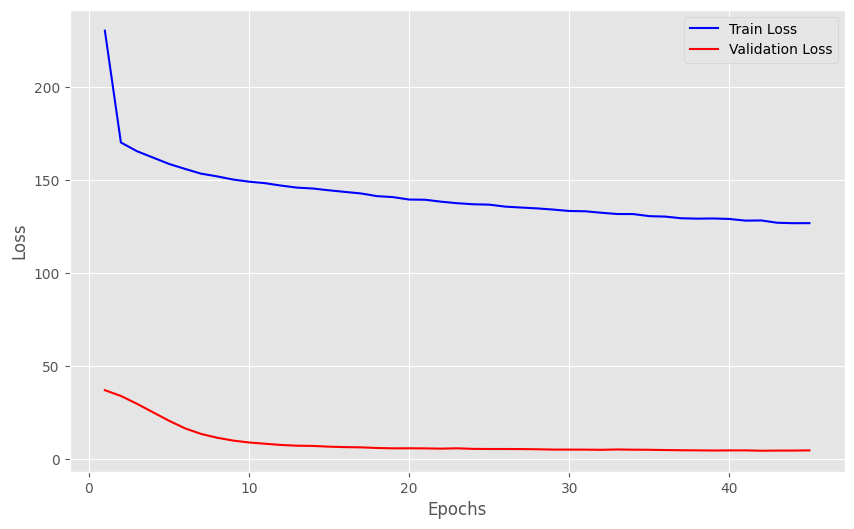

In [ ]:
import matplotlib.pyplot as plt

plt.style.use('ggplot')

plt.figure(figsize=(10, 6))
plt.plot(range(1, num_epochs + 1), train_losses, label='Train Loss', color='blue')
plt.plot(range(1, num_epochs + 1), val_losses, label='Validation Loss', color='red')
plt.xlabel('Epochs')
plt.ylabel('Loss')
# plt.title('Train and Validation Loss over Epochs')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
# def compute_mpjpe(pred, target):
#     error_x = torch.abs(pred[..., 0] - target[..., 0]).mean().item()
#     error_y = torch.abs(pred[..., 1] - target[..., 1]).mean().item()
#     error_z = torch.abs(pred[..., 2] - target[..., 2]).mean().item()

#     print(f"MPJPE X: {error_x:.4f}")
#     print(f"MPJPE Y: {error_y:.4f}")
#     print(f"MPJPE Z: {error_z:.4f}")

#     return error_x, error_y, error_z


## Getting errors for training data

In [ ]:
model.eval()

mpjpe_x_per_joint = []
mpjpe_y_per_joint = []
mpjpe_z_per_joint = []
angle_error_per_jointall = []

with torch.no_grad():
    for idx, (hori_inputs, vert_inputs, targets) in enumerate(train_loader):
        hori_inputs = hori_inputs.to(device)
        vert_inputs = vert_inputs.to(device)
        targets = targets.to(device)

        pred_kp = model(hori_inputs, vert_inputs)

        jointNamesTarget, angles_true = modelAngle(targets)
        jointNamesPred, angles_pred = modelAngle(pred_kp)
        assert jointNamesTarget == jointNamesPred, "Joint order mismatch!"


        angle_error_batch = torch.abs(angles_pred - angles_true).mean(dim=0)

        # Collect (joint_name, angle_error) for this batch
        angle_errors_named = list(zip(jointNamesTarget, angle_error_batch.cpu().numpy()))
        angle_error_per_jointall.extend(angle_errors_named)

        error_x_batch = torch.abs(pred_kp[..., 0] - targets[..., 0]).mean(dim=0)
        error_y_batch = torch.abs(pred_kp[..., 1] - targets[..., 1]).mean(dim=0)
        error_z_batch = torch.abs(pred_kp[..., 2] - targets[..., 2]).mean(dim=0)

        mpjpe_x_per_joint.append(error_x_batch.cpu())
        mpjpe_y_per_joint.append(error_y_batch.cpu())
        mpjpe_z_per_joint.append(error_z_batch.cpu())

In [ ]:
# print(len(angle_error_per_jointall))
average_mpjpe_x = sum(mpjpe_x_per_joint) / len(mpjpe_x_per_joint)
average_mpjpe_y = sum(mpjpe_y_per_joint) / len(mpjpe_y_per_joint)
average_mpjpe_z = sum(mpjpe_z_per_joint) / len(mpjpe_z_per_joint)

print("Errors for train:")
print(f"Average MPJPE X: {average_mpjpe_x.mean().item():.4f}")
print(f"Average MPJPE Y: {average_mpjpe_y.mean().item():.4f}")
print(f"Average MPJPE Z: {average_mpjpe_z.mean().item():.4f}")



Errors for train:
Average MPJPE X: 2.0258
Average MPJPE Y: 1.7231
Average MPJPE Z: 0.0056


In [ ]:
from collections import defaultdict
import numpy as np

joint_angle_errors = defaultdict(list)

for joint, error in angle_error_per_jointall:
    joint_angle_errors[joint].append(error)

avg_angle_error_per_joint = {joint: np.mean(errors) for joint, errors in joint_angle_errors.items()}

for joint, avg_err in avg_angle_error_per_joint.items():
    print(f"Joint: {jointDict[joint]}, Avg Angle Error: {avg_err:.4f}")

Joint: Left Knee, Avg Angle Error: 9.7848
Joint: Left Hip, Avg Angle Error: 3.8145
Joint: Right Knee, Avg Angle Error: 9.5784
Joint: Right Hip, Avg Angle Error: 3.8279
Joint: Left Shoulder, Avg Angle Error: 6.1010
Joint: Right Shoulder, Avg Angle Error: 5.0509
Joint: Left Elbow, Avg Angle Error: 15.4479
Joint: Right Elbow, Avg Angle Error: 13.3130


## MPJE and Angle error: Validation

In [ ]:
model.eval()

mpjpe_x_per_joint = []
mpjpe_y_per_joint = []
mpjpe_z_per_joint = []
angle_error_per_jointall = []

with torch.no_grad():
    for idx, (hori_inputs, vert_inputs, targets) in enumerate(val_loader):
        hori_inputs = hori_inputs.to(device)
        vert_inputs = vert_inputs.to(device)
        targets = targets.to(device)

        pred_kp = model(hori_inputs, vert_inputs)

        jointNamesTarget, angles_true = modelAngle(targets)
        jointNamesPred, angles_pred = modelAngle(pred_kp)
        assert jointNamesTarget == jointNamesPred, "Joint order mismatch!"


        angle_error_batch = torch.abs(angles_pred - angles_true).mean(dim=0)


        angle_errors_named = list(zip(jointNamesTarget, angle_error_batch.cpu().numpy()))
        angle_error_per_jointall.extend(angle_errors_named)

        error_x_batch = torch.abs(pred_kp[..., 0] - targets[..., 0]).mean(dim=0)
        error_y_batch = torch.abs(pred_kp[..., 1] - targets[..., 1]).mean(dim=0)
        error_z_batch = torch.abs(pred_kp[..., 2] - targets[..., 2]).mean(dim=0)

        mpjpe_x_per_joint.append(error_x_batch.cpu())
        mpjpe_y_per_joint.append(error_y_batch.cpu())
        mpjpe_z_per_joint.append(error_z_batch.cpu())

In [ ]:
# print(len(angle_error_per_jointall))
average_mpjpe_x = sum(mpjpe_x_per_joint) / len(mpjpe_x_per_joint)
average_mpjpe_y = sum(mpjpe_y_per_joint) / len(mpjpe_y_per_joint)
average_mpjpe_z = sum(mpjpe_z_per_joint) / len(mpjpe_z_per_joint)

print("Errors for validation:")
print(f"Average MPJPE X: {average_mpjpe_x.mean().item():.4f}")
print(f"Average MPJPE Y: {average_mpjpe_y.mean().item():.4f}")
print(f"Average MPJPE Z: {average_mpjpe_z.mean().item():.4f}")



from collections import defaultdict
import numpy as np

joint_angle_errors = defaultdict(list)

for joint, error in angle_error_per_jointall:
    joint_angle_errors[joint].append(error)

avg_angle_error_per_joint = {joint: np.mean(errors) for joint, errors in joint_angle_errors.items()}

for joint, avg_err in avg_angle_error_per_joint.items():
    print(f"Joint: {jointDict[joint]}, Avg Angle Error: {avg_err:.4f}")

Errors for validation:
Average MPJPE X: 0.2509
Average MPJPE Y: 0.1632
Average MPJPE Z: 0.0036
Joint: Left Knee, Avg Angle Error: 10.4907
Joint: Left Hip, Avg Angle Error: 4.3766
Joint: Right Knee, Avg Angle Error: 10.3566
Joint: Right Hip, Avg Angle Error: 4.4902
Joint: Left Shoulder, Avg Angle Error: 7.0529
Joint: Right Shoulder, Avg Angle Error: 6.0116
Joint: Left Elbow, Avg Angle Error: 16.3599
Joint: Right Elbow, Avg Angle Error: 13.2935


## MPJE and Angle Error: test

In [ ]:
model.eval()

mpjpe_x_per_joint = []
mpjpe_y_per_joint = []
mpjpe_z_per_joint = []
angle_error_per_jointall = []

with torch.no_grad():
    for idx, (hori_inputs, vert_inputs, targets) in enumerate(test_loader):
        hori_inputs = hori_inputs.to(device)
        vert_inputs = vert_inputs.to(device)
        targets = targets.to(device)

        pred_kp = model(hori_inputs, vert_inputs)

        jointNamesTarget, angles_true = modelAngle(targets)
        jointNamesPred, angles_pred = modelAngle(pred_kp)
        assert jointNamesTarget == jointNamesPred, "Joint order mismatch!"


        angle_error_batch = torch.abs(angles_pred - angles_true).mean(dim=0)


        angle_errors_named = list(zip(jointNamesTarget, angle_error_batch.cpu().numpy()))
        angle_error_per_jointall.extend(angle_errors_named)

        error_x_batch = torch.abs(pred_kp[..., 0] - targets[..., 0]).mean(dim=0)
        error_y_batch = torch.abs(pred_kp[..., 1] - targets[..., 1]).mean(dim=0)
        error_z_batch = torch.abs(pred_kp[..., 2] - targets[..., 2]).mean(dim=0)

        mpjpe_x_per_joint.append(error_x_batch.cpu())
        mpjpe_y_per_joint.append(error_y_batch.cpu())
        mpjpe_z_per_joint.append(error_z_batch.cpu())

In [ ]:
# print(len(angle_error_per_jointall))
average_mpjpe_x = sum(mpjpe_x_per_joint) / len(mpjpe_x_per_joint)
average_mpjpe_y = sum(mpjpe_y_per_joint) / len(mpjpe_y_per_joint)
average_mpjpe_z = sum(mpjpe_z_per_joint) / len(mpjpe_z_per_joint)

print("Errors for test:")
print(f"Average MPJPE X: {average_mpjpe_x.mean().item():.2f}")
print(f"Average MPJPE Y: {average_mpjpe_y.mean().item():.2f}")
print(f"Average MPJPE Z: {average_mpjpe_z.mean().item():.2f}")



from collections import defaultdict
import numpy as np

joint_angle_errors = defaultdict(list)

for joint, error in angle_error_per_jointall:
    joint_angle_errors[joint].append(error)

avg_angle_error_per_joint = {joint: np.mean(errors) for joint, errors in joint_angle_errors.items()}

for joint, avg_err in avg_angle_error_per_joint.items():
    print(f"Joint: {jointDict[joint]}, Avg Angle Error: {avg_err:.2f}")
all_errors = [error for _, error in angle_error_per_jointall]
overall_avg_angle_error = np.mean(all_errors)
print(f"\nOverall Avg Angle Error (all joints): {overall_avg_angle_error:.2f}")

Errors for test:
Average MPJPE X: 2.03
Average MPJPE Y: 1.72
Average MPJPE Z: 0.01
Joint: Left Knee, Avg Angle Error: 10.03
Joint: Left Hip, Avg Angle Error: 3.88
Joint: Right Knee, Avg Angle Error: 9.63
Joint: Right Hip, Avg Angle Error: 3.97
Joint: Left Shoulder, Avg Angle Error: 6.09
Joint: Right Shoulder, Avg Angle Error: 5.11
Joint: Left Elbow, Avg Angle Error: 16.51
Joint: Right Elbow, Avg Angle Error: 13.90

Overall Avg Angle Error (all joints): 8.64


## Predicting ergonomic risk

In [ ]:
import torch

def compute_lateral_bend_angle(kp_batch, point_top_idx, point_mid_idx, point_base_idx):
    """
    Calculate lateral bend angle of the trunk for a batch of frames.

    Args:
        kp_batch: Tensor of shape (batch_size, num_keypoints, 3) with (x, y, z) coordinates
        point_top_idx: Index of the top keypoint (e.g., neck)
        point_mid_idx: Index of the middle keypoint (e.g., mid spine)
        point_base_idx: Index of the base keypoint (e.g., lower spine)

    Returns:
        Tensor of shape (batch_size,) with lateral bend angles in degrees
    """
    # Vectors from mid to top and mid to base (projected onto frontal plane, e.g., x-z)
    top = kp_batch[:, point_top_idx, [0, 2]]  # x, z coords
    mid = kp_batch[:, point_mid_idx, [0, 2]]
    base = kp_batch[:, point_base_idx, [0, 2]]

    vec1 = top - mid
    vec2 = base - mid

    # Normalize vectors
    vec1_norm = vec1 / (vec1.norm(dim=1, keepdim=True).clamp_min(1e-8))
    vec2_norm = vec2 / (vec2.norm(dim=1, keepdim=True).clamp_min(1e-8))

    # Compute cosine of angle between vectors
    cos_angle = (vec1_norm * vec2_norm).sum(dim=1).clamp(-1, 1)

    # Calculate angle in radians and convert to degrees
    angle_rad = torch.acos(cos_angle)
    angle_deg = angle_rad * (180.0 / torch.pi)

    return angle_deg

In [ ]:
def is_high_risk(posture_angles):
    thresholds = {
        "Trunk Flexion": 90,
        "Trunk Lateral Bend": 45,
        "Shoulder Flexion": 120,
        "Shoulder Abduction": 120,
        "Elbow Flexion": 90,
        "Knee Flexion": 90,
    }

    high_risk_joints = {}

    for joint, angle in posture_angles.items():
        threshold = thresholds.get(joint)
        if threshold is not None and angle > threshold:
            high_risk_joints[joint] = angle

    return high_risk_joints

In [ ]:
model.eval()
with torch.no_grad():
    hori_inputs, vert_inputs, targets = next(iter(test_loader))

    # Select first frame only and keep batch dimension
    hori_input_one = hori_inputs[0].unsqueeze(0).to(device)
    vert_input_one = vert_inputs[0].unsqueeze(0).to(device)
    target_one = targets[0].unsqueeze(0).to(device)

    # Predict keypoints for this one frame
    pred_kp_one = model(hori_input_one, vert_input_one)

    # Calculate joint names and angles
    jointNamesTarget, angles_true = modelAngle(target_one)
    jointNamesPred, angles_pred = modelAngle(pred_kp_one)

    angle_dict = {jointNamesPred[i]: angles_pred[i].item() for i in range(len(jointNamesPred))}
    print(angle_dict)




SyntaxError: invalid syntax. Perhaps you forgot a comma? (<ipython-input-40-754291019>, line 18)

## tesing for jumping

In [ ]:
model.eval()

mpjpe_x_per_joint = []
mpjpe_y_per_joint = []
mpjpe_z_per_joint = []
angle_error_per_jointall = []

with torch.no_grad():
    for idx, (hori_inputs, vert_inputs, targets) in enumerate(jumpData):
        hori_inputs = hori_inputs.to(device)
        vert_inputs = vert_inputs.to(device)
        targets = targets.to(device)

        # print(vert_inputs.shape)

        pred_kp = model(hori_inputs, vert_inputs)

        jointNamesTarget, angles_true = modelAngle(targets)
        jointNamesPred, angles_pred = modelAngle(pred_kp)
        assert jointNamesTarget == jointNamesPred, "Joint order mismatch!"


        angle_error_batch = torch.abs(angles_pred - angles_true).mean(dim=0)


        angle_errors_named = list(zip(jointNamesTarget, angle_error_batch.cpu().numpy()))
        angle_error_per_jointall.extend(angle_errors_named)

        error_x_batch = torch.abs(pred_kp[..., 0] - targets[..., 0]).mean(dim=0)
        error_y_batch = torch.abs(pred_kp[..., 1] - targets[..., 1]).mean(dim=0)
        error_z_batch = torch.abs(pred_kp[..., 2] - targets[..., 2]).mean(dim=0)

        mpjpe_x_per_joint.append(error_x_batch.cpu())
        mpjpe_y_per_joint.append(error_y_batch.cpu())
        mpjpe_z_per_joint.append(error_z_batch.cpu())

In [ ]:
# print(len(angle_error_per_jointall))
average_mpjpe_x = sum(mpjpe_x_per_joint) / len(mpjpe_x_per_joint)
average_mpjpe_y = sum(mpjpe_y_per_joint) / len(mpjpe_y_per_joint)
average_mpjpe_z = sum(mpjpe_z_per_joint) / len(mpjpe_z_per_joint)

print("Errors for test(jumping):")
print(f"Average MPJPE X: {average_mpjpe_x.mean().item():.2f}")
print(f"Average MPJPE Y: {average_mpjpe_y.mean().item():.2f}")
print(f"Average MPJPE Z: {average_mpjpe_z.mean().item():.2f}")



from collections import defaultdict
import numpy as np

joint_angle_errors = defaultdict(list)

for joint, error in angle_error_per_jointall:
    joint_angle_errors[joint].append(error)

avg_angle_error_per_joint = {joint: np.mean(errors) for joint, errors in joint_angle_errors.items()}

for joint, avg_err in avg_angle_error_per_joint.items():
    print(f"Joint: {jointDict[joint]}, Avg Angle Error: {avg_err:.2f}")
all_errors = [error for _, error in angle_error_per_jointall]
overall_avg_angle_error = np.mean(all_errors)
print(f"\nOverall Avg Angle Error (all joints): {overall_avg_angle_error:.2f}")

Errors for test(jumping):
Average MPJPE X: 2.32
Average MPJPE Y: 1.70
Average MPJPE Z: 0.00
Joint: Left Knee, Avg Angle Error: 7.25
Joint: Left Hip, Avg Angle Error: 7.53
Joint: Right Knee, Avg Angle Error: 6.13
Joint: Right Hip, Avg Angle Error: 8.00
Joint: Left Shoulder, Avg Angle Error: 24.25
Joint: Right Shoulder, Avg Angle Error: 25.53
Joint: Left Elbow, Avg Angle Error: 14.05
Joint: Right Elbow, Avg Angle Error: 13.98

Overall Avg Angle Error (all joints): 13.34


In [ ]:
mpjpe_x_per_joint_baseline = []
mpjpe_y_per_joint_baseline = []
mpjpe_z_per_joint_baseline = []
angle_error_per_jointall_baseline = []

In [ ]:
model.eval()

with torch.no_grad():
    for idx, (hori_inputs, vert_inputs, targets) in enumerate(jumpData):
        hori_inputs = hori_inputs.to(device)
        vert_inputs = vert_inputs.to(device)
        targets = targets.to(device)

        pred_kp = model(hori_inputs, vert_inputs)

        jointNamesTarget, angles_true = modelAngle(targets)
        jointNamesPred, angles_pred = modelAngle(pred_kp)
        assert jointNamesTarget == jointNamesPred, "Joint order mismatch!"

        angle_error_batch = torch.abs(angles_pred - angles_true).mean(dim=0)

        angle_errors_named = list(zip(jointNamesTarget, angle_error_batch.cpu().numpy()))
        angle_error_per_jointall_baseline.extend(angle_errors_named)  # <-- baseline variable

        error_x_batch = torch.abs(pred_kp[..., 0] - targets[..., 0]).mean(dim=0)
        error_y_batch = torch.abs(pred_kp[..., 1] - targets[..., 1]).mean(dim=0)
        error_z_batch = torch.abs(pred_kp[..., 2] - targets[..., 2]).mean(dim=0)

        mpjpe_x_per_joint_baseline.append(error_x_batch.cpu())
        mpjpe_y_per_joint_baseline.append(error_y_batch.cpu())
        mpjpe_z_per_joint_baseline.append(error_z_batch.cpu())


In [ ]:
average_mpjpe_x_baseline = sum(mpjpe_x_per_joint_baseline) / len(mpjpe_x_per_joint_baseline)
average_mpjpe_y_baseline = sum(mpjpe_y_per_joint_baseline) / len(mpjpe_y_per_joint_baseline)
average_mpjpe_z_baseline = sum(mpjpe_z_per_joint_baseline) / len(mpjpe_z_per_joint_baseline)

print("Baseline errors for test (jumping):")
print(f"Average MPJPE X: {average_mpjpe_x_baseline.mean().item():.2f}")
print(f"Average MPJPE Y: {average_mpjpe_y_baseline.mean().item():.2f}")
print(f"Average MPJPE Z: {average_mpjpe_z_baseline.mean().item():.2f}")

joint_angle_errors_baseline = defaultdict(list)
for joint, error in angle_error_per_jointall_baseline:
    joint_angle_errors_baseline[joint].append(error)

avg_angle_error_per_joint_baseline = {joint: np.mean(errors) for joint, errors in joint_angle_errors_baseline.items()}

for joint, avg_err in avg_angle_error_per_joint_baseline.items():
    print(f"Joint: {jointDict[joint]}, Avg Angle Error (Baseline): {avg_err:.2f}")

all_errors_baseline = [error for _, error in angle_error_per_jointall_baseline]
overall_avg_angle_error_baseline = np.mean(all_errors_baseline)
print(f"\nOverall Avg Angle Error (all joints, Baseline): {overall_avg_angle_error_baseline:.2f}")


Baseline errors for test (jumping):
Average MPJPE X: 0.46
Average MPJPE Y: 0.30
Average MPJPE Z: 0.00
Joint: Left Knee, Avg Angle Error (Baseline): 6.15
Joint: Left Hip, Avg Angle Error (Baseline): 9.71
Joint: Right Knee, Avg Angle Error (Baseline): 4.10
Joint: Right Hip, Avg Angle Error (Baseline): 9.90
Joint: Left Shoulder, Avg Angle Error (Baseline): 26.25
Joint: Right Shoulder, Avg Angle Error (Baseline): 27.30
Joint: Left Elbow, Avg Angle Error (Baseline): 18.37
Joint: Right Elbow, Avg Angle Error (Baseline): 16.57

Overall Avg Angle Error (all joints, Baseline): 14.80


In [ ]:
# Prepare proposed model data
df_proposed = pd.DataFrame({j: joint_angle_errors[j] for j in joint_angle_errors})
df_proposed_melted = df_proposed.melt(var_name='Joint', value_name='Angle Error')
df_proposed_melted['Model'] = 'Proposed'

# Prepare baseline model data (using joint_angle_errors_baseline)
df_baseline = pd.DataFrame({j: joint_angle_errors_baseline[j] for j in joint_angle_errors_baseline})
df_baseline_melted = df_baseline.melt(var_name='Joint', value_name='Angle Error')
df_baseline_melted['Model'] = 'Baseline'

# Combine
df_combined = pd.concat([df_proposed_melted, df_baseline_melted], ignore_index=True)

# Map joint names if needed
df_combined['Joint'] = df_combined['Joint'].map(jointDict)

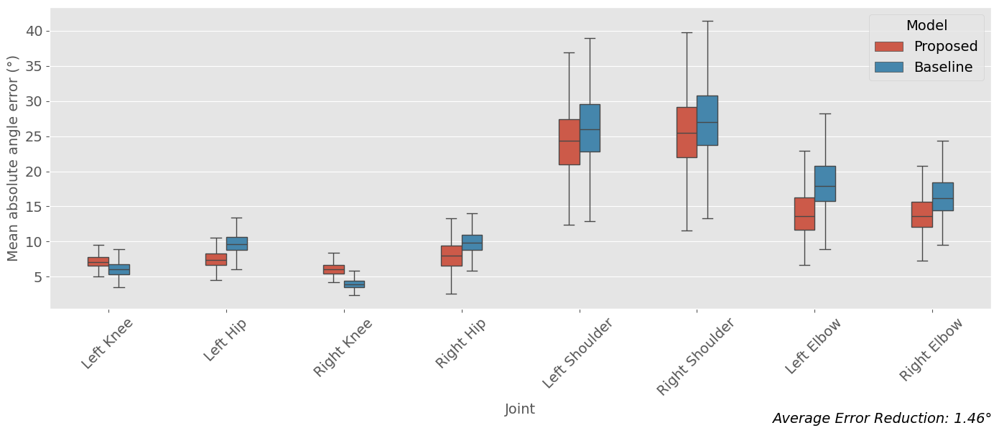

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import files

# 1. Calculate overall errors
overall_baseline = df_baseline_melted['Angle Error'].mean()
overall_proposed = df_proposed_melted['Angle Error'].mean()

# 2. Create "Overall" rows
overall_rows = pd.DataFrame({
    'Joint': ['Overall', 'Overall'],
    'Angle Error': [overall_baseline, overall_proposed],
    'Model': ['Baseline', 'Proposed']
})

# 3. Add to combined DataFrame
df_combined_extended = pd.concat([df_combined, overall_rows], ignore_index=True)

# 4. Plot: Joint-wise boxplot (no outliers, no "Overall")
plt.figure(figsize=(14, 6))
sns.boxplot(
    data=df_combined_extended[df_combined_extended['Joint'] != 'Overall'],
    x='Joint', y='Angle Error', hue='Model',
    dodge=True, width=0.35, showfliers=False
)

plt.xticks(rotation=45, fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel("Joint", fontsize=14)
plt.ylabel("Mean absolute angle error (°)", fontsize=14)
plt.legend(title='Model', fontsize=14, title_fontsize=14)
plt.tight_layout()

# Optional annotation
avg_baseline = df_baseline_melted.groupby('Joint')['Angle Error'].mean()
avg_proposed = df_proposed_melted.groupby('Joint')['Angle Error'].mean()
avg_diff = (avg_baseline - avg_proposed).mean()
plt.figtext(0.99, 0.01, f"Average Error Reduction: {avg_diff:.2f}°", ha='right', fontsize=14, style='italic')

# Save and show
plt.savefig("joint_angle_error_comparison.png", dpi=600)
plt.show()
files.download("joint_angle_error_comparison.png")

In [ ]:
from scipy.stats import ttest_ind

# Convert lists to numpy arrays if not already
import numpy as np
errors_baseline = np.array(all_errors_baseline)
errors_proposed = np.array(all_errors)

# Independent t-test (assuming samples are independent)
stat, p_value = ttest_ind(errors_baseline, errors_proposed, equal_var=False)  # Welch's t-test

print(f"T-statistic: {stat:.4f}")
print(f"P-value: {p_value:.4f}")

if p_value < 0.05:
    print("Statistically significant difference between baseline and proposed model errors.")
else:
    print("No statistically significant difference detected between baseline and proposed errors.")


NameError: name 'all_errors_baseline' is not defined

In [ ]:

 # def processedYYplotter_side_by_side(idx, mask, bbox_i, gt_kp, pred_kp):
#     # Increase figsize to make the plot bigger
#     fig, axes = plt.subplots(1, 2, figsize=(20, 10))  # Adjust this for bigger plots
#     titles = [f'Ground Truth Keypoints (Timestep {idx})', f'Predicted Keypoints (Timestep {idx})']

#     for ax, keypoints, title in zip(axes, [gt_kp, pred_kp], titles):
#         img = np.zeros((256, 128, 3), dtype=np.uint8)

#         for j in range(mask.shape[0]):
#             # Apply mask
#             img[mask[j] == 1] = (0, 255, 0)

#             # Draw bbox
#             x1, y1, x2, y2 = bbox_i[j, :4]
#             width = x2 - x1
#             height = y2 - y1
#             rect = patches.Rectangle((x1, y1), width, height, linewidth=1, edgecolor='r', facecolor='none')
#             ax.add_patch(rect)

#             # Draw keypoints
#             for connection in connections:
#                 x = keypoints[j, connection, 0]
#                 y = keypoints[j, connection, 1]
#                 ax.plot(x, y, color='b', marker='o', markersize=3)

#         ax.imshow(img)
#         ax.set_title(title)
#         ax.axis('off')

#     plt.tight_layout()
#     plt.show()


## Plotting predictions

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def processedYYplotter_side_by_side(idx, gt_kp, pred_kp):
    plt.style.use('ggplot')

    fig, axes = plt.subplots(1, 2, figsize=(12, 8))
    titles = [f'Ground Truth Keypoints)', f'Predicted Keypoints)']

    for ax, keypoints, title in zip(axes, [gt_kp, pred_kp], titles):
        img = np.ones((16, 16, 3), dtype=np.uint8) * 255
        ax.imshow(img)
        ax.set_title(title, fontsize=16, fontweight='bold')
        ax.axis('off')
        ax.grid(True, linestyle='--', alpha=0.3)  # subtle background grid

        for j in range(mask.shape[0]):

            # Draw connections with thicker blue lines
            for connection in connections:
                x = keypoints[j, connection, 0]
                y = keypoints[j, connection, 1]
                # z is unused in plotting but kept for your code's consistency
                # z = keypoints[j, connection, 2]

                ax.plot(x, y, color='blue', linewidth=3, alpha=0.7)  # thick lines

            # Draw keypoints as larger orange circles with black edges
            x_pts = keypoints[j, :, 0]
            y_pts = keypoints[j, :, 1]
            ax.scatter(x_pts, y_pts, color='orange', s=60, edgecolor='black', linewidth=0.8, zorder=5)

    plt.tight_layout()
    plt.show()


In [ ]:
def processedYYplotter_side_by_side(idx, gt_kp, pred_kp, filename="keypoints_plot.png"):
    plt.style.use('ggplot')

    fig, axes = plt.subplots(1, 2, figsize=(10, 6))  # smaller figure size
    titles = [f'Ground Truth Keypoints', f'Predicted Keypoints']

    for ax, keypoints, title in zip(axes, [gt_kp, pred_kp], titles):
        img = np.ones((16, 16, 3), dtype=np.uint8) * 255
        ax.imshow(img)
        ax.set_title(title, fontsize=14, fontweight='bold')  # slightly smaller font
        ax.axis('off')
        ax.grid(True, linestyle='--', alpha=0.3)  # subtle background grid

        for j in range(mask.shape[0]):
            for connection in connections:
                x = keypoints[j, connection, 0]
                y = keypoints[j, connection, 1]
                ax.plot(x, y, color='blue', linewidth=3, alpha=0.7)

            x_pts = keypoints[j, :, 0]
            y_pts = keypoints[j, :, 1]
            ax.scatter(x_pts, y_pts, color='orange', s=50, edgecolor='black', linewidth=0.8, zorder=5)  # smaller points

    plt.tight_layout()
    plt.savefig(filename, dpi=300)
    plt.show()
    # files.download(filename)


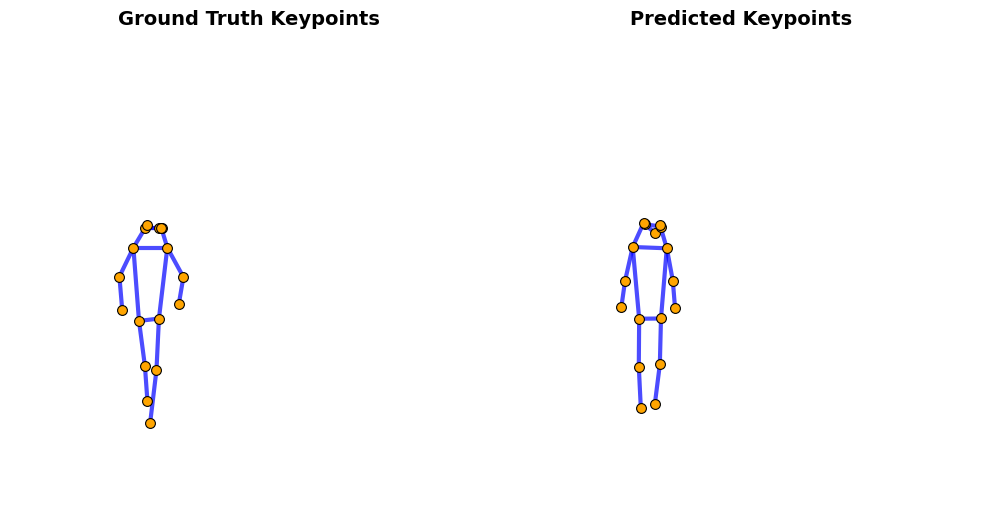

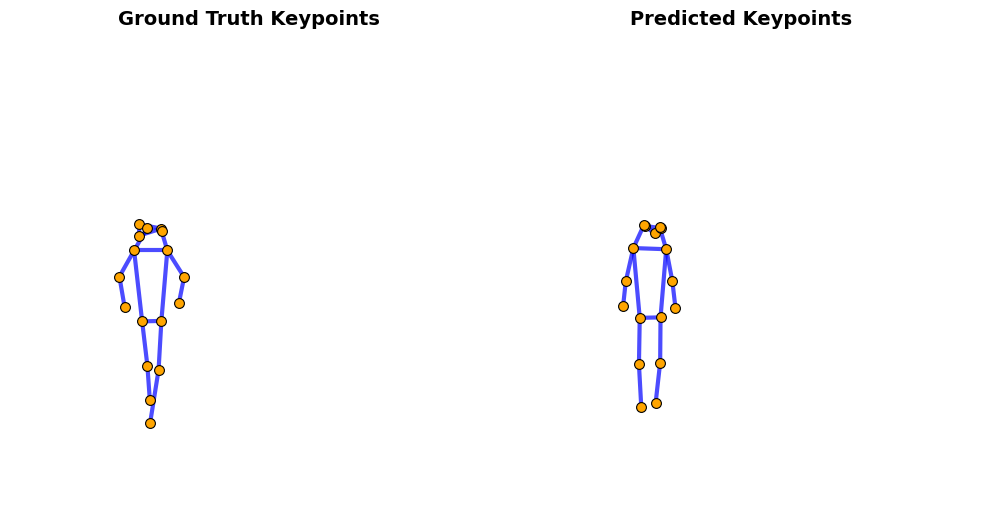

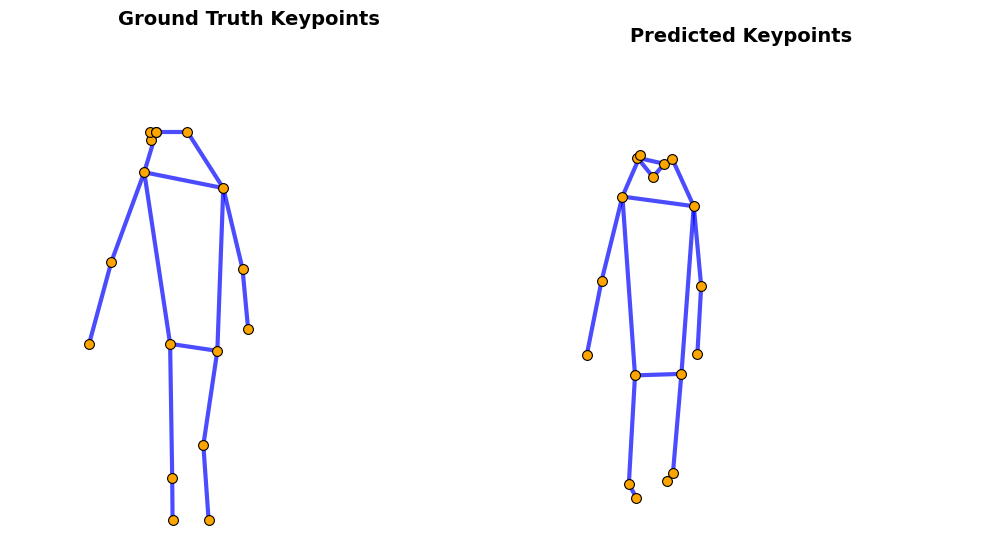

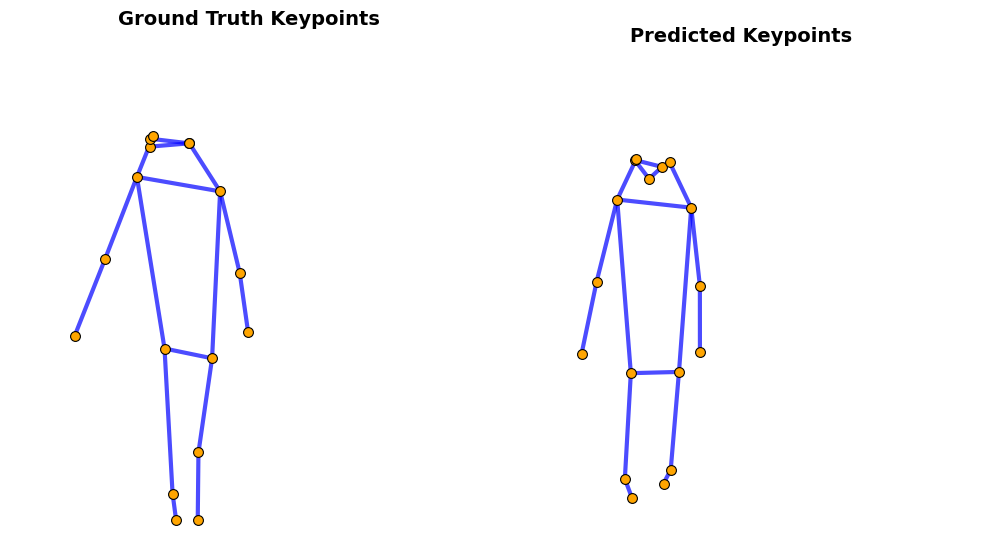

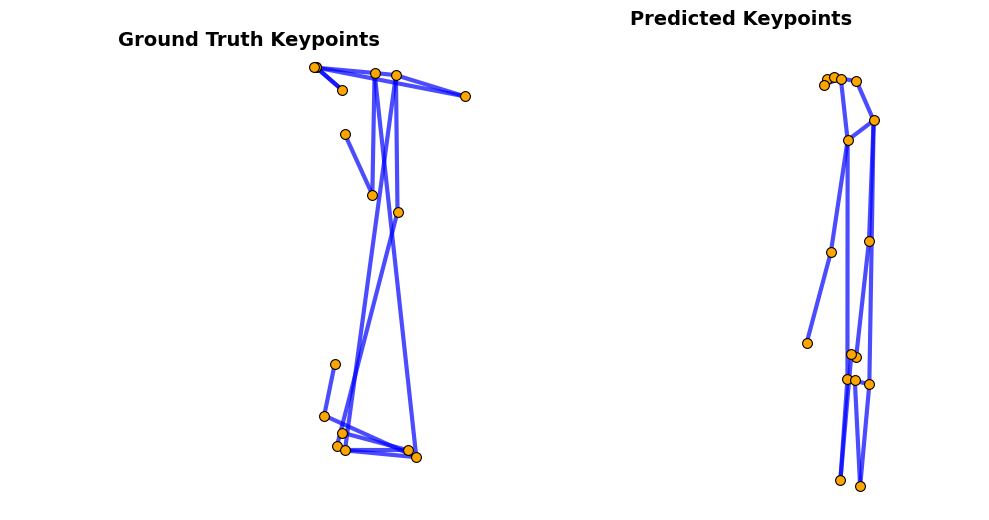

...

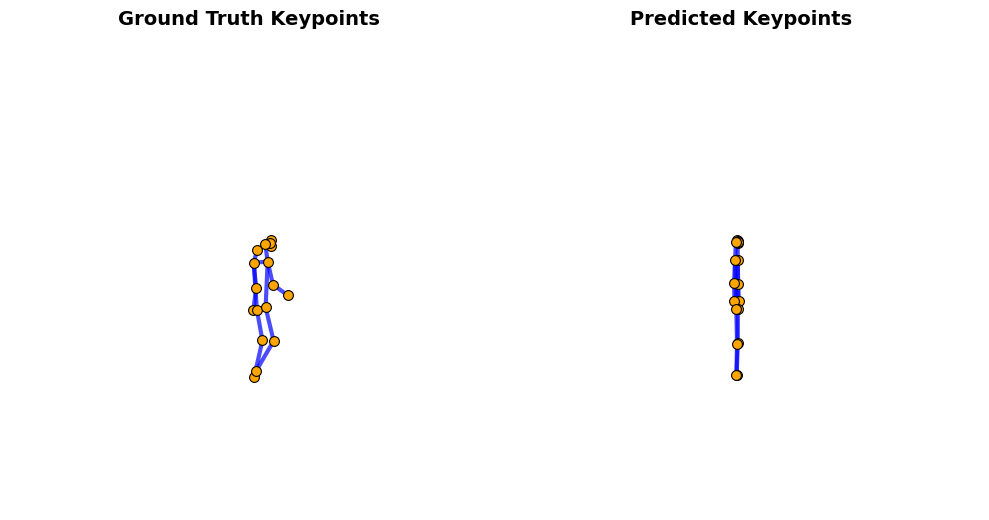

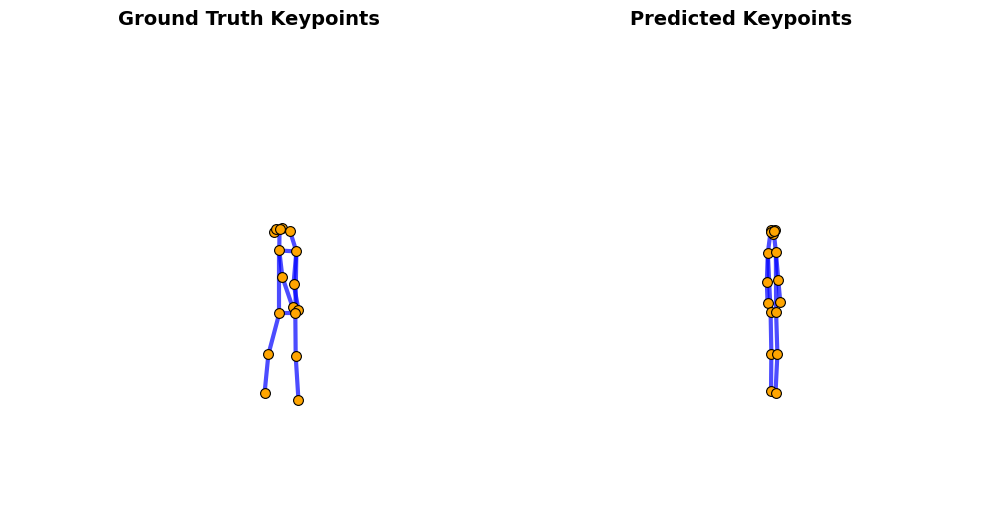

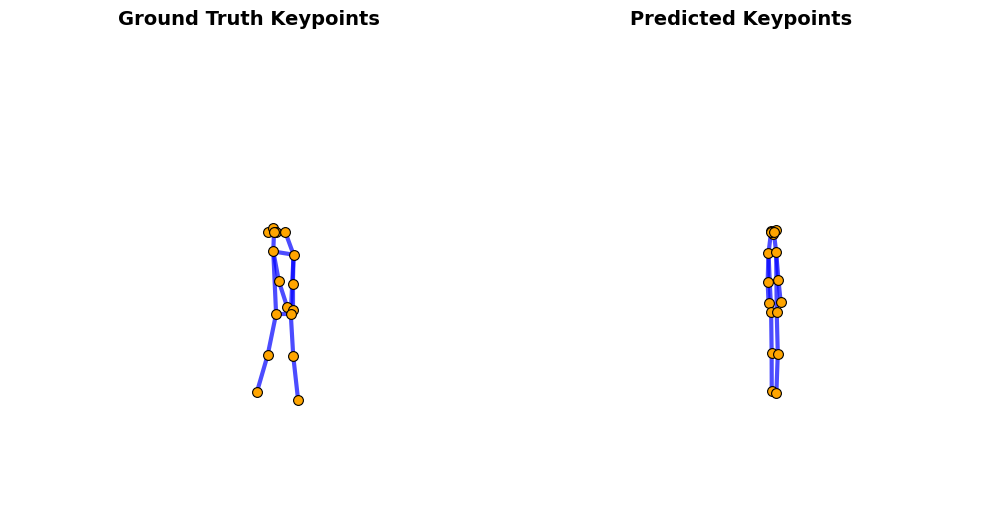

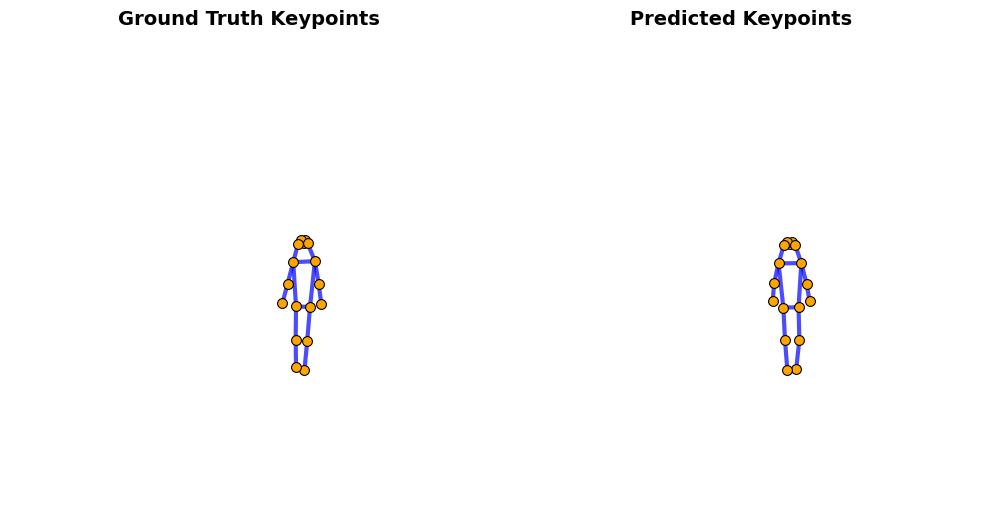

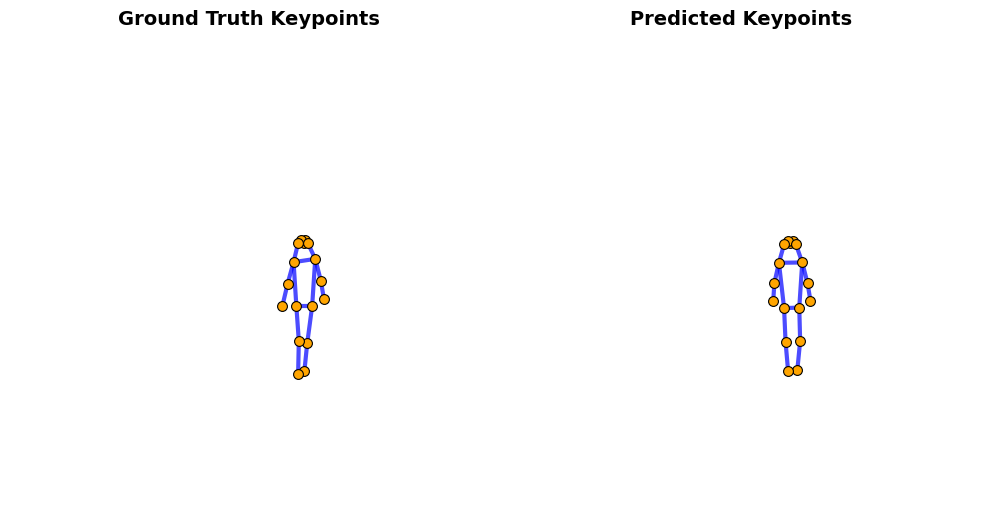

   SampleIndex       Joint                                    Angle_Predicted  \
0          110   Left Knee  [176.7821, 174.41423, 174.1884, 176.66023, 17....   
1          110   Left Knee  [176.7821, 174.41423, 174.1884, 176.66023, 17....   
2          110    Left Hip  [179.55766, 176.95059, 174.88849, 176.59953, 1...   
3          110    Left Hip  [179.55766, 176.95059, 174.88849, 176.59953, 1...   
4          110  Right Knee  [172.63184, 176.10545, 179.04366, 177.85588, 1...   

                                   Angle_GroundTruth  
0  [176.56996, 176.88254, 175.91971, 175.97893, 3...  
1  [162.97359, 154.14633, 110.02121, 177.2235, 5....  
2  [174.46948, 175.00908, 176.9291, 178.62228, 19...  
3  [132.73595, 177.24103, 171.28479, 179.13408, 5...  
4  [158.35234, 176.71884, 169.93962, 179.2184, 13...  


In [ ]:
import torch
import pandas as pd

model.eval()

# Lists to accumulate all data across batches
all_predicted_angles = []
all_groundtruth_angles = []

with torch.no_grad():
    for idx, (hori_sample, vert_sample, gt_kp) in enumerate(test_loader):
        global_index = idx + 110
        if global_index >= 120:
            break

        # Move inputs to device
        hori_sample = hori_sample.to(device)
        vert_sample = vert_sample.to(device)
        gt_kp = gt_kp.to(device)  # keep gt_kp as tensor

        # Predict keypoints
        pred_kp = model(hori_sample, vert_sample)  # output tensor on device

        # Compute angles for predicted and GT keypoints
        jointNamesTarget, angles_true = modelAngle(pred_kp)
        jointNamesPred, angles_pred = modelAngle(gt_kp)
        assert jointNamesTarget == jointNamesPred, "Joint order mismatch!"

        # Collect predicted angles for this batch
        for name, angle in zip(jointNamesTarget, angles_true):
            if hasattr(angle, 'numel') and angle.numel() > 1:
                angle_val = angle.detach().cpu().numpy()
            else:
                angle_val = angle.item() if hasattr(angle, 'item') else angle

            all_predicted_angles.append({
                'SampleIndex': global_index,
                'Joint': jointDict[name],
                'Angle': angle_val
            })

        # Collect ground truth angles for this batch
        for name, angle in zip(jointNamesPred, angles_pred):
            if hasattr(angle, 'numel') and angle.numel() > 1:
                angle_val = angle.detach().cpu().numpy()
            else:
                angle_val = angle.item() if hasattr(angle, 'item') else angle

            all_groundtruth_angles.append({
                'SampleIndex': global_index,
                'Joint': jointDict[name],
                'Angle': angle_val
            })

        # For plotting, convert to CPU NumPy arrays
        gt_kp_np = gt_kp.cpu().numpy()
        pred_kp_np = pred_kp.cpu().numpy()

        for t in range(2):
            gt_kp_t = gt_kp_np[:, t, :, :]
            pred_kp_t = pred_kp_np[:, t, :, :]
            processedYYplotter_side_by_side(f"{global_index}_t{t}", gt_kp_t, pred_kp_t)

# After loop, convert collected angle data into DataFrames
df_predicted = pd.DataFrame(all_predicted_angles)
df_groundtruth = pd.DataFrame(all_groundtruth_angles)

# Optional: merge predicted and ground truth for easier comparison
df_angles = pd.merge(
    df_predicted,
    df_groundtruth,
    on=['SampleIndex', 'Joint'],
    suffixes=('_Predicted', '_GroundTruth')
)

print(df_angles.head())

# Optionally save to CSV for further analysis
df_angles.to_csv('angles_comparison.csv', index=False)


In [ ]:
import numpy as np

frame_id = 110  # Frame you want to show

# Filter the DataFrame for the selected frame
df_frame = df_angles[df_angles['SampleIndex'] == frame_id].copy()

# Safely convert arrays to scalar values
def extract_scalar(x):
    if isinstance(x, np.ndarray):
        return x.flatten()[0]
    return x

df_frame['Angle_Predicted'] = df_frame['Angle_Predicted'].apply(extract_scalar)
df_frame['Angle_GroundTruth'] = df_frame['Angle_GroundTruth'].apply(extract_scalar)

# Normalize angles (180 - angle)
df_frame['Angle_Predicted_Norm'] = 180 - df_frame['Angle_Predicted']
df_frame['Angle_GroundTruth_Norm'] = 180 - df_frame['Angle_GroundTruth']

# Ergonomic risk classification
def ergonomic_risk_level(angle, joint_name):
    if joint_name == "Trunk Flexion":
        if angle > 90: return 4
        elif angle > 60: return 3
        elif angle > 30: return 2
        else: return 1

    elif joint_name == "Trunk Lateral Bend":
        if angle > 45: return 4
        elif angle > 30: return 3
        elif angle > 15: return 2
        else: return 1

    elif joint_name in ["Shoulder Flexion", "Shoulder Abduction"]:
        if angle > 120: return 5
        elif angle > 90: return 4
        elif angle > 60: return 3
        elif angle > 30: return 2
        else: return 1

    elif joint_name == "Elbow Flexion":
        if angle > 90: return 4
        elif angle > 60: return 3
        elif angle > 30: return 2
        else: return 1

    elif joint_name == "Knee Flexion":
        if angle > 90: return 4
        elif angle > 60: return 3
        elif angle > 30: return 2
        else: return 1

    else:
        return 0  # Unknown joint

# Compute ergonomic risks
df_frame['Actual_Risk'] = df_frame.apply(
    lambda r: ergonomic_risk_level(r['Angle_GroundTruth_Norm'], r['Joint']), axis=1
)
df_frame['Predicted_Risk'] = df_frame.apply(
    lambda r: ergonomic_risk_level(r['Angle_Predicted_Norm'], r['Joint']), axis=1
)

# Print results
print(f"\nErgonomic Risk Levels for Frame {frame_id}:\n")
for _, row in df_frame.iterrows():
    print(f"Joint: {row['Joint']}")
    print(f"  Actual Angle (norm): {row['Angle_GroundTruth_Norm']:.2f}°, Risk Level: {row['Actual_Risk']}")
    print(f"  Predicted Angle (norm): {row['Angle_Predicted_Norm']:.2f}°, Risk Level: {row['Predicted_Risk']}")
    print("-----")



Ergonomic Risk Levels for Frame 110:

Joint: Left Knee
  Actual Angle (norm): 3.43°, Risk Level: 0
  Predicted Angle (norm): 3.22°, Risk Level: 0
-----
Joint: Left Knee
  Actual Angle (norm): 17.03°, Risk Level: 0
  Predicted Angle (norm): 3.22°, Risk Level: 0
-----
Joint: Left Hip
  Actual Angle (norm): 5.53°, Risk Level: 0
  Predicted Angle (norm): 0.44°, Risk Level: 0
-----
Joint: Left Hip
  Actual Angle (norm): 47.26°, Risk Level: 0
  Predicted Angle (norm): 0.44°, Risk Level: 0
-----
Joint: Right Knee
  Actual Angle (norm): 21.65°, Risk Level: 0
  Predicted Angle (norm): 7.37°, Risk Level: 0
-----
Joint: Right Knee
  Actual Angle (norm): 7.47°, Risk Level: 0
  Predicted Angle (norm): 7.37°, Risk Level: 0
-----
Joint: Right Hip
  Actual Angle (norm): 4.05°, Risk Level: 0
  Predicted Angle (norm): 9.64°, Risk Level: 0
-----
Joint: Right Hip
  Actual Angle (norm): 7.16°, Risk Level: 0
  Predicted Angle (norm): 9.64°, Risk Level: 0
-----
Joint: Left Shoulder
  Actual Angle (norm): 42

## VIT

In [ ]:
import torch
import torchvision.models as models
import torch.nn as nn
import torch.optim as optim
from torchvision.models import ViT_B_16_Weights




model = models.vit_b_16(weights=ViT_B_16_Weights.IMAGENET1K_V1)

device = torch.device("cude" if torch.cuda.is_available() else "cpu")
model.to(device)
print(model.heads)

RuntimeError: Expected one of cpu, cuda, ipu, xpu, mkldnn, opengl, opencl, ideep, hip, ve, fpga, maia, xla, lazy, vulkan, mps, meta, hpu, mtia, privateuseone device type at start of device string: cude

## Unet

In [ ]:
# import torch
# import torch.nn as nn

# class UNet(nn.Module):
#     def __init__(self, in_channels=2, out_channels=1, init_features=32):
#         super(UNet, self).__init__()

#         features = init_features
#         self.encoder1 = UNet._block(in_channels, features, name="enc1")
#         self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
#         self.encoder2 = UNet._block(features, features * 2, name="enc2")
#         self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
#         self.encoder3 = UNet._block(features * 2, features * 4, name="enc3")
#         self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)
#         self.encoder4 = UNet._block(features * 4, features * 8, name="enc4")
#         self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)

#         self.bottleneck = UNet._block(features * 8, features * 16, name="bottleneck")

#         self.upconv4 = nn.ConvTranspose2d(
#             features * 16, features * 8, kernel_size=2, stride=2
#         )
#         self.decoder4 = UNet._block((features * 8) * 2, features * 8, name="dec4")
#         self.upconv3 = nn.ConvTranspose2d(
#             features * 8, features * 4, kernel_size=2, stride=2
#         )
#         self.decoder3 = UNet._block((features * 4) * 2, features * 4, name="dec3")
#         self.upconv2 = nn.ConvTranspose2d(
#             features * 4, features * 2, kernel_size=2, stride=2
#         )
#         self.decoder2 = UNet._block((features * 2) * 2, features * 2, name="dec2")
#         self.upconv1 = nn.ConvTranspose2d(
#             features * 2, features, kernel_size=2, stride=2
#         )
#         self.decoder1 = UNet._block(features * 2, features, name="dec1")

#         self.conv = nn.Conv2d(
#             in_channels=features, out_channels=out_channels, kernel_size=1
#         )

#     def forward(self, x):
#         enc1 = self.encoder1(x)
#         enc2 = self.encoder2(self.pool1(enc1))
#         enc3 = self.encoder3(self.pool2(enc2))
#         enc4 = self.encoder4(self.pool3(enc3))

#         bottleneck = self.bottleneck(self.pool4(enc4))

#         dec4 = self.upconv4(bottleneck)
#         dec4 = torch.cat((dec4, enc4), dim=1)
#         dec4 = self.decoder4(dec4)

#         dec3 = self.upconv3(dec4)
#         dec3 = torch.cat((dec3, enc3), dim=1)
#         dec3 = self.decoder3(dec3)

#         dec2 = self.upconv2(dec3)
#         dec2 = torch.cat((dec2, enc2), dim=1)
#         dec2 = self.decoder2(dec2)

#         dec1 = self.upconv1(dec2)
#         dec1 = torch.cat((dec1, enc1), dim=1)
#         dec1 = self.decoder1(dec1)

#         return torch.sigmoid(self.conv(dec1))

#     @staticmethod
#     def _block(in_channels, features, name):
#         return nn.Sequential(
#             nn.Conv2d(
#                 in_channels=in_channels,
#                 out_channels=features,
#                 kernel_size=3,
#                 padding=1,
#                 bias=False,
#             ),
#             nn.BatchNorm2d(num_features=features),
#             nn.ReLU(inplace=True),
#             nn.Conv2d(
#                 in_channels=features,
#                 out_channels=features,
#                 kernel_size=3,
#                 padding=1,
#                 bias=False,
#             ),
#             nn.BatchNorm2d(num_features=features),
#             nn.ReLU(inplace=True),
#         )

In [ ]:
# import torch
# import torch.nn as nn
# import torch.optim as optim

# class MaskRegressor(nn.Module):
#     def __init__(self):
#         super(MaskRegressor, self).__init__()

#         # Encoder
#         self.encoder = nn.Sequential(
#             nn.Conv2d(2, 32, kernel_size=3, stride=1, padding=1),
#             nn.ReLU(),
#             nn.MaxPool2d(kernel_size=2, stride=2, padding=0),

#             nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
#             nn.ReLU(),
#             nn.MaxPool2d(kernel_size=2, stride=2, padding=0),

#             nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
#             nn.ReLU(),
#             nn.MaxPool2d(kernel_size=2, stride=2, padding=0)
#         )

#         # Decoder
#         self.decoder = nn.Sequential(
#             nn.ConvTranspose2d(128, 64, kernel_size=3, stride=1, padding=1),
#             nn.ReLU(),
#             nn.Upsample(scale_factor=2, mode='nearest'),

#             nn.ConvTranspose2d(64, 32, kernel_size=3, stride=1, padding=1),
#             nn.ReLU(),
#             nn.Upsample(scale_factor=2, mode='nearest'),

#             nn.ConvTranspose2d(32, 1, kernel_size=3, stride=1, padding=1),
#             nn.Sigmoid(),  # Use Sigmoid to ensure the output is in range [0, 1]
#             nn.Upsample(scale_factor=2, mode='nearest')
#         )

#     def forward(self, x):
#         x = self.encoder(x)
#         x = self.decoder(x)
#         return x


In [ ]:
# import torch
# from torchsummary import summary

# # Set the device (GPU if available, otherwise CPU)
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# # Initialize the model and move it to the correct device
# # model = MaskRegressor().to(device)
# model = MaskRegressor.to(device)
# # Create a sample input tensor and move it to the same device
# input_tensor = torch.randn(1, 2, 256, 128).to(device)  # Batch size of 1, 2 channels

# # Print the summary for the model
# summary(model, input_size=(2, 256, 128))


In [ ]:
## Converting NumPy arrays to PyTorch tensors
XXHoriNorm = torch.from_numpy(XXHoriNorm).to(dtype=torch.float16).unsqueeze(1)  # (N, 1, 256, 128)
XXVertNorm = torch.from_numpy(XXVertNorm).to(dtype=torch.float16).unsqueeze(1)  # (N, 1, 256, 128)

## Converting masks to tensors
YY = torch.stack([torch.from_numpy(mask).to(dtype=torch.float16) for mask in YY['scaledMask']]).unsqueeze(1)  # (N, 1, 256, 128)

## Stacking heatmaps into a 2-channel input
X = torch.cat((XXHoriNorm, XXVertNorm), dim=1)  # Shape: (N, 2, 256, 128)

# Print memory-efficient tensor shapes
print(f"X shape: {X.shape}, dtype: {X.dtype}, memory: {X.element_size() * X.numel() / (1024**2):.2f} MB")
print(f"YY shape: {YY.shape}, dtype: {YY.dtype}, memory: {YY.element_size() * YY.numel() / (1024**2):.2f} MB")


In [ ]:
from torch.utils.data import TensorDataset, random_split

# Create a dataset
dataset = TensorDataset(X, YY)

# Define split sizes (80% train, 20% test)
train_size = int(0.8 * len(dataset))
test_size = len(dataset) - train_size

# Perform the split (random but preserving order)
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])

# Extract train and test tensors
X_train, YY_train = zip(*train_dataset)
X_test, YY_test = zip(*test_dataset)

# Convert back to tensors
X_train = torch.stack(X_train)  # (N_train, 2, 256, 128)
YY_train = torch.stack(YY_train)  # (N_train, 1, 256, 128)

X_test = torch.stack(X_test)  # (N_test, 2, 256, 128)
YY_test = torch.stack(YY_test)  # (N_test, 1, 256, 128)

print(f"Train set: {X_train.shape}, {YY_train.shape}")
print(f"Test set: {X_test.shape}, {YY_test.shape}")


In [ ]:
import torch
print("GPU Available:", torch.cuda.is_available())
print("Device Name:", torch.cuda.get_device_name(0) if torch.cuda.is_available() else "CPU")


In [ ]:
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import torch.nn as nn


## Hyperparameters to be tuned
batch_size = 64
epochs = 22
learning_rate = 1e-5




train_losses = []
test_losses = []


X_train = X_train.squeeze(dim=1).float()  ## removing the dimensions at
X_test = X_test.squeeze(dim=1).float()    ## index 1 to match with train data


# YY_train = YY_train.squeeze(dim=1).float()  ## removing the dimensions at
# YY_test = YY_test.squeeze(dim=1).float()    ## index 1 to match with train data

## Creating DataLoaders for training and testing
train_loader = DataLoader(TensorDataset(X_train, YY_train), batch_size=batch_size, shuffle=True)
test_loader = DataLoader(TensorDataset(X_test, YY_test), batch_size=batch_size, shuffle=False)

## Model
mask_regressor = MaskRegressor()

## Defining optimizer and loss function
optimizer = optim.Adam(mask_regressor.parameters(), lr=learning_rate)
criterion = nn.BCEWithLogitsLoss()


## Moving model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
mask_regressor.to(device)

## Training loop
for epoch in range(epochs):
    mask_regressor.train()
    total_loss = 0

    for X_batch, YY_batch in train_loader:
        X_batch, YY_batch = X_batch.to(device), YY_batch.to(device)

        optimizer.zero_grad()


        predicted_mask = mask_regressor(X_batch)


        loss = criterion(predicted_mask, YY_batch)


        loss.backward()
        optimizer.step()

        total_loss += loss.item()

    avg_train_loss = total_loss / len(train_loader)
    train_losses.append(avg_train_loss)


    mask_regressor.eval()
    with torch.no_grad():
        total_test_loss = 0
        for X_batch, YY_batch in test_loader:
            X_batch, YY_batch = X_batch.to(device), YY_batch.to(device)

            predicted_mask = mask_regressor(X_batch)
            loss = criterion(predicted_mask, YY_batch)
            total_test_loss += loss.item()

    avg_test_loss = total_test_loss / len(test_loader)
    test_losses.append(avg_test_loss)

    print(f"Epoch [{epoch+1}/{epochs}], Train Loss: {avg_train_loss:.4f}, Test Loss: {avg_test_loss:.4f}")


In [ ]:
predicted_mask.shape

In [ ]:
import matplotlib.pyplot as plt

def plotLosses(train_losses, test_losses):
    epochs = range(1, len(train_losses) + 1)
    plt.figure(figsize=(10, 6))
    plt.plot(epochs, train_losses, label='Training Loss', color='blue', marker='o')
    plt.plot(epochs, test_losses, label='Test Loss', color='red', marker='x')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training and Test Loss Over Epochs')
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
plotLosses(train_losses, test_losses)


**RF-Mask**

In [ ]:
'''
 # @ Author: Zhi Wu
 # @ Create Time: 1970-01-01 00:00:00
 # @ Modified by: Zhi Wu
 # @ Modified time: 2022-08-27 13:38:22
 # @ Description: Additional useful definition.
 '''

import numpy as np
import torch
import torch.nn.functional as F
from torchvision.models.detection.transform import GeneralizedRCNNTransform
from torchvision.ops import boxes as box_ops
from torchvision.ops import roi_align
from torchvision.ops.boxes import box_area

from ..datasets import camera_parameter


class RFTransform(GeneralizedRCNNTransform):
    """Data transformation. Normalize input data."""

    def __init__(self, min_size, max_size):
        super(RFTransform, self).__init__(min_size, max_size, [0] * 6, [1] * 6)

    def normalize(self, image):
        if not image.is_floating_point():
            raise TypeError(
                f"Expected input images to be of floating type (in range [0, 1]), "
                f"but found type {image.dtype} instead"
            )
        std, mean = torch.std_mean(image, dim=(1, 2), unbiased=True)
        return (image - mean[:, None, None]) / std[:, None, None]

def box_iou(boxes1, boxes2, eps=1e-7):
    """Calucate ious between two bunch of boxes.

    Args:
        boxes1 (tensor): First bunch of boxes.
        boxes2 (tensor): Second bunch of boxes.
        eps (float, optional): Avoid zero divide. Defaults to 1e-7.

    Returns:
        _type_: _description_
    """
    area1 = box_area(boxes1)
    area2 = box_area(boxes2)

    lt = torch.max(boxes1[:, None, :2], boxes2[:, :2])  # [N,M,2]
    rb = torch.min(boxes1[:, None, 2:], boxes2[:, 2:])  # [N,M,2]
    wh = (rb - lt).clamp(min=0)  # [N,M,2]
    inter = wh[:, :, 0] * wh[:, :, 1]  # [N,M]

    union = area1[:, None] + area2 - inter

    iou = inter / (union + eps)
    return iou, union

def _onnx_paste_mask_in_image(mask, box, im_h, im_w):
    """Copied from torchvision.models.detection.roi_heads"""

    one = torch.ones(1, dtype=torch.int64)
    zero = torch.zeros(1, dtype=torch.int64)

    w = (box[2] - box[0] + one)
    h = (box[3] - box[1] + one)
    w = torch.max(torch.cat((w, one)))
    h = torch.max(torch.cat((h, one)))

    # Set shape to [batchxCxHxW]
    mask = mask.expand((1, 1, mask.size(0), mask.size(1)))

    # Resize mask
    mask = F.interpolate(mask, size=(int(h), int(w)), mode='bilinear', align_corners=False)
    mask = mask[0][0]

    x_0 = torch.max(torch.cat((box[0].unsqueeze(0), zero)))
    x_1 = torch.min(torch.cat((box[2].unsqueeze(0) + one, im_w.unsqueeze(0))))
    y_0 = torch.max(torch.cat((box[1].unsqueeze(0), zero)))
    y_1 = torch.min(torch.cat((box[3].unsqueeze(0) + one, im_h.unsqueeze(0))))

    unpaded_im_mask = mask[(y_0 - box[1]):(y_1 - box[1]),
                           (x_0 - box[0]):(x_1 - box[0])]

    # TODO : replace below with a dynamic padding when support is added in ONNX

    # pad y
    zeros_y0 = torch.zeros(y_0, unpaded_im_mask.size(1))
    zeros_y1 = torch.zeros(im_h - y_1, unpaded_im_mask.size(1))
    concat_0 = torch.cat((zeros_y0,
                          unpaded_im_mask.to(dtype=torch.float32),
                          zeros_y1), 0)[0:im_h, :]
    # pad x
    zeros_x0 = torch.zeros(concat_0.size(0), x_0)
    zeros_x1 = torch.zeros(concat_0.size(0), im_w - x_1)
    im_mask = torch.cat((zeros_x0,
                         concat_0,
                         zeros_x1), 1)[:, :im_w]
    return im_mask

@torch.jit._script_if_tracing
def _onnx_paste_masks_in_image_loop(masks, boxes, im_h, im_w):
    """Copied from torchvision.models.detection.roi_heads"""

    res_append = torch.zeros(0, im_h, im_w)
    for i in range(masks.size(0)):
        mask_res = _onnx_paste_mask_in_image(masks[i][0], boxes[i], im_h, im_w)
        mask_res = mask_res.unsqueeze(0)
        res_append = torch.cat((res_append, mask_res))
    return res_append

def project_3d_to_pixel(points, M, P, D, K):
    """Project 3D points into result image plane.

    Args:
        points (tensor): 3D points obtained in input radar coordinate.
        M (tensor): Camera paramter.
        P (tensor): Camera paramter.
        D (tensor): Camera paramter.
        K (tensor): Camera paramter.

    Returns:
        pts (tensor): Projected 2D points in result image plane.
    """

    pts = torch.ones((1, points.shape[0]), device=points.device)
    pts = torch.cat([points.t(), pts], dim=0)
    cc = torch.mm(M, pts)
    pc = (cc[:2] / cc[2]).t()
    fx, fy, cx, cy, Tx, Ty = P[0,0], P[1,1], P[0,2], P[1,2], P[0,3], P[1,3]
    uv_rect_x, uv_rect_y = pc[:, 0], pc[:, 1]
    xp, yp = (uv_rect_x - cx - Tx) / fx, (uv_rect_y - cy - Ty) / fy
    r2 = xp * xp + yp * yp
    r4 = r2 * r2
    r6 = r4 * r2
    a1 = 2 * xp * yp
    k1, k2, p1, p2, k3 = D
    barrel = 1 + k1 * r2 + k2 * r4 + k3 * r6
    xpp = xp * barrel + p1 * a1 + p2 * (r2 + 2 * (xp * xp))
    ypp = yp * barrel + p1 * (r2 + 2 * (yp * yp)) + p2 * a1
    kfx, kcx, kfy, kcy = K[0, 0], K[0, 2], K[1, 1], K[1, 2]
    u = xpp * kfx + kcx
    v = ypp * kfy + kcy
    pts = torch.stack([u, v], dim=0).t()
    pts = pts / 2
    return pts

def calc_v_props(h_proposals, params, project=True, pad=25):
    """Calculate vertical proposals according to horizontal proposals.

    Args:
        h_proposals (list): Horizontal proposals.
        params (tensor): View (environment) index.
        project (bool, optional): If true, projected results will be returned, else only returns vertical proposals. Defaults to True.
        pad (int, optional): Paddings added into projected boxes. Defaults to 25.

    Returns:
        v_props (list): Vertical proposals.
        proposals (list): Projected results.
    """
    v_props = []
    for prop, param in zip(h_proposals, params):
        param = camera_parameter[f'view{param.int().item():02d}']
        for key, value in param.items():
            param[key] = value
        x_off, y_off, z_off, r_off, z_min, z_max = param['offset']
        v = prop.clone()
        for i in [1, 3]:
            _ = (160 - prop[:, i]) ** 2 + (prop[:, 0]/2 + prop[:, 2]/2 - r_off) ** 2
            v[:, i] = 160 - _ ** 0.5
        v[:, 0] = z_min
        v[:, 2] = z_max
        v_props.append(v)
    if not project:
        return v_props

    proposals = []
    for h, v, param in zip(h_proposals, v_props, params):
        param = camera_parameter[f'view{param.cpu().int().item():02d}']
        for key, value in param.items():
            param[key] = torch.from_numpy(np.array(value)).to(device=h.device, dtype=h.dtype) if isinstance(value, list) else value
        x_off, y_off, z_off, r_off, z_min, z_max = param['offset']
        r_mat = param['r_mat']
        M, P, D, K = param['M'], param['P'], param['D'], param['K']

        if h.numel() == 0:
            proposals.append(torch.zeros((1, 4), device=h.device))
            continue
        co = torch.zeros((h.size(0), 6), device=h.device)

        co[:, [0, 1]] = (h[:, [0, 2]] - x_off) * 0.05
        co[:, [2, 3]] = (y_off - h[:, [1, 3]]) * 0.05
        co[:, [4, 5]] = (z_off - v[:, [0, 2]]) * 0.05

        _ = [0,2,4,0,2,5,0,3,4,0,3,5,1,2,4,1,2,5,1,3,4,1,3,5]
        coor3d = co[:, _]
        coor3d = coor3d.view(-1, 3)
        coor3d = torch.mm(coor3d, r_mat.t())

        # Project 3D points into result image plane.
        coor2d = project_3d_to_pixel(coor3d, M, P, D, K)
        coor2d = coor2d.view(-1, 8, 2)

        xymin = torch.min(coor2d, dim=1)[0] - pad
        xymax = torch.max(coor2d, dim=1)[0] + pad
        coor2d = torch.cat([xymin, xymax], dim=1)
        proposals.append(coor2d)

    return v_props, proposals


def project_masks_on_boxes(gt_masks, boxes, matched_idxs, M):
    """
    Given segmentation masks and the bounding boxes corresponding
    to the location of the masks in the image, this function
    crops and resizes the masks in the position defined by the
    boxes. This prepares the masks for them to be fed to the
    loss computation as the targets.
    """
    matched_idxs = matched_idxs.to(boxes)
    rois = torch.cat([matched_idxs[:, None], boxes], dim=1)
    gt_masks = gt_masks[:, None].to(rois)
    return roi_align(gt_masks, rois, (M, M), 1.0)[:, 0]

def maskrcnn_loss(mask_logits, proposals, gt_masks, gt_labels, mask_matched_idxs):
    """
    Args:
        proposals (list[BoxList])
        mask_logits (Tensor)
        targets (list[BoxList])

    Return:
        mask_loss (Tensor): scalar tensor containing the loss
    """

    discretization_size = mask_logits.shape[-1]
    labels = [gt_label[idxs] for gt_label, idxs in zip(gt_labels, mask_matched_idxs)]
    mask_targets = [
        project_masks_on_boxes(m, p, i, discretization_size) for m, p, i in zip(gt_masks, proposals, mask_matched_idxs)
    ]

    labels = torch.cat(labels, dim=0)
    mask_targets = torch.cat(mask_targets, dim=0)

    # torch.mean (in binary_cross_entropy_with_logits) doesn't
    # accept empty tensors, so handle it separately
    if mask_targets.numel() == 0:
        return mask_logits.sum() * 0

    mask_loss = F.binary_cross_entropy_with_logits(
        mask_logits[torch.arange(labels.shape[0], device=labels.device), labels], mask_targets
    )
    return mask_loss

def iou(mask1, mask2):
    inter = torch.logical_and(mask1, mask2)
    union = torch.logical_or(mask1, mask2)
    return torch.sum(inter.flatten(1), dim=1) / torch.sum(union.flatten(1), dim=1)

In [ ]:
'''
 # @ Author: Zhi Wu
 # @ Create Time: 2022-07-14 20:16:32
 # @ Modified by: Zhi Wu
 # @ Modified time: 2022-07-14 20:17:41
 # @ Description: RF Region proposal network
 '''

from torchvision.models.detection.anchor_utils import AnchorGenerator
from torchvision.models.detection.rpn import (RegionProposalNetwork, RPNHead,
                                              concat_box_prediction_layers)


class RFRPN(RegionProposalNetwork):
    """Region Proposal Network definition which is copied from torchvision."""

    def __init__(self, out_channels=256):
        anchor_sizes = ((8, 16, 32, 64, 128),) * 5
        aspect_ratios = ((0.5, 1.0, 2.0),) * len(anchor_sizes)
        rpn_anchor_generator = AnchorGenerator(anchor_sizes, aspect_ratios)
        rpn_head = RPNHead(out_channels, rpn_anchor_generator.num_anchors_per_location()[0])
        rpn_pre_nms_top_n_train = 1000
        rpn_pre_nms_top_n_test = 500
        rpn_post_nms_top_n_train = 1000
        rpn_post_nms_top_n_test = 500
        rpn_nms_thresh = 0.7
        rpn_fg_iou_thresh = 0.7
        rpn_bg_iou_thresh = 0.3
        rpn_batch_size_per_image = 256
        rpn_positive_fraction = 0.5
        rpn_pre_nms_top_n = dict(training=rpn_pre_nms_top_n_train, testing=rpn_pre_nms_top_n_test)
        rpn_post_nms_top_n = dict(training=rpn_post_nms_top_n_train, testing=rpn_post_nms_top_n_test)
        super(RFRPN, self).__init__(
            rpn_anchor_generator, rpn_head,
            rpn_fg_iou_thresh, rpn_bg_iou_thresh,
            rpn_batch_size_per_image, rpn_positive_fraction,
            rpn_pre_nms_top_n, rpn_post_nms_top_n, rpn_nms_thresh)

    def forward(self, images, features, targets=None):
        # RPN uses all feature maps that are available
        features = list(features.values())
        objectness, pred_bbox_deltas = self.head(features)
        anchors = self.anchor_generator(images, features)

        num_images = len(anchors)
        num_anchors_per_level_shape_tensors = [o[0].shape for o in objectness]
        num_anchors_per_level = [s[0] * s[1] * s[2] for s in num_anchors_per_level_shape_tensors]
        objectness, pred_bbox_deltas = concat_box_prediction_layers(objectness, pred_bbox_deltas)
        # apply pred_bbox_deltas to anchors to obtain the decoded proposals
        # note that we detach the deltas because Faster R-CNN do not backprop through
        # the proposals
        proposals = self.box_coder.decode(pred_bbox_deltas.detach(), anchors)
        proposals = proposals.view(num_images, -1, 4)
        boxes, scores = self.filter_proposals(proposals, objectness, images.image_sizes, num_anchors_per_level)

        losses = {}
        if targets is not None:
            labels, matched_gt_boxes = self.assign_targets_to_anchors(anchors, targets)
            regression_targets = self.box_coder.encode(matched_gt_boxes, anchors)
            loss_objectness, loss_rpn_box_reg = self.compute_loss(
                objectness, pred_bbox_deltas, labels, regression_targets)
            losses = {
                "loss_objectness": loss_objectness,
                "loss_rpn_box_reg": loss_rpn_box_reg,
            }
        return boxes, losses

In [ ]:
'''
 # @ Author: Zhi Wu
 # @ Create Time: 1970-01-01 00:00:00
 # @ Modified by: Zhi Wu
 # @ Modified time: 2022-08-27 13:04:30
 # @ Description: RFMask backbone definition
 '''

from torchvision.models.detection.backbone_utils import BackboneWithFPN, resnet
from torchvision.ops import misc as misc_nn_ops
from torchvision.ops.feature_pyramid_network import LastLevelMaxPool


def resnet_fpn_backbone(
    backbone_name,
    pretrained,
    norm_layer=misc_nn_ops.FrozenBatchNorm2d,
    trainable_layers=3,
    returned_layers=None,
    extra_blocks=None
):
    backbone = resnet.__dict__[backbone_name](
        pretrained=pretrained,
        norm_layer=norm_layer)

    # select layers that wont be frozen
    assert 0 <= trainable_layers <= 5
    layers_to_train = ['layer4', 'layer3', 'layer2', 'layer1', 'conv1'][:trainable_layers]
    if trainable_layers == 5:
        layers_to_train.append('bn1')
    for name, parameter in backbone.named_parameters():
        if all([not name.startswith(layer) for layer in layers_to_train]):
            parameter.requires_grad_(False)

    if extra_blocks is None:
        extra_blocks = LastLevelMaxPool()

    if returned_layers is None:
        returned_layers = [1, 2, 3, 4]
    assert min(returned_layers) > 0 and max(returned_layers) < 5
    return_layers = {f'layer{k}': str(v) for v, k in enumerate(returned_layers)}

    in_channels_stage2 = backbone.inplanes // 8
    in_channels_list = [in_channels_stage2 * 2 ** (i - 1) for i in returned_layers]
    out_channels = 64
    return BackboneWithFPN(backbone, return_layers, in_channels_list, out_channels, extra_blocks=extra_blocks)

In [ ]:
'''
 # @ Author: Zhi Wu
 # @ Create Time: 1970-01-01 00:00:00
 # @ Modified by: Zhi Wu
 # @ Modified time: 2022-08-27 13:13:24
 # @ Description: Branch definition, containing Encoder module.
 '''

from collections import OrderedDict
from turtle import forward

import torch.nn as nn
from torchvision.models.detection.anchor_utils import AnchorGenerator
from torchvision.models.detection.rpn import RegionProposalNetwork, RPNHead

from .backbone import misc_nn_ops, resnet_fpn_backbone
from .rpn import RFRPN
from .utils import RFTransform


class Encoder(nn.Module):
    """Backbone feature extractor. We tried two kinds of backbone structures.
       Eight convolution layers or resnet18. In the end, we choose to use 'resnet18'.
    """

    def __init__(self, in_channels=6, min_size=160, max_size=200):
        """
        Backbone feature constructor.

        Args:
            in_channels (int, optional): Channel number of input data. Defaults to 6.
            backbone (str, optional): Which backbone to use, candidate values are ['convs', 'resnet18']. Defaults to 'resnet'.
            min_size (int, optional): Height of input data. Defaults to 160.
            max_size (int, optional): Width of input data. Defaults to 200.
        """
        nn.Module.__init__(self)
        backbone = 'resnet18'
        self.backbone = backbone
        assert backbone in ['convs', 'resnet18'], \
            f'backbone should be one of ["convs", "resnet18"], but get {backbone} instead.'
        if backbone == 'convs':
            self.conv = nn.Sequential(
                nn.Conv2d(6, 1, kernel_size=1, stride=1, padding=0, padding_mode='replicate', bias=False),
                nn.BatchNorm2d(1),
                nn.LeakyReLU(inplace=True),
                nn.Conv2d(1, 64, kernel_size=5, stride=1, padding=2, padding_mode='replicate', bias=False),
                nn.BatchNorm2d(64),
                nn.LeakyReLU(inplace=True),
                nn.Conv2d(64, 128, kernel_size=5, stride=1, padding=2, padding_mode='replicate', bias=False),
                nn.BatchNorm2d(128),
                nn.LeakyReLU(inplace=True),
                nn.Conv2d(128, 128, kernel_size=5, stride=1, padding=2, padding_mode='replicate', bias=False),
                nn.BatchNorm2d(128),
                nn.LeakyReLU(inplace=True),
                nn.Conv2d(128, 256, kernel_size=5, stride=1, padding=2, padding_mode='replicate', bias=False),
                nn.BatchNorm2d(256),
                nn.LeakyReLU(inplace=True),
                nn.Conv2d(256, 256, kernel_size=5, stride=1, padding=2, padding_mode='replicate', bias=False),
                nn.BatchNorm2d(256),
                nn.LeakyReLU(inplace=True),
                nn.Conv2d(256, 256, kernel_size=5, stride=1, padding=2, padding_mode='replicate', bias=False),
                nn.BatchNorm2d(256),
                nn.LeakyReLU(inplace=True),
                nn.Conv2d(256, 256, kernel_size=5, stride=1, padding=2, padding_mode='replicate', bias=False),
                nn.BatchNorm2d(256),
                nn.LeakyReLU(inplace=True)
            )
            self.out_channels = 256
        elif backbone == 'resnet18':
            self.conv = resnet_fpn_backbone('resnet18', pretrained=False,
                                            trainable_layers=5, norm_layer=nn.BatchNorm2d)
            self.conv.body.conv1 = nn.Conv2d(12, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
            self.out_channels = self.conv.out_channels
        self.transform = RFTransform(min_size, max_size)

    def forward(self, x, target=None):
        # Transform input data according to 'min_size' and 'max_size'
        x, target = self.transform(x, target)
        features = self.conv(x.tensors)
        # Uniform return value format
        if self.backbone == 'convs':
            return OrderedDict([('0', features)]), x, target
        return features, x, target

class Branch(nn.Module):
    """Branch model definition.
       Branch is responsible for extract feature and perform RPN
    """

    def __init__(self, backbone):
        """
        Branch model constructor.

        Args:
            backbone (Encoder): Encoder class instance.
        """
        nn.Module.__init__(self)
        self.backbone = backbone
        self.out_channels = backbone.out_channels
        self.rpn = RFRPN(self.out_channels)

    def forward(self, images, targets=None):
        # Extract features and perform RPN.
        features, images, targets = self.backbone(images, targets)
        proposals, proposal_losses = self.rpn(images, features, targets)
        return features, proposals, proposal_losses, images, targets

In [ ]:
'''
 # @ Author: Zhi Wu
 # @ Create Time: 1970-01-01 00:00:00
 # @ Modified by: Zhi Wu
 # @ Modified time: 2022-08-27 13:16:21
 # @ Description: Predictor definition.
 '''

from collections import OrderedDict

import torch.nn as nn


class RFMaskRCNNPredictor(nn.Sequential):
    def __init__(self, in_channels, dim_reduced, num_classes):
        super(RFMaskRCNNPredictor, self).__init__(OrderedDict([
            ("conv5_mask", nn.ConvTranspose2d(in_channels, dim_reduced, 2, 2, 0)),
            ("relu5", nn.ReLU(inplace=True)),
            ("conv6_mask", nn.ConvTranspose2d(dim_reduced, dim_reduced // 2, 2, 2, 0)),
            ("relu6", nn.ReLU(inplace=True)),
            ("conv7_mask", nn.ConvTranspose2d(dim_reduced // 2, dim_reduced // 4, 2, 2, 0)),
            ("relu7", nn.ReLU(inplace=True)),
            ("mask_fcn_logits", nn.Conv2d(dim_reduced // 4, num_classes, 1, 1, 0)),
        ]))

        for name, param in self.named_parameters():
            if "weight" in name:
                nn.init.kaiming_normal_(param, mode="fan_out", nonlinearity="relu")

In [ ]:
'''
 # @ Author: Zhi Wu
 # @ Create Time: 1970-01-01 00:00:00
 # @ Modified by: Zhi Wu
 # @ Modified time: 2022-08-27 13:39:35
 # @ Description: RFMask main structure definition.
 '''

import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
from torch import Tensor
from torch.jit.annotations import Dict, List, Optional, Tuple
from torchvision.models.detection.roi_heads import expand_boxes, expand_masks

from .branch import Branch, Encoder
from .roi_heads import RFRoIHeads
from .utils import _onnx_paste_masks_in_image_loop


class RFMask(nn.Module):
    """RFMask model definition."""

    def __init__(self, dual=True, fuse='multi-head'):
        """RFMask model constructor.

        Args:
            num_classes (int, optional): Number of categories to classifiy. Defaults to 2.
            dual (bool, optional): Dual-branch version of RFMask or single-branch version of RFMask.
            fuse (str, optional): Choose feature fuse method in dual-branch version of RFMask,
                                        fuse with proposed multi-head attention or simple concatenation.
        """
        nn.Module.__init__(self)
        # Horizontal and vertical branches have the same structure.
        self.hbranch = Branch(Encoder())
        self.vbranch = Branch(Encoder()) if dual else None
        self.num_classes = 2
        self.dual = dual
        self.mask_size = (624, 820) # (1248, 1640)
        self.roi_heads = RFRoIHeads(self.hbranch.out_channels, dual=dual, fuse=fuse)

    def prepare_targets(self, targets, key='hboxes'):
        """Reorganize label structure.

        Args:
            targets (dict): Containing box and silhouette labels.
            key (str, optional): Assign the value of targets[key] to targets['boxes']. Defaults to 'hboxes'.

        Returns:
            dict: Reorganized dict.
        """
        if targets is None:
            return targets
        for target in targets:
            target['boxes'] = target[key]
        return targets

    def paste_mask_in_image(self, mask, box, im_h, im_w):
        # type: (Tensor, Tensor, int, int) -> Tensor
        TO_REMOVE = 1
        w = int(box[2] - box[0] + TO_REMOVE)
        h = int(box[3] - box[1] + TO_REMOVE)
        #w = max(w, 1)
        #h = max(h, 1)
        if w > 2 * im_w or h > 2 * im_h:
            return torch.zeros((im_h, im_w), dtype=mask.dtype, device=mask.device)

        w = max(w, 1) if w < im_w else im_w
        h = max(h, 1) if h < im_h else im_h

        # Set shape to [batchxCxHxW]
        mask = mask.expand((1, 1, -1, -1))

        # Resize mask
        mask = F.interpolate(mask, size=(h, w), mode='bilinear', align_corners=False)
        mask = mask[0][0]

        im_mask = torch.zeros((im_h, im_w), dtype=mask.dtype, device=mask.device)
        x_0 = max(box[0], 0)
        x_1 = min(box[2] + 1, im_w)
        y_0 = max(box[1], 0)
        y_1 = min(box[3] + 1, im_h)
        _ = mask[
            (y_0 - box[1]):(y_1 - box[1]), (x_0 - box[0]):(x_1 - box[0])
        ]
        if im_mask[y_0:y_1, x_0:x_1].numel() == _.numel():
            im_mask[y_0:y_1, x_0:x_1] = _
        return im_mask

    def paste_masks_in_image(self, masks, boxes, img_shape, padding=1):
        # type: (Tensor, Tensor, Tuple[int, int], int) -> Tensor
        masks, scale = expand_masks(masks, padding=padding)
        boxes = expand_boxes(boxes, scale).to(dtype=torch.int64)
        im_h, im_w = img_shape

        if torchvision._is_tracing():
            return _onnx_paste_masks_in_image_loop(masks, boxes,
                                                   torch.scalar_tensor(im_h, dtype=torch.int64),
                                                   torch.scalar_tensor(im_w, dtype=torch.int64))[:, None]
        res = [
            self.paste_mask_in_image(m[0], b, im_h, im_w)
            for m, b in zip(masks, boxes)
        ]
        if len(res) > 0:
            ret = torch.stack(res, dim=0)[:, None]
        else:
            ret = masks.new_empty((0, 1, im_h, im_w))
        return ret

    def forward(self, hor, ver, params, targets=None):
        """Main inference function of RFMask model.

        Args:
            hor (FloatTensor): Horizontal RF frames.
            ver (FloatTensor): Vertical RF frames.
            params (IntTensor): View (Environment) index of each data in a batch which is used to load camera parameters.
            targets (dict, optional): Label dict. Defaults to None.

        Returns:
            result (list[dict]): Containing predicted results. list of {'boxes':boxes, 'labels':labels, 'scores':scores}.
            losses (dict): Losses
        """
        # We use the off-the-shelf RPN model implemented by torchvision official code
        # which could be found in torchvision.models.detection.rpn.
        # RPN in torchvision automatically loads 'boxes' key in label dict as ground-truth.

        targets = self.prepare_targets(targets, 'hboxes')
        h_features, h_proposals, h_prop_losses, hor, h_target = self.hbranch(hor, targets)
        # Pack rpn outputs into tuples and feed them into roi_heads
        h_bundle = (h_features, h_proposals, hor.image_sizes)

        if self.dual:
            targets = self.prepare_targets(targets, 'vboxes')
            v_features, v_proposals, v_prop_losses, ver, v_target = self.vbranch(ver, targets)
            # Pack rpn outputs into tuples and feed them into roi_heads
            v_bundle = (v_features, v_proposals, ver.image_sizes)
        else:
            v_bundle = None

        result, losses = self.roi_heads(h_bundle, v_bundle, params, targets)

        # # Calculate mask results
        # for i, pred in enumerate(result):
        #     masks = pred["masks"]
        #     boxes = pred['boxes']
        #     o_im_s = self.mask_size
        #     masks = self.paste_masks_in_image(masks, boxes, o_im_s)
        #     result[i]["masks"] = masks

        # If targets is passed then loss value will be returned, else losses is None.
        if not targets is None:
            rpn_loss = {}
            rpn_loss['loss_h_obj'] = h_prop_losses['loss_objectness']
            rpn_loss['loss_h_rpn_box'] = h_prop_losses['loss_rpn_box_reg']
            if self.dual:
                rpn_loss['loss_v_obj'] = v_prop_losses['loss_objectness']
                rpn_loss['loss_v_rpn_box'] = v_prop_losses['loss_rpn_box_reg']
            losses.update(rpn_loss)

            return result, losses
        else:
            for i, pred in enumerate(result):
                masks = pred["masks"]
                boxes = pred['boxes']
                o_im_s = self.mask_size
                masks = self.paste_masks_in_image(masks, boxes, o_im_s)
                result[i]["masks"] = masks
            return result, losses

In [ ]:
'''
 # @ Author: Zhi Wu
 # @ Create Time: 1970-01-01 00:00:00
 # @ Modified by: Zhi Wu
 # @ Modified time: 2022-11-23 08:50:51
 # @ Description: RoIHeads module definition.
 '''

import torch
import torch.nn as nn
from torch import Tensor
from torch.jit.annotations import Dict, List, Optional, Tuple
from torchvision.models.detection.faster_rcnn import (FastRCNNPredictor,
                                                      TwoMLPHead)
from torchvision.models.detection.mask_rcnn import MaskRCNNHeads
# from torchvision.models.detection.roi_heads import maskrcnn_loss, maskrcnn_inference
from torchvision.models.detection.roi_heads import (RoIHeads, fastrcnn_loss,
                                                    maskrcnn_inference)
from torchvision.ops import MultiScaleRoIAlign

from .predictor import RFMaskRCNNPredictor
from .utils import calc_v_props, maskrcnn_loss


class RFRoIHeads(RoIHeads):
    """RFRoIHeads is the core part of RFMask, it is responsible for regressing 2D detection
       results, calculating 3D bounding boxes, cropping roi features, fuse features and
       generate final results.

       RFRoIHeads is inherited from RoIHeads implemented by torchvision. Original codes can
       be found in torchvision.models.detection.roi_heads
    """
    def __init__(self, out_channels=256, dual=True, fuse='multi-head'):
        """RFRoIHeads constructor.

        Args:
            out_channels (int, optional): Feature channels outputed by Branch. Defaults to 256.
            fuse (str, optional): Feature fusion method, candicate method are ['multi-head0, 'cat'']. Defaults to multi-head fusion.
        """
        # Box regression parameters
        box_fg_iou_thresh, box_bg_iou_thresh = 0.5, 0.5
        box_batch_size_per_image, box_positive_fraction = 512, 0.25
        bbox_reg_weights = None
        box_score_thresh, box_nms_thresh, box_detections_per_img = 0.05, 0., 100

        # Build roiheads
        box_roi_pool = MultiScaleRoIAlign(
            featmap_names=['0'], output_size=14, sampling_ratio=2)
        box_head = TwoMLPHead(
            out_channels * box_roi_pool.output_size[0] ** 2, 1024)
        self.num_cls = 2
        box_predictor = FastRCNNPredictor(1024, self.num_cls)
        super(RFRoIHeads, self).__init__(
            box_roi_pool, box_head, box_predictor,
            box_fg_iou_thresh, box_bg_iou_thresh,
            box_batch_size_per_image, box_positive_fraction,
            bbox_reg_weights,
            box_score_thresh, box_nms_thresh, box_detections_per_img
        )

        self.vbox_head = TwoMLPHead(
            out_channels * box_roi_pool.output_size[0] ** 2, 1024)
        self.vbox_predictor = FastRCNNPredictor(1024, self.num_cls)
        self.compress = nn.Sequential(
            nn.Flatten(),
            nn.Linear(2 * 14 * 14, 2000),
            nn.LeakyReLU(inplace=True),
            nn.Linear(2000, 14 * 14),
        )
        self.mask_roi_pool = MultiScaleRoIAlign(
                featmap_names=['0'], output_size=14, sampling_ratio=2)

        # initialize fuse method
        assert fuse in ['multi-head', 'cat'], f'candidate fusion methods are ["multi-head", "cat"], but got {fuse}.'
        head_in_feature = 1 if dual else 64
        if dual and fuse == 'multi-head':
            head_in_feature = 1
            self.fuse = self.multi_head_fusion
        elif dual and fuse == 'cat':
            head_in_feature = 128
            self.fuse = self.concatenate_fusion
        else:
            head_in_feature = 64

        self.mask_head = MaskRCNNHeads(head_in_feature, (64,), 1)
        self.mask_predictor = RFMaskRCNNPredictor(64, 32, self.num_cls)
        # self.mask_size = (624, 820)

        self.trans = self.trans_enc(d_model=64*14, num_layers=3)
        self.multi_head = nn.MultiheadAttention(64*14, 8)

    def trans_enc(self, d_model, nheads=8, num_layers=2):
        """Build transformer encoder.

        Args:
            d_model (int): Set 'd_model' of transformer.
            nheads (int, optional): Number of transformer heads. Defaults to 8.
            num_layers (int, optional): Number of layers. Defaults to 2.

        Returns:
            dec (nn.Module): TransformerEncoder object.
        """
        encoder_layer = nn.TransformerEncoderLayer(d_model=d_model, nhead=nheads)
        enc = nn.TransformerEncoder(encoder_layer, num_layers=num_layers)
        return enc

    def trans_dec(self, d_model, nheads=8, num_layers=2):
        """Build transformer decoder.

        Args:
            d_model (int): Set 'd_model' of transformer.
            nheads (int, optional): Number of transformer heads. Defaults to 8.
            num_layers (int, optional): Number of layers. Defaults to 2.

        Returns:
            dec (nn.Module): TransformerDecoder object.
        """
        decoder_layer = nn.TransformerDecoderLayer(d_model=d_model, nhead=nheads)
        dec = nn.TransformerDecoder(decoder_layer, num_layers=num_layers)
        return dec

    def select_training_samples(self,
                                proposals,  # type: List[Tensor]
                                targets,     # type: Optional[List[Dict[str, Tensor]]]
                                key='boxes'
                                ):
        # type: (...) -> Tuple[List[Tensor], List[Tensor], List[Tensor], List[Tensor]]
        """This function is copied from torchvision.models.detection.roi_heads.

        Args:
            proposals (list): Proposals generated by RPN.
            targets (dict): Ground-truth labels.
            key (str): Indicating which key in targets contains ground-truth boxes.

        Returns:
            proposals (list): Selected proposals.
            matched_idxs (list): Indexes of selected proposals.
            labels (list): Labels of each selected input (with in a batch).
            regression_targets (tensor): Encoded box results for regressing.
            sampled_inds (list): Remove ignored samples indexes, retain positive/negtive samples indexes.
        """
        self.check_targets(targets)
        assert targets is not None
        dtype = proposals[0].dtype
        device = proposals[0].device

        gt_boxes = [t[key].to(dtype) for t in targets]
        gt_labels = [t["labels"] for t in targets]

        # append ground-truth bboxes to propos
        proposals = self.add_gt_proposals(proposals, gt_boxes)

        # get matching gt indices for each proposal
        matched_idxs, labels = self.assign_targets_to_proposals(proposals, gt_boxes, gt_labels)
        # sample a fixed proportion of positive-negative proposals
        sampled_inds = self.subsample(labels)
        matched_gt_boxes = []
        num_images = len(proposals)
        for img_id in range(num_images):
            img_sampled_inds = sampled_inds[img_id]
            proposals[img_id] = proposals[img_id][img_sampled_inds]
            labels[img_id] = labels[img_id][img_sampled_inds]
            matched_idxs[img_id] = matched_idxs[img_id][img_sampled_inds]

            gt_boxes_in_image = gt_boxes[img_id]
            if gt_boxes_in_image.numel() == 0:
                gt_boxes_in_image = torch.zeros((1, 4), dtype=dtype, device=device)
            matched_gt_boxes.append(gt_boxes_in_image[matched_idxs[img_id]])

        regression_targets = self.box_coder.encode(matched_gt_boxes, proposals)
        return proposals, matched_idxs, labels, regression_targets, sampled_inds

    def concatenate_fusion(self, h_feats, v_feats, pool_size=14):
        """Fuse feature by MLP.

        Args:
            h_feats (tensor): Horizontal roi features.
            v_feats (tensor): Vertical roi features.
            pool_size (int, optional): Pooled shape. Defaults to 14.
        """
        feats =  torch.cat([h_feats, v_feats], axis=-3)
        return feats
        b, c = h_feats.size()[:2]
        feats = torch.stack([h_feats, v_feats], dim=-3)
        feats = feats.view(-1, *feats.size()[-3:])
        feats = self.compress(feats)
        feats = feats.view(b, c, pool_size, pool_size)
        return feats

    def multi_head_fusion(self, h_feats, v_feats, pool_size=14):
        """Multi-Head fusion module.

        Args:
            h_feats (tensor): Horizontal RoI features. Shape [proposal_num, 64, 14, 14]
            v_feats (tensor): Vertical RoI features. Shape [proposal_num, 64, 14, 14]
            pool_size (int, optional): Pooled shape. Defaults to 14.

        Returns:
            att_weights (tensor): Attention weights calculcated by transformer.
        """
        n, c, h, w = h_feats.shape
        feats = torch.cat([h_feats, v_feats], dim=-1).view(n, c * h, 2 * w)
        feats = feats.permute(2, 0, 1)
        feats = self.trans(feats)
        att_output, att_weights = self.multi_head(feats, feats, feats)

        att_weights = att_weights[:, w:, :w].unsqueeze(1)
        return att_weights

    def box_reg(self, bundle, targets, key='hboxes'):
        """Regress target boundingboxes in each branch.

        Args:
            bundle (tuple): Containing features, proposals and original input shape.
            targets (dict): Label dict.
            key (str, optional): Indicating which key in targets stores boundingbox ground-truth. Defaults to 'hboxes'.

        Returns:
            result (list[dict]): Containing predicted results. list of {'boxes':boxes, 'labels':labels, 'scores':scores}.
            losses (ditc): Losses.
            props (list): RPN proposals.
            matched_idxs (list): Selected proposals.
            labels (list): Selected proposal indexes.
        """
        feats, props, img_sizes = bundle
        assert key in ['hboxes', 'vboxes']
        if key == 'hboxes':
            box_head, box_predictor = self.box_head, self.box_predictor
        elif key == 'vboxes':
            box_head, box_predictor = self.vbox_head, self.vbox_predictor

        if not targets is None:
            _ = self.select_training_samples(props, targets, key)
            props, matched_idxs, labels, regression_targets, sampled_inds = _
        else:
            labels = None
            regression_targets = None
            matched_idxs = None

        box_feats = self.box_roi_pool(feats, props, img_sizes)
        box_feats = box_head(box_feats)
        class_logits, box_regression = box_predictor(box_feats)

        result = torch.jit.annotate(List[Dict[str, torch.Tensor]], [])
        losses = {}

        if not targets is None:
            assert regression_targets is not None
            loss_classifier, loss_box_reg = fastrcnn_loss(
                class_logits, box_regression, labels, regression_targets)
            losses = {
                "loss_classifier_"+key[0]: loss_classifier,
                "loss_box_reg_"+key[0]: loss_box_reg
            }
        else:
            boxes, scores, labels = self.postprocess_detections(class_logits, box_regression, props, img_sizes)
            num_images = len(boxes)
            for i in range(num_images):
                result.append(
                    {
                        "boxes": boxes[i],
                        "labels": labels[i],
                        "scores": scores[i],
                    }
                )
        return result, losses, props, matched_idxs, labels

    def forward(self, h_bundle, v_bundle, params, targets=None):
        """Main forward function of RFRoIHeads

        Args:
            h_bundle (tuple): Horizontal features, proposals and original input shape.
            v_bundle (tuple): Vertical features, proposals and original input shape.
            params (tensor): Indicating which view (environment) current data belongs to.
            targets (dict, optional): Labels dict. Defaults to None.

        Returns:
            result (list[dict]): Containing predicted results. list of {'boxes':boxes, 'labels':labels, 'scores':scores}.
            losses (dict): Losses.
        """
        dual = not v_bundle is None

        # Unpack branch outputs.
        h_feats, h_props, h_img_sizes = h_bundle
        if dual:
            v_feats, v_props, v_img_sizes = v_bundle

        # Perform backbone on each horizontal/vertical input data, respectively.
        h_ = self.box_reg(h_bundle, targets, key='hboxes')
        result, losses, h_props, matched_idxs, labels = h_
        if dual:
            v_ = self.box_reg(v_bundle, targets, key='vboxes')
            v_losses = v_[1]

        # Prepare positive boxes
        h_preds = [p["boxes"] for p in result]
        if not targets is None:
            assert matched_idxs is not None
            # during training, only focus on positive boxes
            num_images = len(h_props)
            h_preds = []
            pos_matched_idxs = []
            for img_id in range(num_images):
                pos = torch.nonzero(labels[img_id] > 0).squeeze(1)
                h_preds.append(h_props[img_id][pos])
                pos_matched_idxs.append(matched_idxs[img_id][pos])
        else:
            pos_matched_idxs = None

        # import matplotlib.pyplot as plt
        # from matplotlib.patches import Rectangle
        # import numpy as np

        # Calculate vertical boxes according to horizontal boxes,
        # meanwhile undo offset and combine box-pairs into 3D bounding boxes.
        # Project 3D bounding boxes into result image plane
        v_preds, m_props = calc_v_props(h_preds, params)

        # Deal with nan brought by float16
        # for i in range(len(m_props)):
        #     selected = m_props[i].sum(dim=1).isnan()
        #     m_props[i][selected] = torch.tensor([0, 0, 10, 10], dtype=m_props[i].dtype, device=m_props[i].device)
        #     selected = ~m_props[i].sum(dim=1).isnan()
        #     if pos_matched_idxs[i].numel() != 0:
        #         pos_matched_idxs[i] = pos_matched_idxs[i][selected]
        #         m_props[i] = m_props[i][selected]
        #         h_preds[i] = h_preds[i][selected]
        #         v_preds[i] = v_preds[i][selected]
        #         result[i]["labels"] = result[i]["labels"][selected]
        #     else:
        #         pos_matched_idxs[i]
        #         m_props[i] = torch.zeros((0, 4), device=h_feats['0'].device)

        for i, res in enumerate(result):
            res['boxes'] = m_props[i]

        # Crop roi features

        hm_feats = self.mask_roi_pool(h_feats, h_preds, h_img_sizes) # (N, 64, 14, 14)
        if dual:
            vm_feats = self.mask_roi_pool(v_feats, v_preds, v_img_sizes) # (N, 64, 14, 14)

            # Fuse feature by our proposed Multi-Head Fusion module
            mask_features = self.fuse(hm_feats, vm_feats)
        else:
            mask_features = hm_feats

        # Generate silhouette results.
        mask_features = self.mask_head(mask_features)
        mask_logits = self.mask_predictor(mask_features)

        loss_mask = {}
        if not targets is None:
            assert targets is not None
            assert pos_matched_idxs is not None
            assert mask_logits is not None

            gt_masks = [t["masks"] for t in targets]
            gt_labels = [t["labels"] for t in targets]

            rcnn_loss_mask = maskrcnn_loss(
                mask_logits, m_props,
                gt_masks, gt_labels, pos_matched_idxs)
            loss_mask = {
                "loss_mask": rcnn_loss_mask
            }
        else:
            labels = [r["labels"] for r in result]
            masks_probs = maskrcnn_inference(mask_logits, labels)
            for mask_prob, r in zip(masks_probs, result):
                r["masks"] = mask_prob

        if dual:
            losses.update(v_losses)
        losses.update(loss_mask)
        return result, losses

*italicized text*## MRI dataset

In [ ]:
!wget -O mri.zip 'https://datadryad.org/downloads/file_stream/2738858' --header="User-Agent: Mozilla/5.0"


--2025-03-27 03:11:21--  https://datadryad.org/downloads/file_stream/2738858
Resolving datadryad.org (datadryad.org)... 35.83.108.188, 52.89.160.49, 44.236.5.23, ...
Connecting to datadryad.org (datadryad.org)|35.83.108.188|:443... connected.
HTTP request sent, awaiting response... 403 Forbidden
2025-03-27 03:11:22 ERROR 403: Forbidden.

